# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [20]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [21]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [22]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [23]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

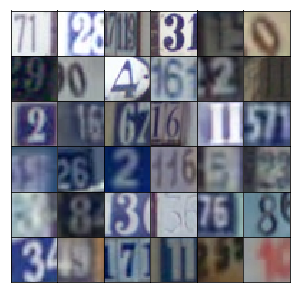

In [24]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [25]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [26]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [27]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [28]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha*x1, x1)
        # Now 4x4x1024
        
        # CONV1
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        # Now 8x8x512
        
        # CONV2
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        # Now 16x16x256
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [29]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha*x1, x1)
        # Now 16x16x64
        
        # CONV1
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha*x2, x2)
        # Now 8x8x128
        
        # CONV2
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha*x3, x3)
        # Now 4x4x256
        
        # Flatten
        x4 = tf.reshape(x3, (-1, 4*4*256))
        
        logits = tf.layers.dense(x4, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [30]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [31]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined above to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [32]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [33]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [34]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [35]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1664... Generator Loss: 0.9072
Epoch 1/25... Discriminator Loss: 0.4128... Generator Loss: 2.5144
Epoch 1/25... Discriminator Loss: 0.1408... Generator Loss: 2.8256
Epoch 1/25... Discriminator Loss: 0.1417... Generator Loss: 3.0600
Epoch 1/25... Discriminator Loss: 0.1526... Generator Loss: 2.7669
Epoch 1/25... Discriminator Loss: 0.1067... Generator Loss: 3.1693
Epoch 1/25... Discriminator Loss: 0.0818... Generator Loss: 3.3361
Epoch 1/25... Discriminator Loss: 0.1401... Generator Loss: 2.8314
Epoch 1/25... Discriminator Loss: 0.1657... Generator Loss: 2.6590
Epoch 1/25... Discriminator Loss: 0.2437... Generator Loss: 2.1798


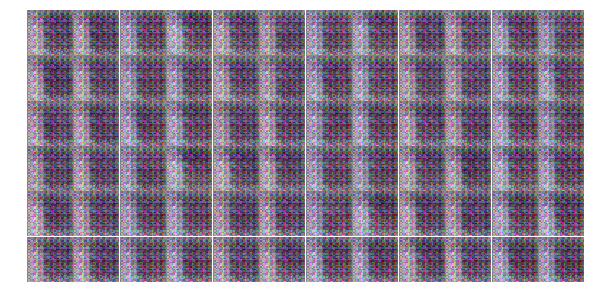

Epoch 1/25... Discriminator Loss: 0.0985... Generator Loss: 3.3798
Epoch 1/25... Discriminator Loss: 0.2495... Generator Loss: 2.0536
Epoch 1/25... Discriminator Loss: 0.4797... Generator Loss: 3.7303
Epoch 1/25... Discriminator Loss: 0.6544... Generator Loss: 2.0703
Epoch 1/25... Discriminator Loss: 1.1170... Generator Loss: 0.5266
Epoch 1/25... Discriminator Loss: 0.6132... Generator Loss: 1.4559
Epoch 1/25... Discriminator Loss: 0.4652... Generator Loss: 1.5325
Epoch 1/25... Discriminator Loss: 0.4671... Generator Loss: 2.1958
Epoch 1/25... Discriminator Loss: 0.8486... Generator Loss: 0.9086
Epoch 1/25... Discriminator Loss: 0.2755... Generator Loss: 3.3856


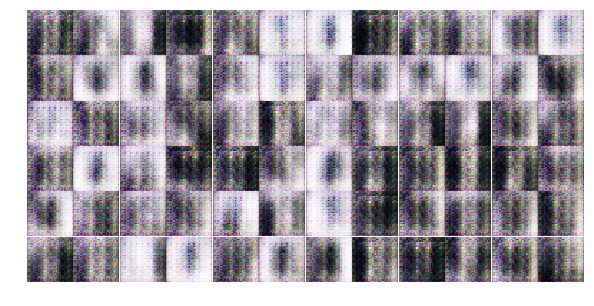

Epoch 1/25... Discriminator Loss: 0.4827... Generator Loss: 1.2772
Epoch 1/25... Discriminator Loss: 0.3526... Generator Loss: 2.3360
Epoch 1/25... Discriminator Loss: 0.5165... Generator Loss: 1.5113
Epoch 1/25... Discriminator Loss: 0.3085... Generator Loss: 1.6121
Epoch 1/25... Discriminator Loss: 0.2942... Generator Loss: 3.1567
Epoch 1/25... Discriminator Loss: 1.2253... Generator Loss: 1.4516
Epoch 1/25... Discriminator Loss: 0.9513... Generator Loss: 1.4070
Epoch 1/25... Discriminator Loss: 0.8242... Generator Loss: 1.2518
Epoch 1/25... Discriminator Loss: 0.4960... Generator Loss: 1.8705
Epoch 1/25... Discriminator Loss: 0.7120... Generator Loss: 1.3492


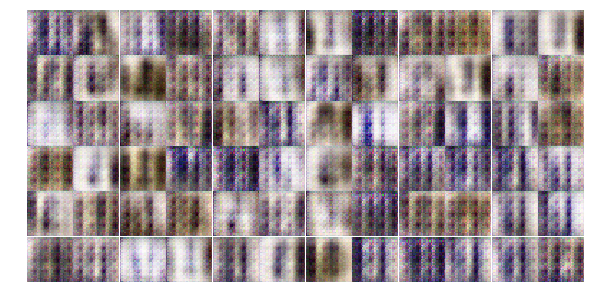

Epoch 1/25... Discriminator Loss: 0.8152... Generator Loss: 1.1188
Epoch 1/25... Discriminator Loss: 0.8969... Generator Loss: 0.7702
Epoch 1/25... Discriminator Loss: 0.9988... Generator Loss: 2.8443
Epoch 1/25... Discriminator Loss: 0.6141... Generator Loss: 2.4794
Epoch 1/25... Discriminator Loss: 0.2442... Generator Loss: 2.9422
Epoch 1/25... Discriminator Loss: 0.7323... Generator Loss: 1.0366
Epoch 1/25... Discriminator Loss: 1.2589... Generator Loss: 0.5263
Epoch 1/25... Discriminator Loss: 0.5466... Generator Loss: 2.6190
Epoch 1/25... Discriminator Loss: 0.8020... Generator Loss: 2.8579
Epoch 1/25... Discriminator Loss: 0.3097... Generator Loss: 2.0710


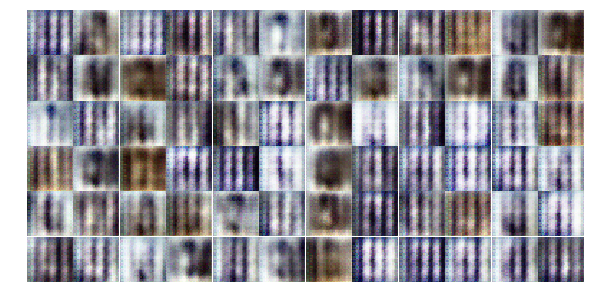

Epoch 1/25... Discriminator Loss: 0.5132... Generator Loss: 1.9898
Epoch 1/25... Discriminator Loss: 1.7600... Generator Loss: 0.5069
Epoch 1/25... Discriminator Loss: 0.4425... Generator Loss: 1.7468
Epoch 1/25... Discriminator Loss: 0.3928... Generator Loss: 2.2244
Epoch 1/25... Discriminator Loss: 0.5912... Generator Loss: 1.6627
Epoch 1/25... Discriminator Loss: 0.4009... Generator Loss: 1.7043
Epoch 1/25... Discriminator Loss: 0.7301... Generator Loss: 1.1897
Epoch 1/25... Discriminator Loss: 1.1265... Generator Loss: 1.2313
Epoch 1/25... Discriminator Loss: 0.6593... Generator Loss: 1.8199
Epoch 1/25... Discriminator Loss: 0.7375... Generator Loss: 1.5212


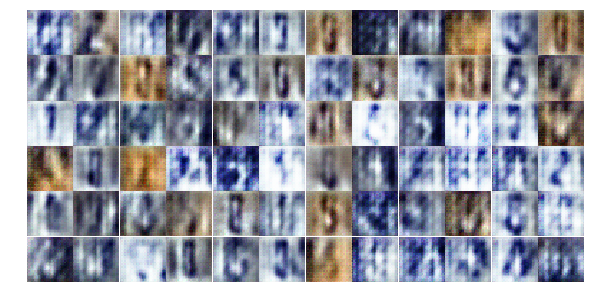

Epoch 1/25... Discriminator Loss: 1.1045... Generator Loss: 1.2395
Epoch 1/25... Discriminator Loss: 0.9135... Generator Loss: 1.1095
Epoch 1/25... Discriminator Loss: 0.6317... Generator Loss: 1.5703
Epoch 1/25... Discriminator Loss: 0.9013... Generator Loss: 1.0071
Epoch 1/25... Discriminator Loss: 0.9317... Generator Loss: 1.0068
Epoch 1/25... Discriminator Loss: 0.6502... Generator Loss: 1.4770
Epoch 1/25... Discriminator Loss: 0.7823... Generator Loss: 1.6689
Epoch 2/25... Discriminator Loss: 1.0676... Generator Loss: 1.3127
Epoch 2/25... Discriminator Loss: 0.8017... Generator Loss: 1.4071
Epoch 2/25... Discriminator Loss: 0.7181... Generator Loss: 1.2320


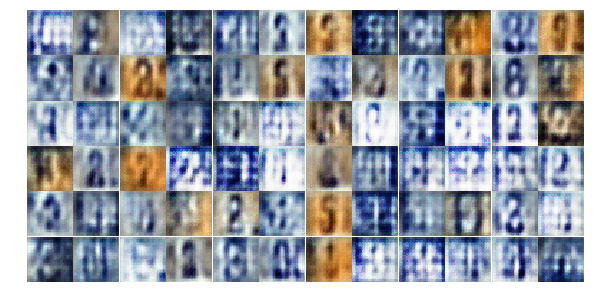

Epoch 2/25... Discriminator Loss: 1.1528... Generator Loss: 0.6435
Epoch 2/25... Discriminator Loss: 0.9098... Generator Loss: 1.5843
Epoch 2/25... Discriminator Loss: 1.0031... Generator Loss: 0.7641
Epoch 2/25... Discriminator Loss: 0.9493... Generator Loss: 1.1763
Epoch 2/25... Discriminator Loss: 0.8320... Generator Loss: 1.1750
Epoch 2/25... Discriminator Loss: 1.1612... Generator Loss: 0.6350
Epoch 2/25... Discriminator Loss: 1.0281... Generator Loss: 1.2188
Epoch 2/25... Discriminator Loss: 0.6326... Generator Loss: 1.3061
Epoch 2/25... Discriminator Loss: 0.6121... Generator Loss: 1.5623
Epoch 2/25... Discriminator Loss: 0.9254... Generator Loss: 0.9945


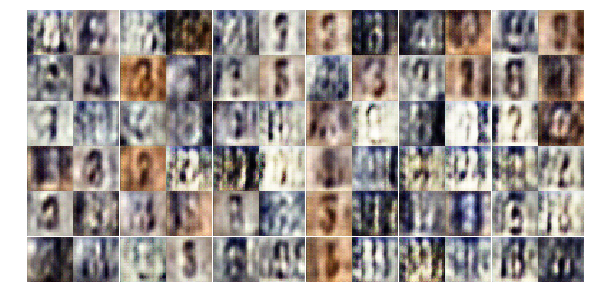

Epoch 2/25... Discriminator Loss: 0.9892... Generator Loss: 1.2817
Epoch 2/25... Discriminator Loss: 0.4962... Generator Loss: 1.6670
Epoch 2/25... Discriminator Loss: 0.6219... Generator Loss: 1.2924
Epoch 2/25... Discriminator Loss: 0.8938... Generator Loss: 1.4703
Epoch 2/25... Discriminator Loss: 0.8797... Generator Loss: 1.1982
Epoch 2/25... Discriminator Loss: 1.0776... Generator Loss: 0.7506
Epoch 2/25... Discriminator Loss: 1.3100... Generator Loss: 1.0137
Epoch 2/25... Discriminator Loss: 1.0989... Generator Loss: 0.9145
Epoch 2/25... Discriminator Loss: 0.6847... Generator Loss: 1.4686
Epoch 2/25... Discriminator Loss: 1.1268... Generator Loss: 0.7253


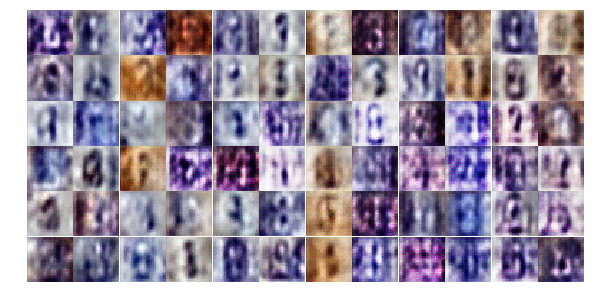

Epoch 2/25... Discriminator Loss: 1.0270... Generator Loss: 0.8478
Epoch 2/25... Discriminator Loss: 1.1781... Generator Loss: 1.0306
Epoch 2/25... Discriminator Loss: 0.8716... Generator Loss: 1.0784
Epoch 2/25... Discriminator Loss: 1.1725... Generator Loss: 1.6336
Epoch 2/25... Discriminator Loss: 1.0787... Generator Loss: 1.0437
Epoch 2/25... Discriminator Loss: 0.9558... Generator Loss: 1.1005
Epoch 2/25... Discriminator Loss: 0.9082... Generator Loss: 0.8749
Epoch 2/25... Discriminator Loss: 1.0451... Generator Loss: 0.6837
Epoch 2/25... Discriminator Loss: 1.2511... Generator Loss: 0.6673
Epoch 2/25... Discriminator Loss: 0.9420... Generator Loss: 1.3243


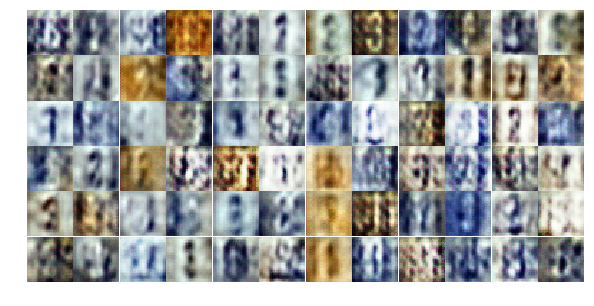

Epoch 2/25... Discriminator Loss: 0.9889... Generator Loss: 1.0199
Epoch 2/25... Discriminator Loss: 0.9610... Generator Loss: 1.3078
Epoch 2/25... Discriminator Loss: 1.2713... Generator Loss: 0.6472
Epoch 2/25... Discriminator Loss: 1.1883... Generator Loss: 0.7925
Epoch 2/25... Discriminator Loss: 1.0815... Generator Loss: 1.2413
Epoch 2/25... Discriminator Loss: 1.0191... Generator Loss: 0.8912
Epoch 2/25... Discriminator Loss: 1.2606... Generator Loss: 0.7296
Epoch 2/25... Discriminator Loss: 1.1187... Generator Loss: 0.9979
Epoch 2/25... Discriminator Loss: 1.0665... Generator Loss: 1.1125
Epoch 2/25... Discriminator Loss: 0.9815... Generator Loss: 1.0536


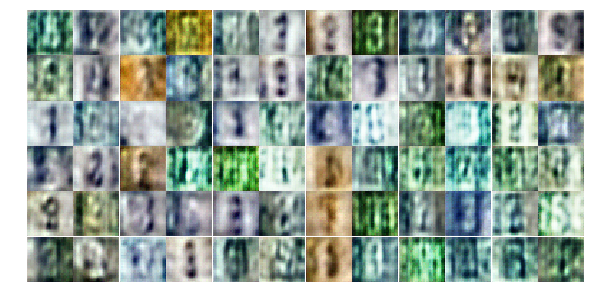

Epoch 2/25... Discriminator Loss: 1.2294... Generator Loss: 0.7958
Epoch 2/25... Discriminator Loss: 1.2081... Generator Loss: 1.1022
Epoch 2/25... Discriminator Loss: 0.7087... Generator Loss: 1.4344
Epoch 2/25... Discriminator Loss: 0.8856... Generator Loss: 1.1965
Epoch 2/25... Discriminator Loss: 1.1357... Generator Loss: 0.7421
Epoch 2/25... Discriminator Loss: 1.0581... Generator Loss: 0.8823
Epoch 2/25... Discriminator Loss: 0.9583... Generator Loss: 1.0114
Epoch 2/25... Discriminator Loss: 0.8347... Generator Loss: 1.2972
Epoch 2/25... Discriminator Loss: 0.6580... Generator Loss: 1.6101
Epoch 2/25... Discriminator Loss: 0.9727... Generator Loss: 1.4480


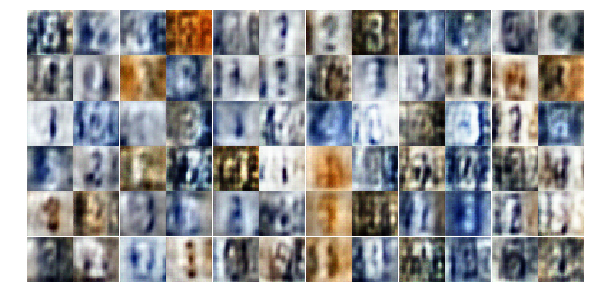

Epoch 2/25... Discriminator Loss: 0.7692... Generator Loss: 1.2116
Epoch 2/25... Discriminator Loss: 0.8071... Generator Loss: 1.1080
Epoch 2/25... Discriminator Loss: 1.3032... Generator Loss: 0.4822
Epoch 2/25... Discriminator Loss: 1.0771... Generator Loss: 1.0938
Epoch 3/25... Discriminator Loss: 1.3538... Generator Loss: 1.1889
Epoch 3/25... Discriminator Loss: 0.7446... Generator Loss: 1.0897
Epoch 3/25... Discriminator Loss: 0.7917... Generator Loss: 1.3269
Epoch 3/25... Discriminator Loss: 0.7207... Generator Loss: 1.5224
Epoch 3/25... Discriminator Loss: 0.8598... Generator Loss: 1.9625
Epoch 3/25... Discriminator Loss: 0.7596... Generator Loss: 1.1825


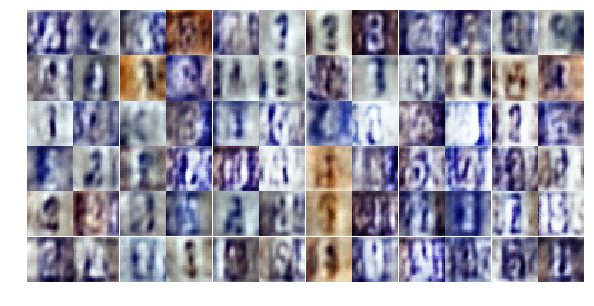

Epoch 3/25... Discriminator Loss: 0.8212... Generator Loss: 1.1432
Epoch 3/25... Discriminator Loss: 0.7782... Generator Loss: 1.4491
Epoch 3/25... Discriminator Loss: 0.4244... Generator Loss: 1.7443
Epoch 3/25... Discriminator Loss: 0.9662... Generator Loss: 1.3794
Epoch 3/25... Discriminator Loss: 0.8961... Generator Loss: 1.1374
Epoch 3/25... Discriminator Loss: 0.8876... Generator Loss: 0.8513
Epoch 3/25... Discriminator Loss: 0.7504... Generator Loss: 0.8866
Epoch 3/25... Discriminator Loss: 0.8099... Generator Loss: 0.8595
Epoch 3/25... Discriminator Loss: 1.6806... Generator Loss: 4.6258
Epoch 3/25... Discriminator Loss: 0.9720... Generator Loss: 0.7666


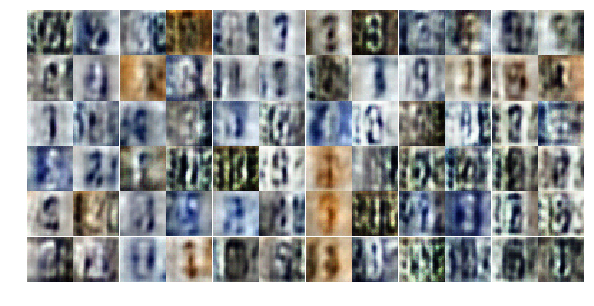

Epoch 3/25... Discriminator Loss: 0.6378... Generator Loss: 1.6193
Epoch 3/25... Discriminator Loss: 0.5878... Generator Loss: 1.4091
Epoch 3/25... Discriminator Loss: 1.3240... Generator Loss: 0.4892
Epoch 3/25... Discriminator Loss: 1.0889... Generator Loss: 2.2821
Epoch 3/25... Discriminator Loss: 0.5934... Generator Loss: 1.8749
Epoch 3/25... Discriminator Loss: 0.8118... Generator Loss: 1.4398
Epoch 3/25... Discriminator Loss: 0.5859... Generator Loss: 1.3481
Epoch 3/25... Discriminator Loss: 0.7301... Generator Loss: 2.4690
Epoch 3/25... Discriminator Loss: 0.5212... Generator Loss: 2.0001
Epoch 3/25... Discriminator Loss: 0.8472... Generator Loss: 0.7710


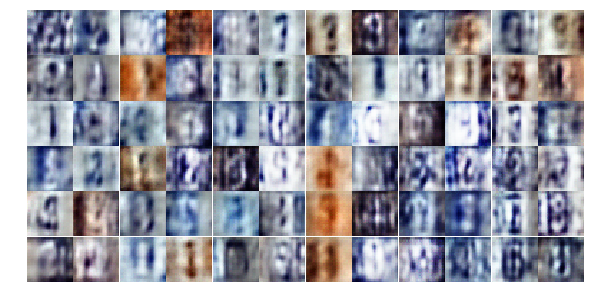

Epoch 3/25... Discriminator Loss: 0.5179... Generator Loss: 1.5548
Epoch 3/25... Discriminator Loss: 0.5791... Generator Loss: 1.1715
Epoch 3/25... Discriminator Loss: 1.1490... Generator Loss: 0.6588
Epoch 3/25... Discriminator Loss: 0.8406... Generator Loss: 0.9430
Epoch 3/25... Discriminator Loss: 1.2315... Generator Loss: 1.7760
Epoch 3/25... Discriminator Loss: 1.0576... Generator Loss: 1.9364
Epoch 3/25... Discriminator Loss: 0.5209... Generator Loss: 1.8651
Epoch 3/25... Discriminator Loss: 0.3461... Generator Loss: 2.4136
Epoch 3/25... Discriminator Loss: 0.8989... Generator Loss: 0.7026
Epoch 3/25... Discriminator Loss: 0.5857... Generator Loss: 1.3288


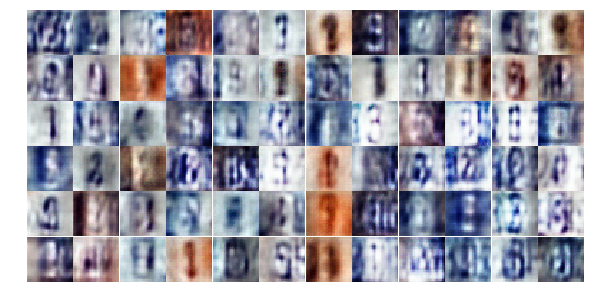

Epoch 3/25... Discriminator Loss: 0.4618... Generator Loss: 2.1441
Epoch 3/25... Discriminator Loss: 0.2952... Generator Loss: 2.6431
Epoch 3/25... Discriminator Loss: 0.4326... Generator Loss: 1.8456
Epoch 3/25... Discriminator Loss: 0.4215... Generator Loss: 2.2985
Epoch 3/25... Discriminator Loss: 0.3384... Generator Loss: 2.5303
Epoch 3/25... Discriminator Loss: 0.7467... Generator Loss: 1.3456
Epoch 3/25... Discriminator Loss: 0.6064... Generator Loss: 1.8325
Epoch 3/25... Discriminator Loss: 0.3516... Generator Loss: 1.8121
Epoch 3/25... Discriminator Loss: 0.8175... Generator Loss: 2.5938
Epoch 3/25... Discriminator Loss: 0.9694... Generator Loss: 1.7580


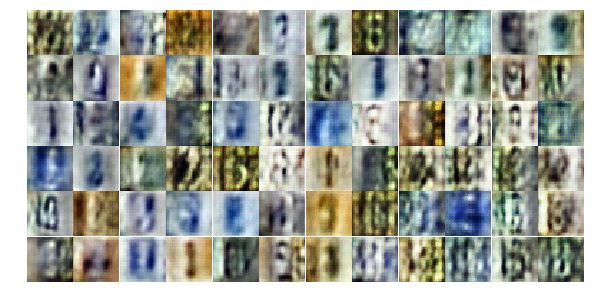

Epoch 3/25... Discriminator Loss: 1.0121... Generator Loss: 0.7937
Epoch 3/25... Discriminator Loss: 0.5866... Generator Loss: 2.0849
Epoch 3/25... Discriminator Loss: 0.6077... Generator Loss: 1.1913
Epoch 3/25... Discriminator Loss: 0.8043... Generator Loss: 1.7571
Epoch 3/25... Discriminator Loss: 0.3948... Generator Loss: 2.8149
Epoch 3/25... Discriminator Loss: 0.3497... Generator Loss: 2.0917
Epoch 3/25... Discriminator Loss: 0.3946... Generator Loss: 2.0674
Epoch 3/25... Discriminator Loss: 0.5156... Generator Loss: 1.9304
Epoch 3/25... Discriminator Loss: 0.6796... Generator Loss: 1.3418
Epoch 3/25... Discriminator Loss: 0.5332... Generator Loss: 1.4617


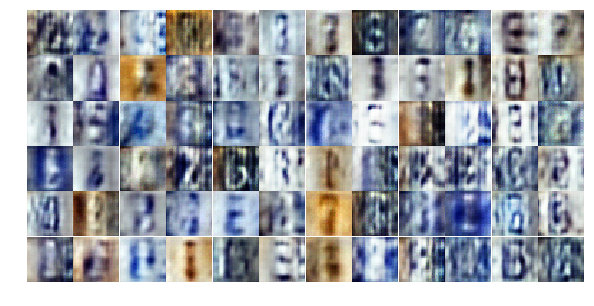

Epoch 3/25... Discriminator Loss: 0.5476... Generator Loss: 1.4458
Epoch 4/25... Discriminator Loss: 1.0024... Generator Loss: 0.7712
Epoch 4/25... Discriminator Loss: 1.0713... Generator Loss: 0.6303
Epoch 4/25... Discriminator Loss: 0.4911... Generator Loss: 1.7758
Epoch 4/25... Discriminator Loss: 0.3374... Generator Loss: 2.4471
Epoch 4/25... Discriminator Loss: 0.3307... Generator Loss: 2.6047
Epoch 4/25... Discriminator Loss: 0.4218... Generator Loss: 2.1747
Epoch 4/25... Discriminator Loss: 1.4085... Generator Loss: 0.4289
Epoch 4/25... Discriminator Loss: 0.6741... Generator Loss: 1.0399
Epoch 4/25... Discriminator Loss: 0.3264... Generator Loss: 1.9791


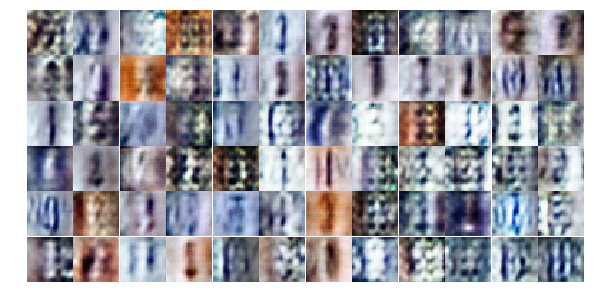

Epoch 4/25... Discriminator Loss: 0.3798... Generator Loss: 2.4027
Epoch 4/25... Discriminator Loss: 0.4100... Generator Loss: 2.0308
Epoch 4/25... Discriminator Loss: 1.0883... Generator Loss: 0.6711
Epoch 4/25... Discriminator Loss: 0.4132... Generator Loss: 1.6649
Epoch 4/25... Discriminator Loss: 0.5983... Generator Loss: 2.1810
Epoch 4/25... Discriminator Loss: 1.3898... Generator Loss: 0.4325
Epoch 4/25... Discriminator Loss: 0.5786... Generator Loss: 1.4258
Epoch 4/25... Discriminator Loss: 0.4346... Generator Loss: 1.7104
Epoch 4/25... Discriminator Loss: 0.6492... Generator Loss: 1.8970
Epoch 4/25... Discriminator Loss: 0.5424... Generator Loss: 1.3516


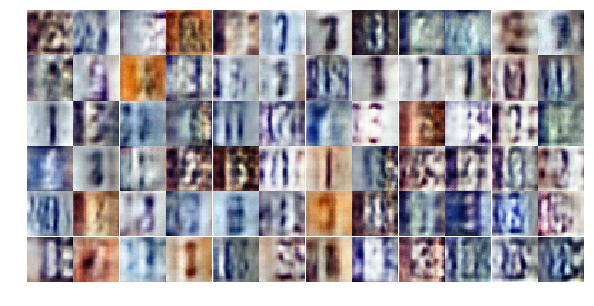

Epoch 4/25... Discriminator Loss: 0.8615... Generator Loss: 1.0904
Epoch 4/25... Discriminator Loss: 0.5597... Generator Loss: 1.4215
Epoch 4/25... Discriminator Loss: 0.7559... Generator Loss: 0.9394
Epoch 4/25... Discriminator Loss: 0.5435... Generator Loss: 1.6352
Epoch 4/25... Discriminator Loss: 0.3759... Generator Loss: 2.0337
Epoch 4/25... Discriminator Loss: 0.4791... Generator Loss: 2.9383
Epoch 4/25... Discriminator Loss: 0.5013... Generator Loss: 1.4915
Epoch 4/25... Discriminator Loss: 0.3946... Generator Loss: 1.5919
Epoch 4/25... Discriminator Loss: 0.4536... Generator Loss: 2.1357
Epoch 4/25... Discriminator Loss: 0.2432... Generator Loss: 2.5152


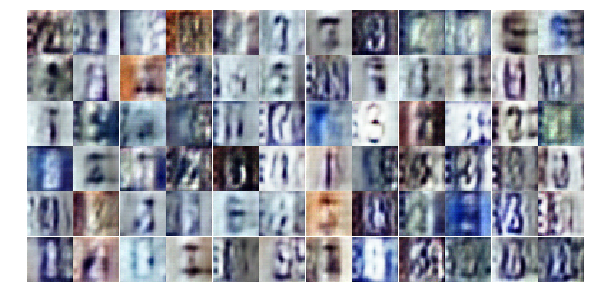

Epoch 4/25... Discriminator Loss: 0.6417... Generator Loss: 1.9456
Epoch 4/25... Discriminator Loss: 0.6796... Generator Loss: 2.2592
Epoch 4/25... Discriminator Loss: 0.3040... Generator Loss: 2.6111
Epoch 4/25... Discriminator Loss: 0.4744... Generator Loss: 1.8871
Epoch 4/25... Discriminator Loss: 0.3515... Generator Loss: 2.3840
Epoch 4/25... Discriminator Loss: 0.2729... Generator Loss: 2.0641
Epoch 4/25... Discriminator Loss: 0.4968... Generator Loss: 2.0280
Epoch 4/25... Discriminator Loss: 0.4262... Generator Loss: 2.2610
Epoch 4/25... Discriminator Loss: 0.6214... Generator Loss: 1.2007
Epoch 4/25... Discriminator Loss: 0.6731... Generator Loss: 1.0313


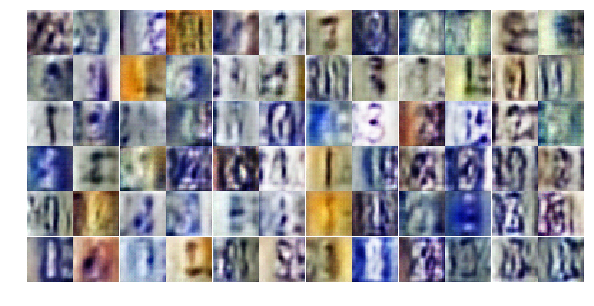

Epoch 4/25... Discriminator Loss: 1.2423... Generator Loss: 0.5271
Epoch 4/25... Discriminator Loss: 0.5495... Generator Loss: 2.8964
Epoch 4/25... Discriminator Loss: 0.8063... Generator Loss: 0.9770
Epoch 4/25... Discriminator Loss: 0.4871... Generator Loss: 1.4277
Epoch 4/25... Discriminator Loss: 0.3834... Generator Loss: 1.8460
Epoch 4/25... Discriminator Loss: 0.9415... Generator Loss: 0.7898
Epoch 4/25... Discriminator Loss: 0.4627... Generator Loss: 1.4144
Epoch 4/25... Discriminator Loss: 0.8972... Generator Loss: 2.3757
Epoch 4/25... Discriminator Loss: 0.6002... Generator Loss: 1.1869
Epoch 4/25... Discriminator Loss: 0.5846... Generator Loss: 1.3631


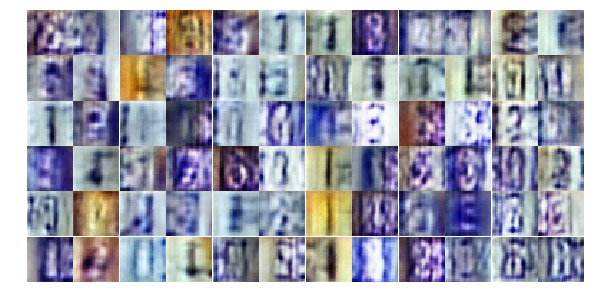

Epoch 4/25... Discriminator Loss: 0.6042... Generator Loss: 1.1748
Epoch 4/25... Discriminator Loss: 0.4238... Generator Loss: 2.3603
Epoch 4/25... Discriminator Loss: 0.6991... Generator Loss: 0.9506
Epoch 4/25... Discriminator Loss: 0.4378... Generator Loss: 1.8541
Epoch 4/25... Discriminator Loss: 0.5684... Generator Loss: 1.3329
Epoch 4/25... Discriminator Loss: 0.5053... Generator Loss: 1.8023
Epoch 4/25... Discriminator Loss: 0.3603... Generator Loss: 1.6929
Epoch 4/25... Discriminator Loss: 0.8626... Generator Loss: 0.8658
Epoch 4/25... Discriminator Loss: 0.4339... Generator Loss: 1.5941
Epoch 5/25... Discriminator Loss: 0.3597... Generator Loss: 2.0632


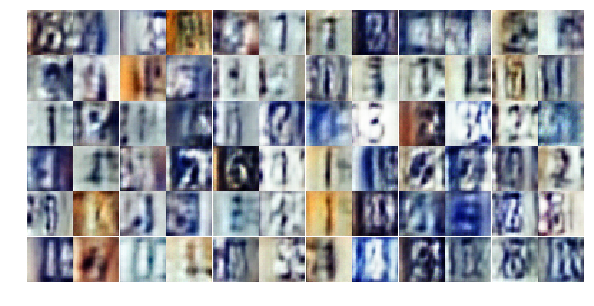

Epoch 5/25... Discriminator Loss: 0.2812... Generator Loss: 2.0485
Epoch 5/25... Discriminator Loss: 0.6388... Generator Loss: 1.0116
Epoch 5/25... Discriminator Loss: 1.5332... Generator Loss: 3.0333
Epoch 5/25... Discriminator Loss: 1.3434... Generator Loss: 0.5446
Epoch 5/25... Discriminator Loss: 0.8758... Generator Loss: 0.9951
Epoch 5/25... Discriminator Loss: 0.8589... Generator Loss: 0.9329
Epoch 5/25... Discriminator Loss: 0.5812... Generator Loss: 1.4910
Epoch 5/25... Discriminator Loss: 0.6034... Generator Loss: 2.7572
Epoch 5/25... Discriminator Loss: 1.5410... Generator Loss: 0.3378
Epoch 5/25... Discriminator Loss: 0.6383... Generator Loss: 1.2559


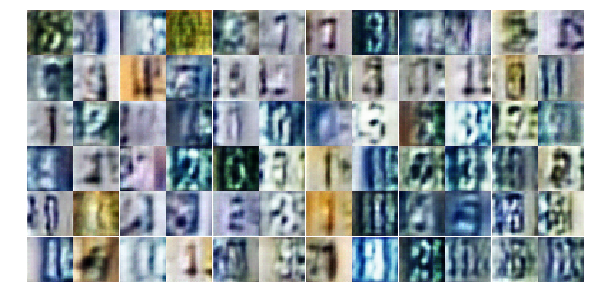

Epoch 5/25... Discriminator Loss: 0.5791... Generator Loss: 1.2095
Epoch 5/25... Discriminator Loss: 0.4534... Generator Loss: 1.5458
Epoch 5/25... Discriminator Loss: 0.3581... Generator Loss: 1.6266
Epoch 5/25... Discriminator Loss: 0.9379... Generator Loss: 0.6817
Epoch 5/25... Discriminator Loss: 0.6452... Generator Loss: 1.7963
Epoch 5/25... Discriminator Loss: 0.7723... Generator Loss: 0.8585
Epoch 5/25... Discriminator Loss: 0.5050... Generator Loss: 1.2835
Epoch 5/25... Discriminator Loss: 0.4224... Generator Loss: 2.0820
Epoch 5/25... Discriminator Loss: 0.4208... Generator Loss: 1.8071
Epoch 5/25... Discriminator Loss: 0.4221... Generator Loss: 1.7202


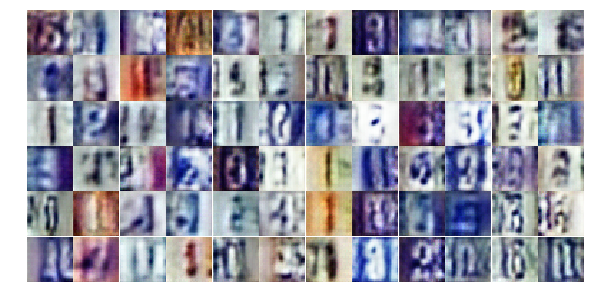

Epoch 5/25... Discriminator Loss: 0.4363... Generator Loss: 1.3690
Epoch 5/25... Discriminator Loss: 0.6453... Generator Loss: 1.6463
Epoch 5/25... Discriminator Loss: 0.7349... Generator Loss: 1.6858
Epoch 5/25... Discriminator Loss: 0.6111... Generator Loss: 1.5785
Epoch 5/25... Discriminator Loss: 0.9251... Generator Loss: 0.7197
Epoch 5/25... Discriminator Loss: 0.3694... Generator Loss: 1.7731
Epoch 5/25... Discriminator Loss: 0.8191... Generator Loss: 0.7508
Epoch 5/25... Discriminator Loss: 0.9607... Generator Loss: 0.7746
Epoch 5/25... Discriminator Loss: 0.8638... Generator Loss: 0.7835
Epoch 5/25... Discriminator Loss: 0.4183... Generator Loss: 1.9582


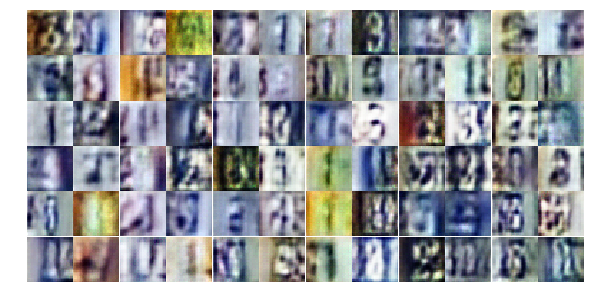

Epoch 5/25... Discriminator Loss: 0.6261... Generator Loss: 1.2319
Epoch 5/25... Discriminator Loss: 0.3952... Generator Loss: 2.1901
Epoch 5/25... Discriminator Loss: 0.4902... Generator Loss: 1.7685
Epoch 5/25... Discriminator Loss: 0.9981... Generator Loss: 0.6380
Epoch 5/25... Discriminator Loss: 0.4602... Generator Loss: 1.4392
Epoch 5/25... Discriminator Loss: 0.3339... Generator Loss: 2.1405
Epoch 5/25... Discriminator Loss: 0.8357... Generator Loss: 0.7620
Epoch 5/25... Discriminator Loss: 0.5487... Generator Loss: 1.2256
Epoch 5/25... Discriminator Loss: 0.7699... Generator Loss: 0.8278
Epoch 5/25... Discriminator Loss: 0.7913... Generator Loss: 0.9166


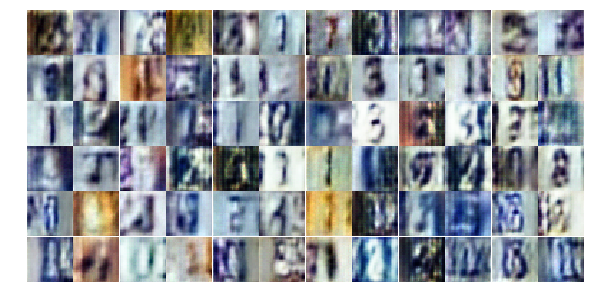

Epoch 5/25... Discriminator Loss: 0.4076... Generator Loss: 1.8550
Epoch 5/25... Discriminator Loss: 0.4611... Generator Loss: 1.2327
Epoch 5/25... Discriminator Loss: 0.6130... Generator Loss: 1.1941
Epoch 5/25... Discriminator Loss: 1.6763... Generator Loss: 0.3259
Epoch 5/25... Discriminator Loss: 0.8789... Generator Loss: 1.5318
Epoch 5/25... Discriminator Loss: 0.9857... Generator Loss: 0.8490
Epoch 5/25... Discriminator Loss: 0.5706... Generator Loss: 1.6392
Epoch 5/25... Discriminator Loss: 0.7184... Generator Loss: 1.1683
Epoch 5/25... Discriminator Loss: 0.5623... Generator Loss: 1.3123
Epoch 5/25... Discriminator Loss: 0.5887... Generator Loss: 1.2145


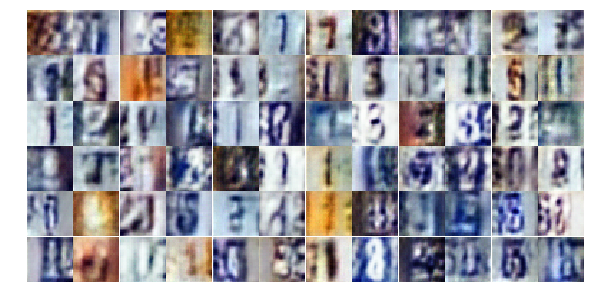

Epoch 5/25... Discriminator Loss: 0.9640... Generator Loss: 0.8572
Epoch 5/25... Discriminator Loss: 0.7720... Generator Loss: 0.8886
Epoch 5/25... Discriminator Loss: 0.6639... Generator Loss: 1.2567
Epoch 5/25... Discriminator Loss: 0.5508... Generator Loss: 1.1194
Epoch 5/25... Discriminator Loss: 0.9855... Generator Loss: 0.6932
Epoch 5/25... Discriminator Loss: 0.7754... Generator Loss: 1.2239
Epoch 6/25... Discriminator Loss: 0.7339... Generator Loss: 1.0366
Epoch 6/25... Discriminator Loss: 0.5037... Generator Loss: 1.3172
Epoch 6/25... Discriminator Loss: 0.7882... Generator Loss: 0.8627
Epoch 6/25... Discriminator Loss: 0.6892... Generator Loss: 1.6273


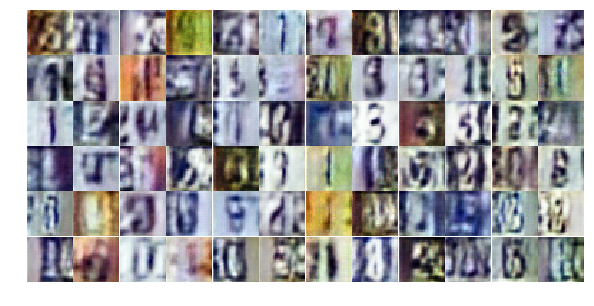

Epoch 6/25... Discriminator Loss: 0.7882... Generator Loss: 0.8194
Epoch 6/25... Discriminator Loss: 0.5832... Generator Loss: 1.1513
Epoch 6/25... Discriminator Loss: 0.5846... Generator Loss: 1.2292
Epoch 6/25... Discriminator Loss: 0.8558... Generator Loss: 1.7452
Epoch 6/25... Discriminator Loss: 1.0955... Generator Loss: 0.6022
Epoch 6/25... Discriminator Loss: 0.7110... Generator Loss: 0.9754
Epoch 6/25... Discriminator Loss: 1.0401... Generator Loss: 0.6392
Epoch 6/25... Discriminator Loss: 0.9561... Generator Loss: 1.3031
Epoch 6/25... Discriminator Loss: 0.6090... Generator Loss: 1.2280
Epoch 6/25... Discriminator Loss: 0.5228... Generator Loss: 1.6812


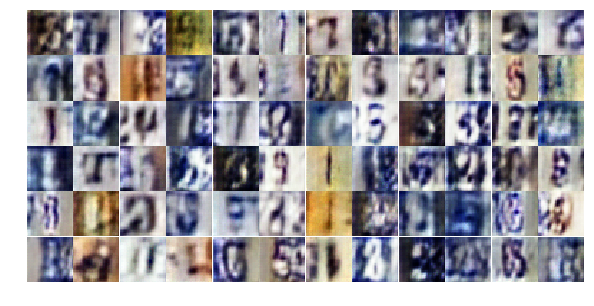

Epoch 6/25... Discriminator Loss: 0.6207... Generator Loss: 1.7824
Epoch 6/25... Discriminator Loss: 2.0004... Generator Loss: 1.5974
Epoch 6/25... Discriminator Loss: 1.5088... Generator Loss: 0.3508
Epoch 6/25... Discriminator Loss: 0.6845... Generator Loss: 0.9996
Epoch 6/25... Discriminator Loss: 0.5620... Generator Loss: 1.7929
Epoch 6/25... Discriminator Loss: 0.5634... Generator Loss: 1.4356
Epoch 6/25... Discriminator Loss: 0.5171... Generator Loss: 1.3186
Epoch 6/25... Discriminator Loss: 0.7521... Generator Loss: 0.9127
Epoch 6/25... Discriminator Loss: 0.6914... Generator Loss: 3.2262
Epoch 6/25... Discriminator Loss: 1.0729... Generator Loss: 0.6815


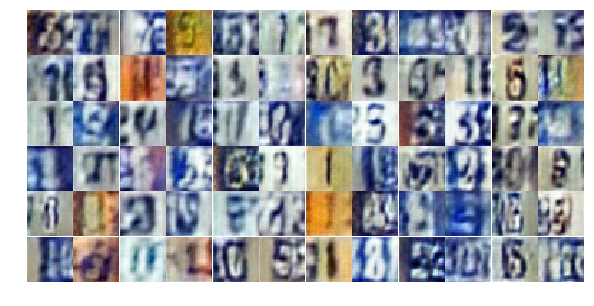

Epoch 6/25... Discriminator Loss: 0.9106... Generator Loss: 0.7410
Epoch 6/25... Discriminator Loss: 0.7100... Generator Loss: 1.2046
Epoch 6/25... Discriminator Loss: 0.8620... Generator Loss: 1.1605
Epoch 6/25... Discriminator Loss: 0.8408... Generator Loss: 1.0986
Epoch 6/25... Discriminator Loss: 0.5496... Generator Loss: 1.5573
Epoch 6/25... Discriminator Loss: 1.6177... Generator Loss: 0.3444
Epoch 6/25... Discriminator Loss: 0.7142... Generator Loss: 1.5674
Epoch 6/25... Discriminator Loss: 0.4591... Generator Loss: 1.2991
Epoch 6/25... Discriminator Loss: 0.5325... Generator Loss: 1.4770
Epoch 6/25... Discriminator Loss: 0.4961... Generator Loss: 1.3527


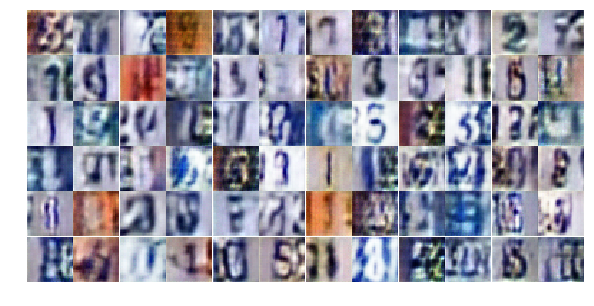

Epoch 6/25... Discriminator Loss: 1.2350... Generator Loss: 0.5046
Epoch 6/25... Discriminator Loss: 1.9374... Generator Loss: 2.6651
Epoch 6/25... Discriminator Loss: 1.0852... Generator Loss: 0.5647
Epoch 6/25... Discriminator Loss: 0.8600... Generator Loss: 0.9243
Epoch 6/25... Discriminator Loss: 1.0176... Generator Loss: 0.7129
Epoch 6/25... Discriminator Loss: 0.7322... Generator Loss: 0.9511
Epoch 6/25... Discriminator Loss: 0.5554... Generator Loss: 1.4537
Epoch 6/25... Discriminator Loss: 0.6963... Generator Loss: 1.5891
Epoch 6/25... Discriminator Loss: 1.3869... Generator Loss: 0.3723
Epoch 6/25... Discriminator Loss: 0.3863... Generator Loss: 2.0084


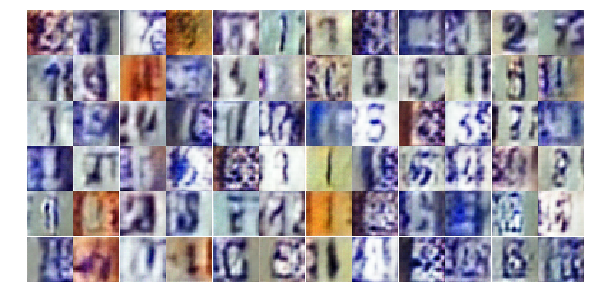

Epoch 6/25... Discriminator Loss: 0.6599... Generator Loss: 1.9346
Epoch 6/25... Discriminator Loss: 0.5977... Generator Loss: 1.3773
Epoch 6/25... Discriminator Loss: 1.2156... Generator Loss: 0.4823
Epoch 6/25... Discriminator Loss: 0.6617... Generator Loss: 2.2402
Epoch 6/25... Discriminator Loss: 0.5678... Generator Loss: 1.2199
Epoch 6/25... Discriminator Loss: 0.6002... Generator Loss: 1.2087
Epoch 6/25... Discriminator Loss: 0.7495... Generator Loss: 0.9081
Epoch 6/25... Discriminator Loss: 1.0204... Generator Loss: 0.5883
Epoch 6/25... Discriminator Loss: 0.9502... Generator Loss: 0.7292
Epoch 6/25... Discriminator Loss: 1.3015... Generator Loss: 0.5325


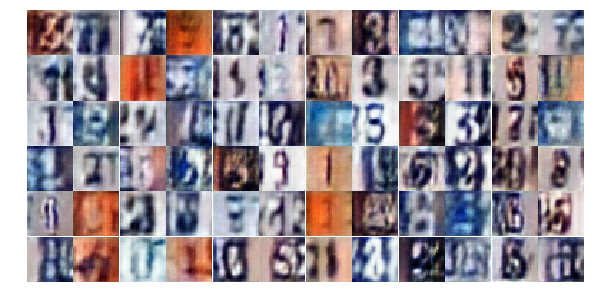

Epoch 6/25... Discriminator Loss: 0.5546... Generator Loss: 1.2494
Epoch 6/25... Discriminator Loss: 0.5555... Generator Loss: 1.2682
Epoch 6/25... Discriminator Loss: 0.9616... Generator Loss: 0.8462
Epoch 7/25... Discriminator Loss: 0.5407... Generator Loss: 2.3527
Epoch 7/25... Discriminator Loss: 0.5186... Generator Loss: 1.8556
Epoch 7/25... Discriminator Loss: 0.4970... Generator Loss: 1.5269
Epoch 7/25... Discriminator Loss: 0.7770... Generator Loss: 0.8538
Epoch 7/25... Discriminator Loss: 0.5998... Generator Loss: 1.2894
Epoch 7/25... Discriminator Loss: 0.4174... Generator Loss: 1.6703
Epoch 7/25... Discriminator Loss: 0.6312... Generator Loss: 1.1187


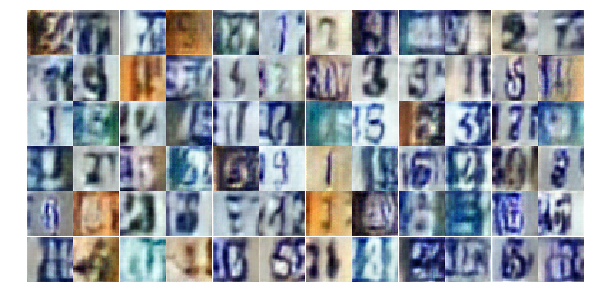

Epoch 7/25... Discriminator Loss: 0.5453... Generator Loss: 1.1930
Epoch 7/25... Discriminator Loss: 1.0834... Generator Loss: 0.5825
Epoch 7/25... Discriminator Loss: 0.9979... Generator Loss: 0.6308
Epoch 7/25... Discriminator Loss: 0.8337... Generator Loss: 2.6572
Epoch 7/25... Discriminator Loss: 0.4325... Generator Loss: 1.7873
Epoch 7/25... Discriminator Loss: 0.6402... Generator Loss: 1.8687
Epoch 7/25... Discriminator Loss: 1.0188... Generator Loss: 2.4050
Epoch 7/25... Discriminator Loss: 0.9161... Generator Loss: 2.1435
Epoch 7/25... Discriminator Loss: 0.6543... Generator Loss: 1.6498
Epoch 7/25... Discriminator Loss: 0.7082... Generator Loss: 0.9897


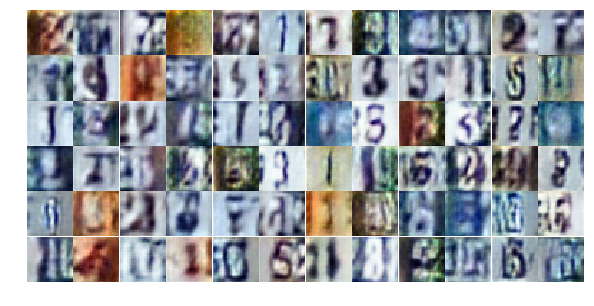

Epoch 7/25... Discriminator Loss: 0.6048... Generator Loss: 1.2538
Epoch 7/25... Discriminator Loss: 0.4546... Generator Loss: 1.6409
Epoch 7/25... Discriminator Loss: 1.0895... Generator Loss: 0.5551
Epoch 7/25... Discriminator Loss: 1.2035... Generator Loss: 0.5589
Epoch 7/25... Discriminator Loss: 0.5025... Generator Loss: 1.7016
Epoch 7/25... Discriminator Loss: 0.6775... Generator Loss: 1.6031
Epoch 7/25... Discriminator Loss: 0.7188... Generator Loss: 0.9284
Epoch 7/25... Discriminator Loss: 1.0483... Generator Loss: 0.6212
Epoch 7/25... Discriminator Loss: 0.2505... Generator Loss: 1.8939
Epoch 7/25... Discriminator Loss: 0.4496... Generator Loss: 1.9981


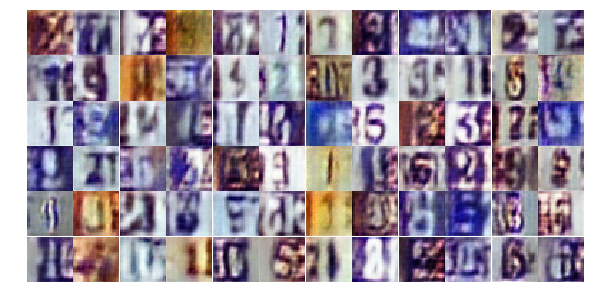

Epoch 7/25... Discriminator Loss: 1.0843... Generator Loss: 0.5803
Epoch 7/25... Discriminator Loss: 0.7207... Generator Loss: 0.9934
Epoch 7/25... Discriminator Loss: 0.7166... Generator Loss: 1.1221
Epoch 7/25... Discriminator Loss: 0.4897... Generator Loss: 1.6030
Epoch 7/25... Discriminator Loss: 0.8843... Generator Loss: 0.7478
Epoch 7/25... Discriminator Loss: 1.1305... Generator Loss: 0.5186
Epoch 7/25... Discriminator Loss: 1.2591... Generator Loss: 0.5008
Epoch 7/25... Discriminator Loss: 0.5967... Generator Loss: 1.1740
Epoch 7/25... Discriminator Loss: 1.1980... Generator Loss: 0.4942
Epoch 7/25... Discriminator Loss: 0.4196... Generator Loss: 2.1008


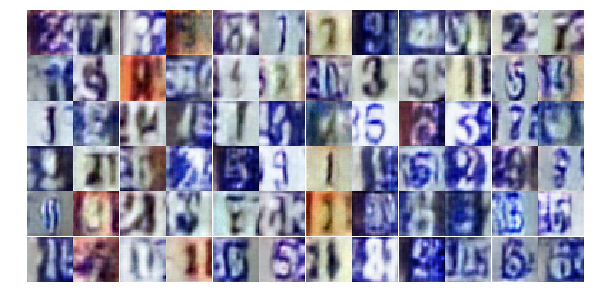

Epoch 7/25... Discriminator Loss: 1.8286... Generator Loss: 0.2380
Epoch 7/25... Discriminator Loss: 0.5921... Generator Loss: 1.1914
Epoch 7/25... Discriminator Loss: 0.3587... Generator Loss: 1.7104
Epoch 7/25... Discriminator Loss: 0.5314... Generator Loss: 1.6559
Epoch 7/25... Discriminator Loss: 1.1898... Generator Loss: 0.5160
Epoch 7/25... Discriminator Loss: 0.4782... Generator Loss: 1.9213
Epoch 7/25... Discriminator Loss: 0.6628... Generator Loss: 1.0537
Epoch 7/25... Discriminator Loss: 1.3013... Generator Loss: 0.6472
Epoch 7/25... Discriminator Loss: 0.4090... Generator Loss: 2.4723
Epoch 7/25... Discriminator Loss: 0.6932... Generator Loss: 1.1158


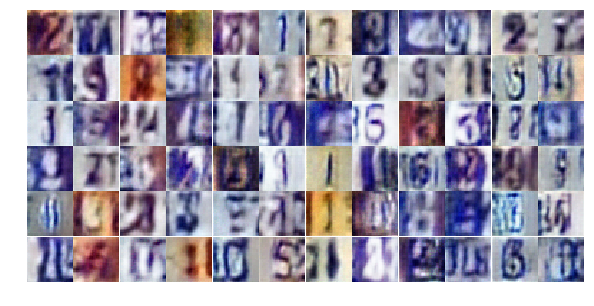

Epoch 7/25... Discriminator Loss: 0.5357... Generator Loss: 1.8184
Epoch 7/25... Discriminator Loss: 0.4514... Generator Loss: 1.5840
Epoch 7/25... Discriminator Loss: 0.9869... Generator Loss: 0.6119
Epoch 7/25... Discriminator Loss: 0.6890... Generator Loss: 0.9772
Epoch 7/25... Discriminator Loss: 0.4568... Generator Loss: 1.6891
Epoch 7/25... Discriminator Loss: 0.8510... Generator Loss: 0.8996
Epoch 7/25... Discriminator Loss: 1.0275... Generator Loss: 0.6578
Epoch 7/25... Discriminator Loss: 0.7140... Generator Loss: 1.0657
Epoch 7/25... Discriminator Loss: 0.8894... Generator Loss: 0.7542
Epoch 7/25... Discriminator Loss: 0.5177... Generator Loss: 1.1824


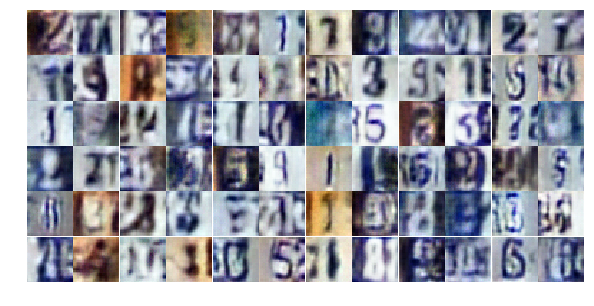

Epoch 7/25... Discriminator Loss: 0.4327... Generator Loss: 1.9205
Epoch 8/25... Discriminator Loss: 0.7509... Generator Loss: 0.8800
Epoch 8/25... Discriminator Loss: 0.8023... Generator Loss: 0.7854
Epoch 8/25... Discriminator Loss: 0.7357... Generator Loss: 1.0753
Epoch 8/25... Discriminator Loss: 0.5735... Generator Loss: 1.3271
Epoch 8/25... Discriminator Loss: 1.1170... Generator Loss: 0.5355
Epoch 8/25... Discriminator Loss: 0.5999... Generator Loss: 1.0928
Epoch 8/25... Discriminator Loss: 1.7018... Generator Loss: 2.9730
Epoch 8/25... Discriminator Loss: 1.6592... Generator Loss: 0.3207
Epoch 8/25... Discriminator Loss: 0.7021... Generator Loss: 1.6876


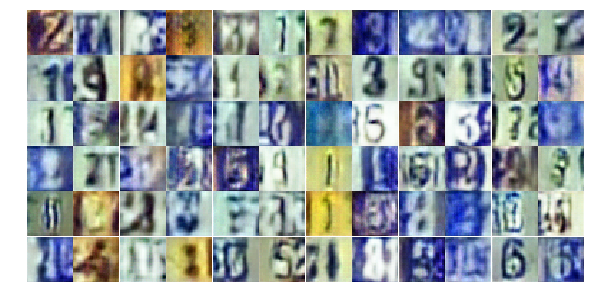

Epoch 8/25... Discriminator Loss: 0.5135... Generator Loss: 1.8903
Epoch 8/25... Discriminator Loss: 0.5747... Generator Loss: 1.3196
Epoch 8/25... Discriminator Loss: 0.9024... Generator Loss: 0.7167
Epoch 8/25... Discriminator Loss: 0.5076... Generator Loss: 1.9063
Epoch 8/25... Discriminator Loss: 1.3690... Generator Loss: 0.3965
Epoch 8/25... Discriminator Loss: 0.4966... Generator Loss: 1.7464
Epoch 8/25... Discriminator Loss: 0.4167... Generator Loss: 1.7135
Epoch 8/25... Discriminator Loss: 0.2713... Generator Loss: 2.3324
Epoch 8/25... Discriminator Loss: 0.5509... Generator Loss: 1.3688
Epoch 8/25... Discriminator Loss: 0.7835... Generator Loss: 0.9590


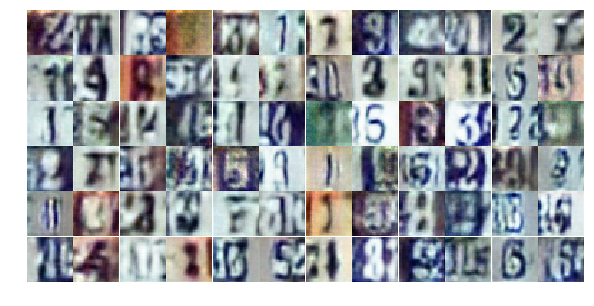

Epoch 8/25... Discriminator Loss: 0.4779... Generator Loss: 1.5421
Epoch 8/25... Discriminator Loss: 0.7054... Generator Loss: 1.2109
Epoch 8/25... Discriminator Loss: 0.5853... Generator Loss: 1.3824
Epoch 8/25... Discriminator Loss: 0.5513... Generator Loss: 2.4428
Epoch 8/25... Discriminator Loss: 0.4997... Generator Loss: 1.3855
Epoch 8/25... Discriminator Loss: 0.4539... Generator Loss: 1.6788
Epoch 8/25... Discriminator Loss: 0.5579... Generator Loss: 1.9934
Epoch 8/25... Discriminator Loss: 1.2914... Generator Loss: 0.4285
Epoch 8/25... Discriminator Loss: 0.7902... Generator Loss: 1.7557
Epoch 8/25... Discriminator Loss: 0.5688... Generator Loss: 1.4510


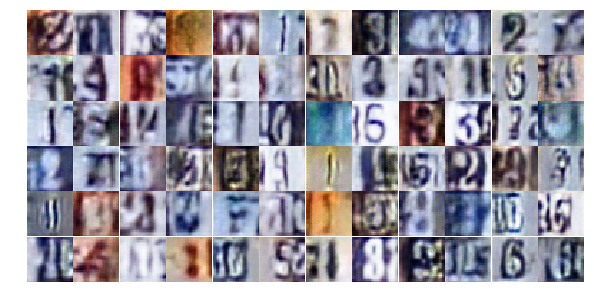

Epoch 8/25... Discriminator Loss: 0.8092... Generator Loss: 1.2595
Epoch 8/25... Discriminator Loss: 1.0145... Generator Loss: 0.6092
Epoch 8/25... Discriminator Loss: 0.5155... Generator Loss: 1.3023
Epoch 8/25... Discriminator Loss: 0.7926... Generator Loss: 0.8134
Epoch 8/25... Discriminator Loss: 0.6590... Generator Loss: 1.0175
Epoch 8/25... Discriminator Loss: 0.4557... Generator Loss: 1.6514
Epoch 8/25... Discriminator Loss: 0.6133... Generator Loss: 2.1043
Epoch 8/25... Discriminator Loss: 0.5221... Generator Loss: 1.3664
Epoch 8/25... Discriminator Loss: 0.5237... Generator Loss: 1.6966
Epoch 8/25... Discriminator Loss: 0.6208... Generator Loss: 1.1504


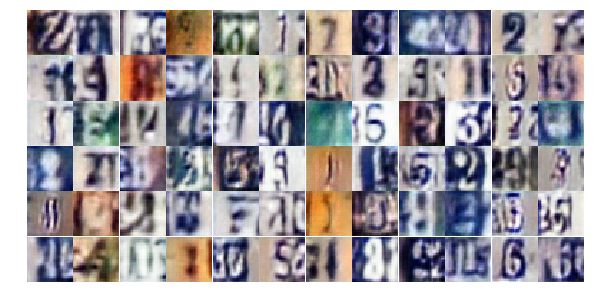

Epoch 8/25... Discriminator Loss: 0.4556... Generator Loss: 1.5331
Epoch 8/25... Discriminator Loss: 1.2808... Generator Loss: 0.4492
Epoch 8/25... Discriminator Loss: 0.8023... Generator Loss: 0.9471
Epoch 8/25... Discriminator Loss: 0.5374... Generator Loss: 1.2497
Epoch 8/25... Discriminator Loss: 1.4419... Generator Loss: 3.2794
Epoch 8/25... Discriminator Loss: 1.0277... Generator Loss: 0.6544
Epoch 8/25... Discriminator Loss: 0.6089... Generator Loss: 1.4026
Epoch 8/25... Discriminator Loss: 0.5792... Generator Loss: 1.7418
Epoch 8/25... Discriminator Loss: 0.5643... Generator Loss: 1.2915
Epoch 8/25... Discriminator Loss: 0.7349... Generator Loss: 1.0087


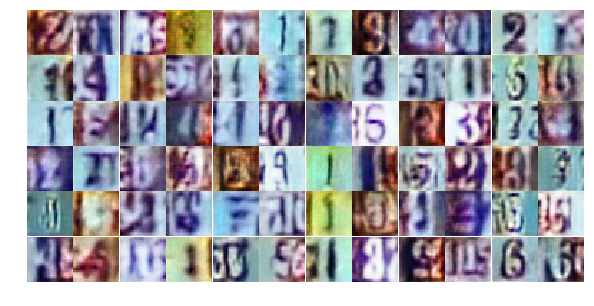

Epoch 8/25... Discriminator Loss: 0.5162... Generator Loss: 1.7010
Epoch 8/25... Discriminator Loss: 0.5205... Generator Loss: 1.3237
Epoch 8/25... Discriminator Loss: 1.0702... Generator Loss: 0.6908
Epoch 8/25... Discriminator Loss: 0.7665... Generator Loss: 0.8406
Epoch 8/25... Discriminator Loss: 0.3561... Generator Loss: 2.7743
Epoch 8/25... Discriminator Loss: 0.7298... Generator Loss: 1.2627
Epoch 8/25... Discriminator Loss: 0.4657... Generator Loss: 1.6527
Epoch 8/25... Discriminator Loss: 0.6091... Generator Loss: 1.1619
Epoch 9/25... Discriminator Loss: 0.7848... Generator Loss: 1.2250
Epoch 9/25... Discriminator Loss: 0.9590... Generator Loss: 0.6746


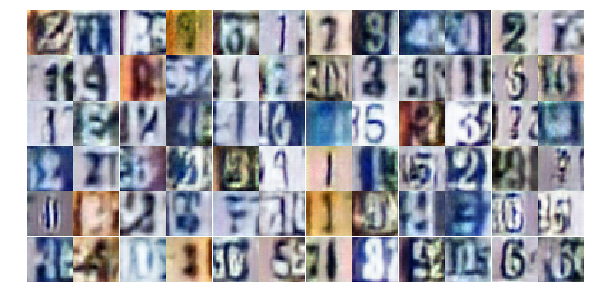

Epoch 9/25... Discriminator Loss: 0.8402... Generator Loss: 0.7778
Epoch 9/25... Discriminator Loss: 0.5951... Generator Loss: 1.2004
Epoch 9/25... Discriminator Loss: 0.8049... Generator Loss: 0.8011
Epoch 9/25... Discriminator Loss: 0.4132... Generator Loss: 1.6849
Epoch 9/25... Discriminator Loss: 0.9941... Generator Loss: 0.6337
Epoch 9/25... Discriminator Loss: 0.4975... Generator Loss: 2.1106
Epoch 9/25... Discriminator Loss: 0.6570... Generator Loss: 1.0156
Epoch 9/25... Discriminator Loss: 0.5693... Generator Loss: 1.1867
Epoch 9/25... Discriminator Loss: 0.8136... Generator Loss: 0.9675
Epoch 9/25... Discriminator Loss: 0.6493... Generator Loss: 1.1498


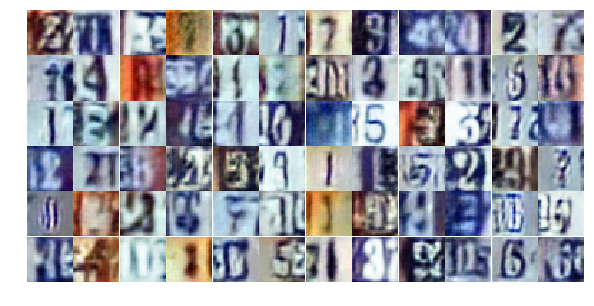

Epoch 9/25... Discriminator Loss: 0.6496... Generator Loss: 1.1330
Epoch 9/25... Discriminator Loss: 1.0082... Generator Loss: 1.0170
Epoch 9/25... Discriminator Loss: 1.1263... Generator Loss: 1.2486
Epoch 9/25... Discriminator Loss: 0.7074... Generator Loss: 1.1838
Epoch 9/25... Discriminator Loss: 0.6266... Generator Loss: 1.2925
Epoch 9/25... Discriminator Loss: 1.2675... Generator Loss: 0.4650
Epoch 9/25... Discriminator Loss: 1.0674... Generator Loss: 0.5783
Epoch 9/25... Discriminator Loss: 0.4074... Generator Loss: 1.6719
Epoch 9/25... Discriminator Loss: 1.1604... Generator Loss: 0.5255
Epoch 9/25... Discriminator Loss: 0.9664... Generator Loss: 0.6608


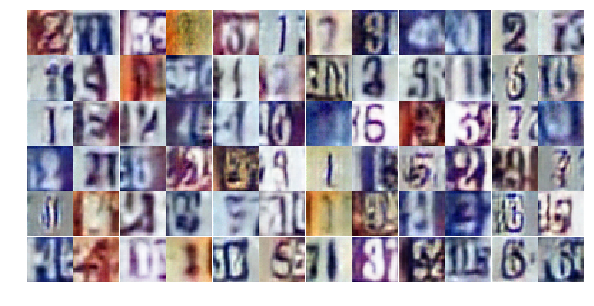

Epoch 9/25... Discriminator Loss: 0.8624... Generator Loss: 0.9579
Epoch 9/25... Discriminator Loss: 0.7106... Generator Loss: 1.0796
Epoch 9/25... Discriminator Loss: 0.6653... Generator Loss: 1.2904
Epoch 9/25... Discriminator Loss: 0.5180... Generator Loss: 1.5066
Epoch 9/25... Discriminator Loss: 0.5351... Generator Loss: 1.6186
Epoch 9/25... Discriminator Loss: 0.4304... Generator Loss: 1.5454
Epoch 9/25... Discriminator Loss: 0.7487... Generator Loss: 0.8988
Epoch 9/25... Discriminator Loss: 0.4739... Generator Loss: 2.0413
Epoch 9/25... Discriminator Loss: 0.5653... Generator Loss: 1.9307
Epoch 9/25... Discriminator Loss: 0.5420... Generator Loss: 1.2497


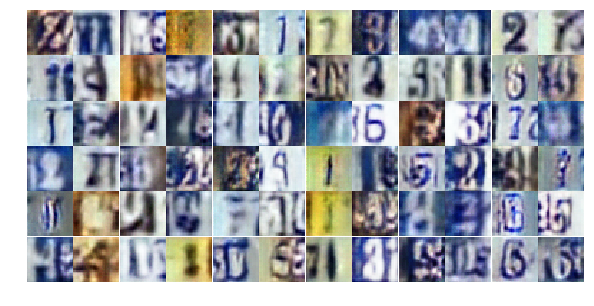

Epoch 9/25... Discriminator Loss: 0.4442... Generator Loss: 1.6202
Epoch 9/25... Discriminator Loss: 0.6331... Generator Loss: 1.0693
Epoch 9/25... Discriminator Loss: 0.7459... Generator Loss: 0.8635
Epoch 9/25... Discriminator Loss: 0.6168... Generator Loss: 1.3199
Epoch 9/25... Discriminator Loss: 0.5889... Generator Loss: 1.1741
Epoch 9/25... Discriminator Loss: 0.7281... Generator Loss: 0.9643
Epoch 9/25... Discriminator Loss: 0.5047... Generator Loss: 1.4997
Epoch 9/25... Discriminator Loss: 0.4809... Generator Loss: 1.3099
Epoch 9/25... Discriminator Loss: 1.0429... Generator Loss: 0.6066
Epoch 9/25... Discriminator Loss: 1.1025... Generator Loss: 0.5406


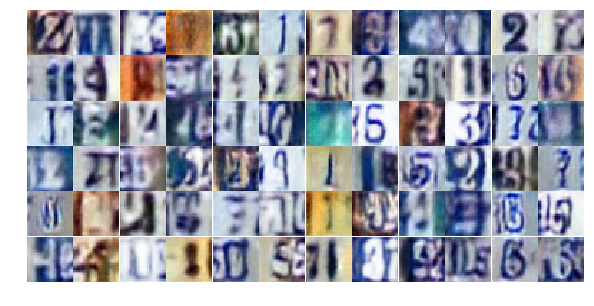

Epoch 9/25... Discriminator Loss: 0.6585... Generator Loss: 1.0336
Epoch 9/25... Discriminator Loss: 0.6742... Generator Loss: 0.9730
Epoch 9/25... Discriminator Loss: 0.5323... Generator Loss: 1.7572
Epoch 9/25... Discriminator Loss: 0.9547... Generator Loss: 2.6602
Epoch 9/25... Discriminator Loss: 0.5091... Generator Loss: 1.4726
Epoch 9/25... Discriminator Loss: 0.8693... Generator Loss: 0.7976
Epoch 9/25... Discriminator Loss: 0.6876... Generator Loss: 1.1349
Epoch 9/25... Discriminator Loss: 0.6753... Generator Loss: 0.9255
Epoch 9/25... Discriminator Loss: 0.4820... Generator Loss: 1.4004
Epoch 9/25... Discriminator Loss: 0.5559... Generator Loss: 1.5838


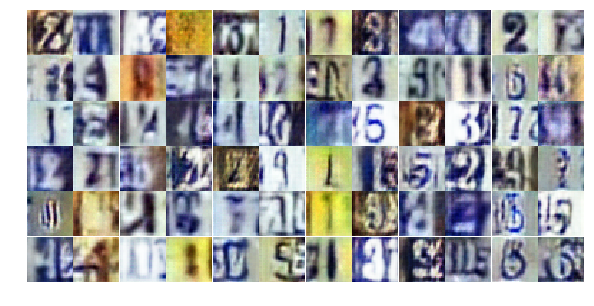

Epoch 9/25... Discriminator Loss: 1.4106... Generator Loss: 0.3779
Epoch 9/25... Discriminator Loss: 0.7841... Generator Loss: 1.1531
Epoch 9/25... Discriminator Loss: 0.4988... Generator Loss: 1.4858
Epoch 9/25... Discriminator Loss: 1.4517... Generator Loss: 0.3782
Epoch 9/25... Discriminator Loss: 0.4796... Generator Loss: 1.5966
Epoch 10/25... Discriminator Loss: 0.4805... Generator Loss: 1.7738
Epoch 10/25... Discriminator Loss: 0.8903... Generator Loss: 0.7344
Epoch 10/25... Discriminator Loss: 0.8690... Generator Loss: 0.7430
Epoch 10/25... Discriminator Loss: 0.6799... Generator Loss: 0.9634
Epoch 10/25... Discriminator Loss: 1.2662... Generator Loss: 0.4378


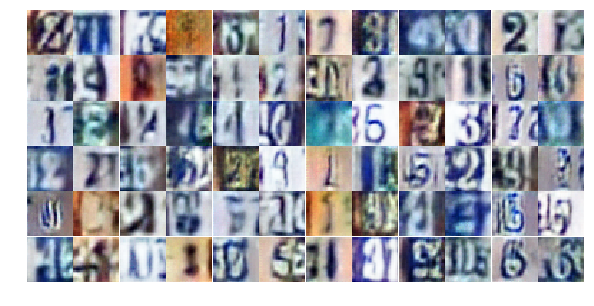

Epoch 10/25... Discriminator Loss: 0.5474... Generator Loss: 1.6956
Epoch 10/25... Discriminator Loss: 0.6886... Generator Loss: 0.9417
Epoch 10/25... Discriminator Loss: 1.2218... Generator Loss: 0.4543
Epoch 10/25... Discriminator Loss: 0.6398... Generator Loss: 1.2882
Epoch 10/25... Discriminator Loss: 0.5112... Generator Loss: 1.3594
Epoch 10/25... Discriminator Loss: 0.7867... Generator Loss: 1.1990
Epoch 10/25... Discriminator Loss: 0.7015... Generator Loss: 0.9177
Epoch 10/25... Discriminator Loss: 0.9291... Generator Loss: 0.7036
Epoch 10/25... Discriminator Loss: 0.5549... Generator Loss: 1.4093
Epoch 10/25... Discriminator Loss: 0.7247... Generator Loss: 1.0222


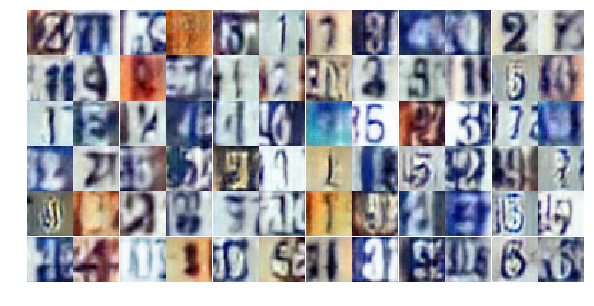

Epoch 10/25... Discriminator Loss: 0.6669... Generator Loss: 1.0689
Epoch 10/25... Discriminator Loss: 1.1470... Generator Loss: 0.5297
Epoch 10/25... Discriminator Loss: 0.6522... Generator Loss: 1.0360
Epoch 10/25... Discriminator Loss: 1.1638... Generator Loss: 0.5164
Epoch 10/25... Discriminator Loss: 0.5427... Generator Loss: 1.9665
Epoch 10/25... Discriminator Loss: 0.5364... Generator Loss: 1.3681
Epoch 10/25... Discriminator Loss: 0.7827... Generator Loss: 0.9000
Epoch 10/25... Discriminator Loss: 0.5954... Generator Loss: 1.0775
Epoch 10/25... Discriminator Loss: 1.2254... Generator Loss: 0.5298
Epoch 10/25... Discriminator Loss: 0.5304... Generator Loss: 1.9127


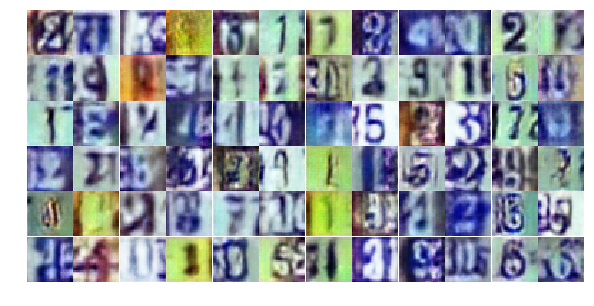

Epoch 10/25... Discriminator Loss: 0.8593... Generator Loss: 0.7728
Epoch 10/25... Discriminator Loss: 0.8759... Generator Loss: 0.7788
Epoch 10/25... Discriminator Loss: 0.4885... Generator Loss: 1.3575
Epoch 10/25... Discriminator Loss: 0.5185... Generator Loss: 1.2880
Epoch 10/25... Discriminator Loss: 1.3353... Generator Loss: 0.4393
Epoch 10/25... Discriminator Loss: 0.7725... Generator Loss: 0.8931
Epoch 10/25... Discriminator Loss: 0.3126... Generator Loss: 1.8168
Epoch 10/25... Discriminator Loss: 0.6071... Generator Loss: 1.5101
Epoch 10/25... Discriminator Loss: 0.5446... Generator Loss: 1.2780
Epoch 10/25... Discriminator Loss: 0.7203... Generator Loss: 0.8715


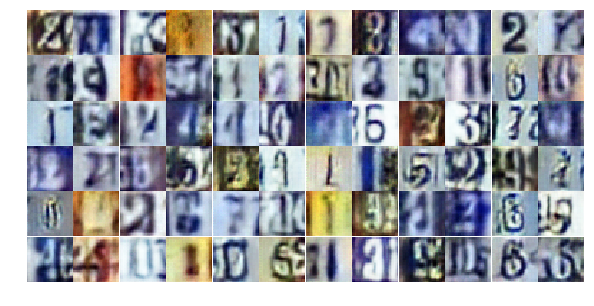

Epoch 10/25... Discriminator Loss: 0.6947... Generator Loss: 0.9760
Epoch 10/25... Discriminator Loss: 0.9451... Generator Loss: 0.8269
Epoch 10/25... Discriminator Loss: 0.6078... Generator Loss: 1.9001
Epoch 10/25... Discriminator Loss: 0.5429... Generator Loss: 1.7849
Epoch 10/25... Discriminator Loss: 0.6793... Generator Loss: 1.0504
Epoch 10/25... Discriminator Loss: 0.7905... Generator Loss: 0.8734
Epoch 10/25... Discriminator Loss: 0.6625... Generator Loss: 1.0748
Epoch 10/25... Discriminator Loss: 1.0411... Generator Loss: 0.6237
Epoch 10/25... Discriminator Loss: 0.7722... Generator Loss: 0.8571
Epoch 10/25... Discriminator Loss: 0.5504... Generator Loss: 2.1022


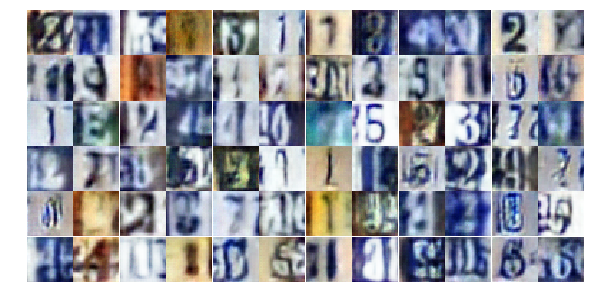

Epoch 10/25... Discriminator Loss: 0.5180... Generator Loss: 1.4696
Epoch 10/25... Discriminator Loss: 0.6785... Generator Loss: 1.0182
Epoch 10/25... Discriminator Loss: 0.9533... Generator Loss: 0.6536
Epoch 10/25... Discriminator Loss: 0.7557... Generator Loss: 0.9287
Epoch 10/25... Discriminator Loss: 0.4911... Generator Loss: 1.8539
Epoch 10/25... Discriminator Loss: 0.5464... Generator Loss: 1.4789
Epoch 10/25... Discriminator Loss: 0.4268... Generator Loss: 1.6738
Epoch 10/25... Discriminator Loss: 0.5399... Generator Loss: 1.5910
Epoch 10/25... Discriminator Loss: 0.6016... Generator Loss: 1.9627
Epoch 10/25... Discriminator Loss: 0.5570... Generator Loss: 1.3420


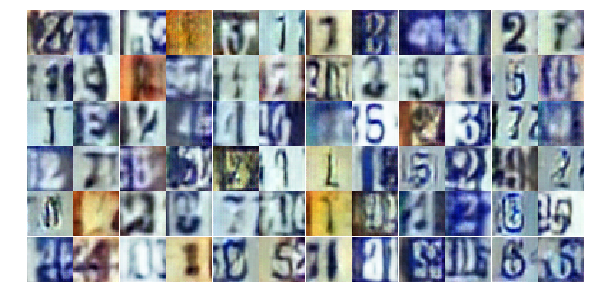

Epoch 10/25... Discriminator Loss: 0.8124... Generator Loss: 0.9169
Epoch 10/25... Discriminator Loss: 0.4273... Generator Loss: 1.5728
Epoch 10/25... Discriminator Loss: 0.5537... Generator Loss: 1.0971
Epoch 11/25... Discriminator Loss: 0.8322... Generator Loss: 0.9717
Epoch 11/25... Discriminator Loss: 0.4041... Generator Loss: 1.7529
Epoch 11/25... Discriminator Loss: 0.9062... Generator Loss: 0.7488
Epoch 11/25... Discriminator Loss: 0.6229... Generator Loss: 1.0027
Epoch 11/25... Discriminator Loss: 0.5942... Generator Loss: 1.2890
Epoch 11/25... Discriminator Loss: 1.8365... Generator Loss: 0.2353
Epoch 11/25... Discriminator Loss: 0.5522... Generator Loss: 1.3836


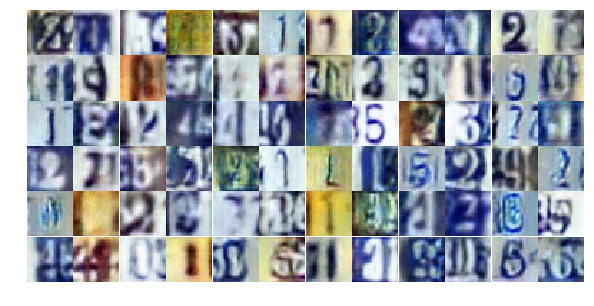

Epoch 11/25... Discriminator Loss: 0.3780... Generator Loss: 1.8582
Epoch 11/25... Discriminator Loss: 0.5875... Generator Loss: 1.2746
Epoch 11/25... Discriminator Loss: 0.5117... Generator Loss: 1.3640
Epoch 11/25... Discriminator Loss: 0.5103... Generator Loss: 1.4586
Epoch 11/25... Discriminator Loss: 0.7670... Generator Loss: 1.1528
Epoch 11/25... Discriminator Loss: 0.3593... Generator Loss: 1.8834
Epoch 11/25... Discriminator Loss: 0.6932... Generator Loss: 1.1800
Epoch 11/25... Discriminator Loss: 0.2828... Generator Loss: 2.2253
Epoch 11/25... Discriminator Loss: 1.0280... Generator Loss: 0.6314
Epoch 11/25... Discriminator Loss: 1.1535... Generator Loss: 0.5049


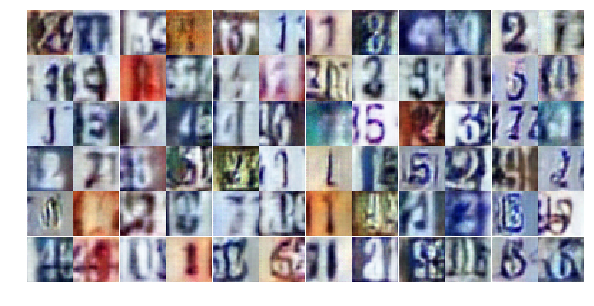

Epoch 11/25... Discriminator Loss: 0.4290... Generator Loss: 1.5879
Epoch 11/25... Discriminator Loss: 0.5272... Generator Loss: 1.8406
Epoch 11/25... Discriminator Loss: 1.0251... Generator Loss: 0.6019
Epoch 11/25... Discriminator Loss: 0.9815... Generator Loss: 0.6660
Epoch 11/25... Discriminator Loss: 0.5225... Generator Loss: 1.8534
Epoch 11/25... Discriminator Loss: 0.4744... Generator Loss: 1.5224
Epoch 11/25... Discriminator Loss: 0.5460... Generator Loss: 1.2064
Epoch 11/25... Discriminator Loss: 0.9173... Generator Loss: 0.7289
Epoch 11/25... Discriminator Loss: 0.4490... Generator Loss: 1.7154
Epoch 11/25... Discriminator Loss: 0.5818... Generator Loss: 1.1408


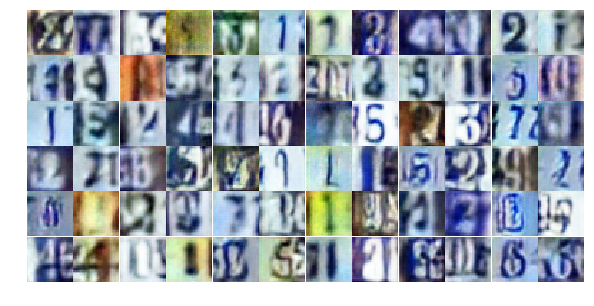

Epoch 11/25... Discriminator Loss: 1.6878... Generator Loss: 0.3549
Epoch 11/25... Discriminator Loss: 0.6687... Generator Loss: 1.4254
Epoch 11/25... Discriminator Loss: 0.8477... Generator Loss: 1.0532
Epoch 11/25... Discriminator Loss: 0.4813... Generator Loss: 1.5294
Epoch 11/25... Discriminator Loss: 0.7747... Generator Loss: 0.8597
Epoch 11/25... Discriminator Loss: 1.2670... Generator Loss: 0.4623
Epoch 11/25... Discriminator Loss: 0.8503... Generator Loss: 0.8144
Epoch 11/25... Discriminator Loss: 1.3423... Generator Loss: 0.4346
Epoch 11/25... Discriminator Loss: 0.5169... Generator Loss: 1.4589
Epoch 11/25... Discriminator Loss: 0.9938... Generator Loss: 0.6463


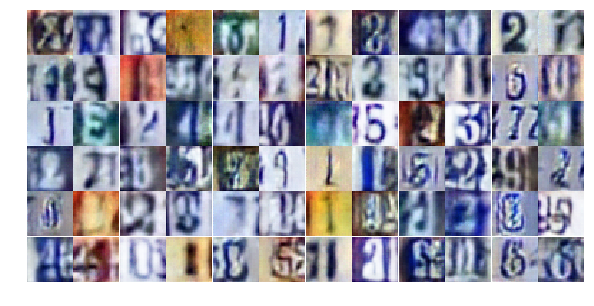

Epoch 11/25... Discriminator Loss: 0.5545... Generator Loss: 1.1840
Epoch 11/25... Discriminator Loss: 0.4698... Generator Loss: 1.3697
Epoch 11/25... Discriminator Loss: 0.7073... Generator Loss: 1.0775
Epoch 11/25... Discriminator Loss: 0.6186... Generator Loss: 1.6285
Epoch 11/25... Discriminator Loss: 1.2174... Generator Loss: 0.4840
Epoch 11/25... Discriminator Loss: 0.7172... Generator Loss: 0.8983
Epoch 11/25... Discriminator Loss: 0.3364... Generator Loss: 2.0096
Epoch 11/25... Discriminator Loss: 0.6635... Generator Loss: 1.0428
Epoch 11/25... Discriminator Loss: 1.4381... Generator Loss: 0.3834
Epoch 11/25... Discriminator Loss: 0.7235... Generator Loss: 0.9782


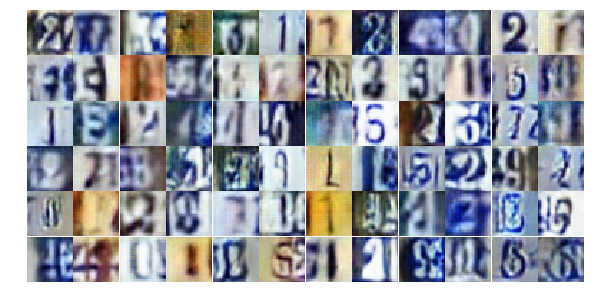

Epoch 11/25... Discriminator Loss: 0.6551... Generator Loss: 1.3135
Epoch 11/25... Discriminator Loss: 0.3474... Generator Loss: 2.1388
Epoch 11/25... Discriminator Loss: 0.5645... Generator Loss: 1.8184
Epoch 11/25... Discriminator Loss: 0.5180... Generator Loss: 2.4366
Epoch 11/25... Discriminator Loss: 1.0832... Generator Loss: 0.5642
Epoch 11/25... Discriminator Loss: 0.6768... Generator Loss: 0.9956
Epoch 11/25... Discriminator Loss: 1.2879... Generator Loss: 0.5791
Epoch 11/25... Discriminator Loss: 0.5628... Generator Loss: 1.4235
Epoch 11/25... Discriminator Loss: 1.2691... Generator Loss: 0.4915
Epoch 11/25... Discriminator Loss: 0.9939... Generator Loss: 0.6964


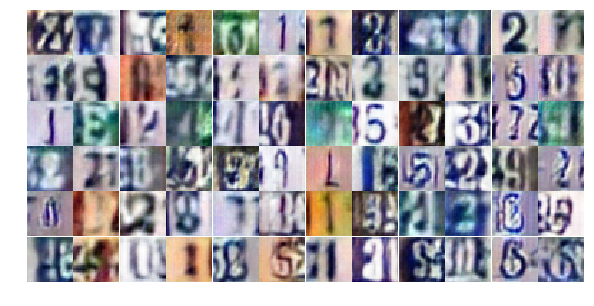

Epoch 12/25... Discriminator Loss: 0.7780... Generator Loss: 0.9967
Epoch 12/25... Discriminator Loss: 0.5904... Generator Loss: 1.2762
Epoch 12/25... Discriminator Loss: 0.9471... Generator Loss: 0.7344
Epoch 12/25... Discriminator Loss: 0.5068... Generator Loss: 1.5363
Epoch 12/25... Discriminator Loss: 0.5925... Generator Loss: 1.0932
Epoch 12/25... Discriminator Loss: 0.9392... Generator Loss: 0.6991
Epoch 12/25... Discriminator Loss: 0.9794... Generator Loss: 3.3198
Epoch 12/25... Discriminator Loss: 1.0000... Generator Loss: 0.6996
Epoch 12/25... Discriminator Loss: 0.8092... Generator Loss: 0.8682
Epoch 12/25... Discriminator Loss: 0.9222... Generator Loss: 0.7812


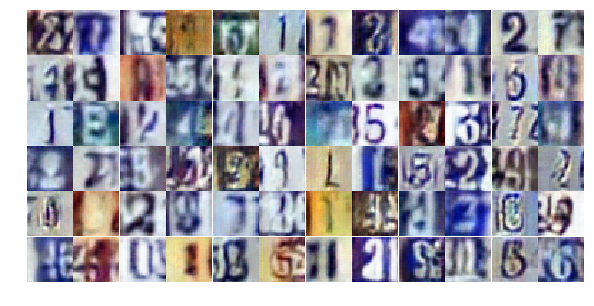

Epoch 12/25... Discriminator Loss: 0.4768... Generator Loss: 1.5859
Epoch 12/25... Discriminator Loss: 0.8816... Generator Loss: 0.7643
Epoch 12/25... Discriminator Loss: 0.5630... Generator Loss: 1.1647
Epoch 12/25... Discriminator Loss: 0.5575... Generator Loss: 1.5800
Epoch 12/25... Discriminator Loss: 0.5087... Generator Loss: 1.6866
Epoch 12/25... Discriminator Loss: 1.3676... Generator Loss: 0.4422
Epoch 12/25... Discriminator Loss: 1.8200... Generator Loss: 0.2571
Epoch 12/25... Discriminator Loss: 0.5054... Generator Loss: 1.5943
Epoch 12/25... Discriminator Loss: 0.6155... Generator Loss: 1.1618
Epoch 12/25... Discriminator Loss: 0.9720... Generator Loss: 0.6566


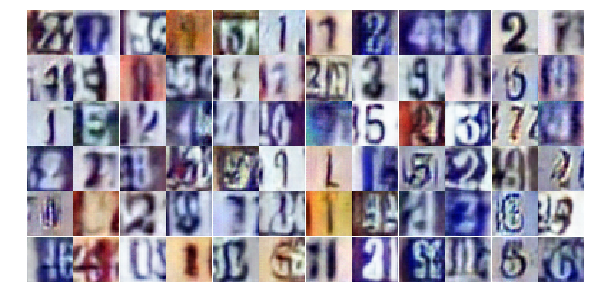

Epoch 12/25... Discriminator Loss: 0.2795... Generator Loss: 2.1778
Epoch 12/25... Discriminator Loss: 0.4758... Generator Loss: 1.3204
Epoch 12/25... Discriminator Loss: 0.7107... Generator Loss: 0.9326
Epoch 12/25... Discriminator Loss: 0.3350... Generator Loss: 1.8655
Epoch 12/25... Discriminator Loss: 0.3705... Generator Loss: 1.9312
Epoch 12/25... Discriminator Loss: 0.4910... Generator Loss: 1.3447
Epoch 12/25... Discriminator Loss: 0.5816... Generator Loss: 1.4132
Epoch 12/25... Discriminator Loss: 0.3230... Generator Loss: 2.1700
Epoch 12/25... Discriminator Loss: 0.4503... Generator Loss: 1.8451
Epoch 12/25... Discriminator Loss: 0.4547... Generator Loss: 1.6231


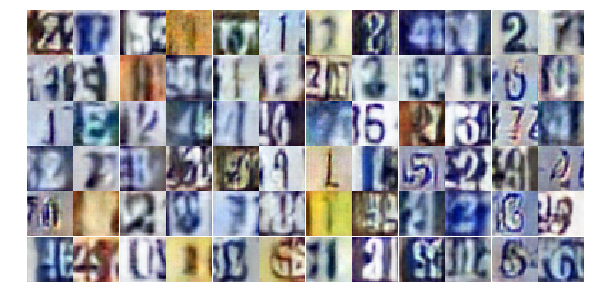

Epoch 12/25... Discriminator Loss: 0.6096... Generator Loss: 1.0959
Epoch 12/25... Discriminator Loss: 0.5952... Generator Loss: 1.0976
Epoch 12/25... Discriminator Loss: 0.6853... Generator Loss: 1.0485
Epoch 12/25... Discriminator Loss: 1.4397... Generator Loss: 0.3783
Epoch 12/25... Discriminator Loss: 0.6894... Generator Loss: 1.0599
Epoch 12/25... Discriminator Loss: 0.8083... Generator Loss: 0.9365
Epoch 12/25... Discriminator Loss: 1.0640... Generator Loss: 0.5975
Epoch 12/25... Discriminator Loss: 0.5659... Generator Loss: 1.5102
Epoch 12/25... Discriminator Loss: 0.5474... Generator Loss: 1.3479
Epoch 12/25... Discriminator Loss: 0.4387... Generator Loss: 1.5110


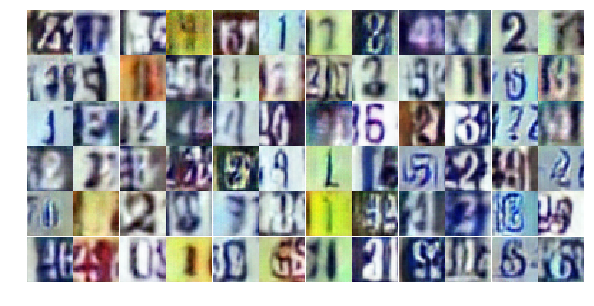

Epoch 12/25... Discriminator Loss: 0.5500... Generator Loss: 1.3404
Epoch 12/25... Discriminator Loss: 0.3874... Generator Loss: 2.0045
Epoch 12/25... Discriminator Loss: 0.4063... Generator Loss: 1.7343
Epoch 12/25... Discriminator Loss: 0.7349... Generator Loss: 0.9759
Epoch 12/25... Discriminator Loss: 0.7875... Generator Loss: 0.8363
Epoch 12/25... Discriminator Loss: 1.2476... Generator Loss: 0.4728
Epoch 12/25... Discriminator Loss: 0.6893... Generator Loss: 1.1143
Epoch 12/25... Discriminator Loss: 0.5859... Generator Loss: 2.1381
Epoch 12/25... Discriminator Loss: 0.4881... Generator Loss: 1.3911
Epoch 12/25... Discriminator Loss: 0.6387... Generator Loss: 1.0036


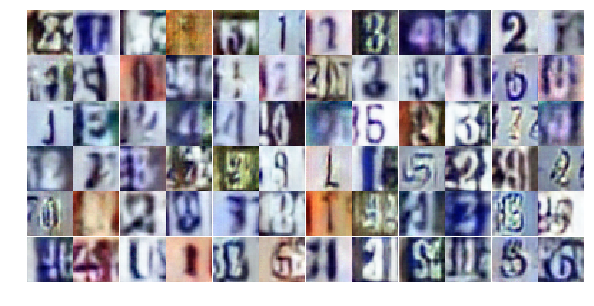

Epoch 12/25... Discriminator Loss: 0.9435... Generator Loss: 0.7909
Epoch 12/25... Discriminator Loss: 0.6950... Generator Loss: 1.2442
Epoch 12/25... Discriminator Loss: 0.7064... Generator Loss: 1.0623
Epoch 12/25... Discriminator Loss: 1.0138... Generator Loss: 0.6940
Epoch 12/25... Discriminator Loss: 0.5795... Generator Loss: 1.3831
Epoch 12/25... Discriminator Loss: 0.5085... Generator Loss: 1.4931
Epoch 12/25... Discriminator Loss: 0.9132... Generator Loss: 0.6917
Epoch 13/25... Discriminator Loss: 0.4886... Generator Loss: 1.3319
Epoch 13/25... Discriminator Loss: 0.4829... Generator Loss: 1.4333
Epoch 13/25... Discriminator Loss: 1.0110... Generator Loss: 0.6398


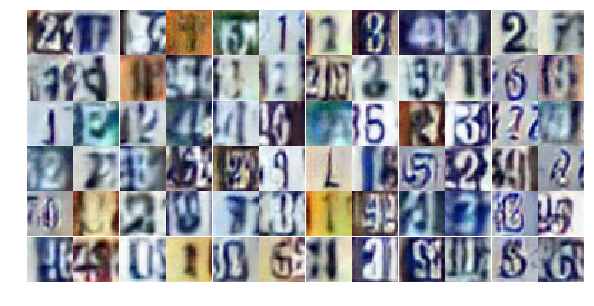

Epoch 13/25... Discriminator Loss: 0.4598... Generator Loss: 1.6657
Epoch 13/25... Discriminator Loss: 0.5474... Generator Loss: 2.4827
Epoch 13/25... Discriminator Loss: 1.4476... Generator Loss: 0.3886
Epoch 13/25... Discriminator Loss: 1.0721... Generator Loss: 0.7744
Epoch 13/25... Discriminator Loss: 0.7853... Generator Loss: 0.8772
Epoch 13/25... Discriminator Loss: 0.5523... Generator Loss: 1.5440
Epoch 13/25... Discriminator Loss: 0.3840... Generator Loss: 1.7997
Epoch 13/25... Discriminator Loss: 0.7639... Generator Loss: 0.8164
Epoch 13/25... Discriminator Loss: 0.6449... Generator Loss: 1.1073
Epoch 13/25... Discriminator Loss: 0.4060... Generator Loss: 1.9256


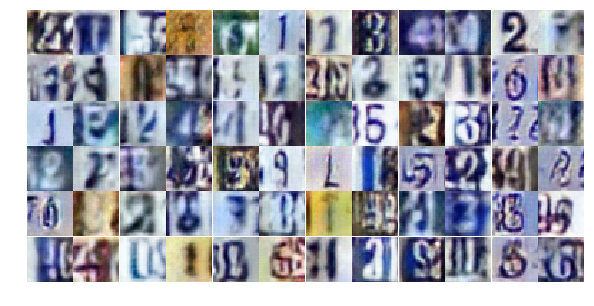

Epoch 13/25... Discriminator Loss: 0.5117... Generator Loss: 1.5747
Epoch 13/25... Discriminator Loss: 0.4448... Generator Loss: 1.4518
Epoch 13/25... Discriminator Loss: 5.2610... Generator Loss: 7.0189
Epoch 13/25... Discriminator Loss: 0.9175... Generator Loss: 1.1159
Epoch 13/25... Discriminator Loss: 0.6134... Generator Loss: 1.2975
Epoch 13/25... Discriminator Loss: 0.9139... Generator Loss: 0.7951
Epoch 13/25... Discriminator Loss: 0.7474... Generator Loss: 1.0833
Epoch 13/25... Discriminator Loss: 0.9565... Generator Loss: 0.7524
Epoch 13/25... Discriminator Loss: 0.5739... Generator Loss: 1.1743
Epoch 13/25... Discriminator Loss: 0.9285... Generator Loss: 0.6652


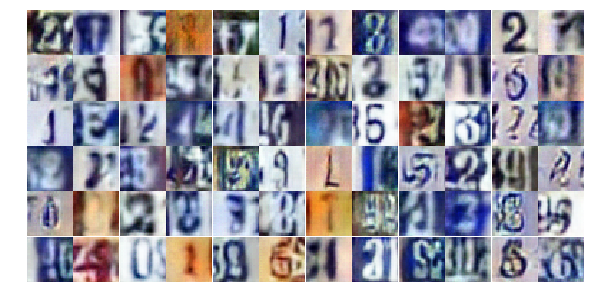

Epoch 13/25... Discriminator Loss: 0.6344... Generator Loss: 1.2311
Epoch 13/25... Discriminator Loss: 0.5552... Generator Loss: 1.6609
Epoch 13/25... Discriminator Loss: 1.0264... Generator Loss: 2.1501
Epoch 13/25... Discriminator Loss: 0.7025... Generator Loss: 1.0607
Epoch 13/25... Discriminator Loss: 0.6984... Generator Loss: 0.9173
Epoch 13/25... Discriminator Loss: 0.7025... Generator Loss: 1.0356
Epoch 13/25... Discriminator Loss: 0.8429... Generator Loss: 1.4065
Epoch 13/25... Discriminator Loss: 0.5721... Generator Loss: 1.2845
Epoch 13/25... Discriminator Loss: 0.4053... Generator Loss: 1.6232
Epoch 13/25... Discriminator Loss: 0.5548... Generator Loss: 1.3200


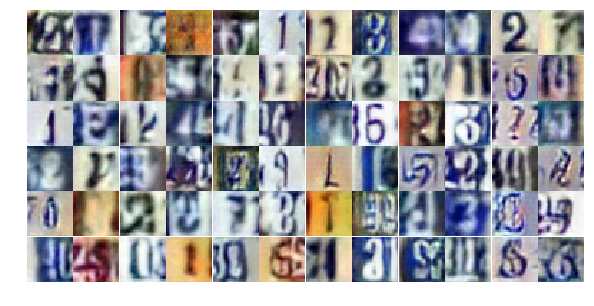

Epoch 13/25... Discriminator Loss: 0.8198... Generator Loss: 0.7854
Epoch 13/25... Discriminator Loss: 0.7901... Generator Loss: 0.8365
Epoch 13/25... Discriminator Loss: 1.0970... Generator Loss: 0.5539
Epoch 13/25... Discriminator Loss: 1.1192... Generator Loss: 0.5384
Epoch 13/25... Discriminator Loss: 0.6479... Generator Loss: 1.2007
Epoch 13/25... Discriminator Loss: 0.4462... Generator Loss: 1.8289
Epoch 13/25... Discriminator Loss: 0.6368... Generator Loss: 1.0865
Epoch 13/25... Discriminator Loss: 0.7590... Generator Loss: 1.0576
Epoch 13/25... Discriminator Loss: 0.6070... Generator Loss: 1.2437
Epoch 13/25... Discriminator Loss: 0.7413... Generator Loss: 0.9231


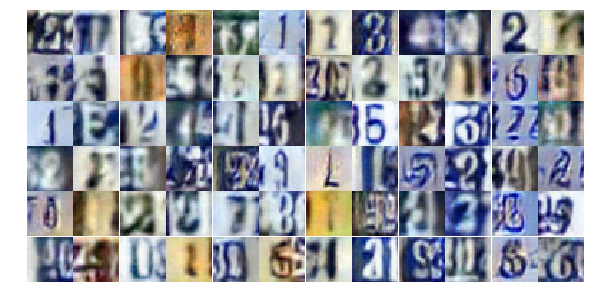

Epoch 13/25... Discriminator Loss: 0.5791... Generator Loss: 1.4809
Epoch 13/25... Discriminator Loss: 0.7204... Generator Loss: 1.0948
Epoch 13/25... Discriminator Loss: 0.7028... Generator Loss: 0.9834
Epoch 13/25... Discriminator Loss: 0.6434... Generator Loss: 0.9825
Epoch 13/25... Discriminator Loss: 1.0716... Generator Loss: 0.5815
Epoch 13/25... Discriminator Loss: 0.6846... Generator Loss: 1.5382
Epoch 13/25... Discriminator Loss: 0.8136... Generator Loss: 0.8825
Epoch 13/25... Discriminator Loss: 0.8229... Generator Loss: 0.8016
Epoch 13/25... Discriminator Loss: 0.7189... Generator Loss: 0.9453
Epoch 13/25... Discriminator Loss: 0.8258... Generator Loss: 0.8452


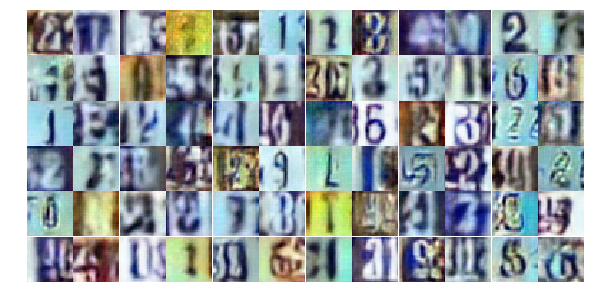

Epoch 13/25... Discriminator Loss: 0.3656... Generator Loss: 1.8438
Epoch 13/25... Discriminator Loss: 1.4696... Generator Loss: 0.3946
Epoch 13/25... Discriminator Loss: 0.7951... Generator Loss: 0.8991
Epoch 13/25... Discriminator Loss: 1.1261... Generator Loss: 0.5434
Epoch 14/25... Discriminator Loss: 0.5507... Generator Loss: 1.3134
Epoch 14/25... Discriminator Loss: 0.6143... Generator Loss: 1.2495
Epoch 14/25... Discriminator Loss: 0.9586... Generator Loss: 0.8332
Epoch 14/25... Discriminator Loss: 0.6587... Generator Loss: 1.8523
Epoch 14/25... Discriminator Loss: 0.5677... Generator Loss: 1.4121
Epoch 14/25... Discriminator Loss: 0.8399... Generator Loss: 0.7763


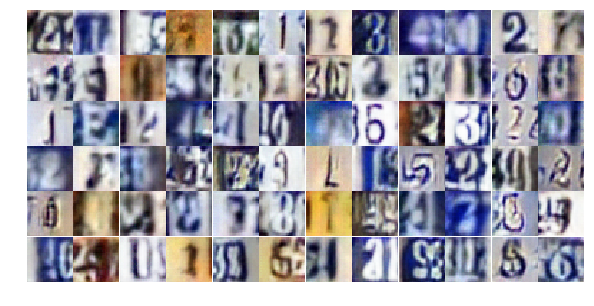

Epoch 14/25... Discriminator Loss: 1.4782... Generator Loss: 3.9188
Epoch 14/25... Discriminator Loss: 1.3581... Generator Loss: 0.4124
Epoch 14/25... Discriminator Loss: 0.7989... Generator Loss: 0.9615
Epoch 14/25... Discriminator Loss: 0.5999... Generator Loss: 1.1784
Epoch 14/25... Discriminator Loss: 1.4282... Generator Loss: 0.4117
Epoch 14/25... Discriminator Loss: 0.4308... Generator Loss: 1.3639
Epoch 14/25... Discriminator Loss: 0.3855... Generator Loss: 1.7235
Epoch 14/25... Discriminator Loss: 1.4185... Generator Loss: 0.3499
Epoch 14/25... Discriminator Loss: 0.8314... Generator Loss: 1.1822
Epoch 14/25... Discriminator Loss: 1.2821... Generator Loss: 0.4923


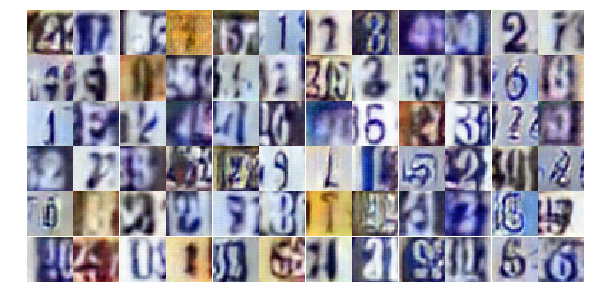

Epoch 14/25... Discriminator Loss: 0.5627... Generator Loss: 1.1002
Epoch 14/25... Discriminator Loss: 0.6720... Generator Loss: 2.5145
Epoch 14/25... Discriminator Loss: 1.0616... Generator Loss: 0.5971
Epoch 14/25... Discriminator Loss: 0.5134... Generator Loss: 1.3695
Epoch 14/25... Discriminator Loss: 0.8838... Generator Loss: 0.7884
Epoch 14/25... Discriminator Loss: 0.7865... Generator Loss: 1.2617
Epoch 14/25... Discriminator Loss: 1.2245... Generator Loss: 0.5233
Epoch 14/25... Discriminator Loss: 0.6647... Generator Loss: 1.1976
Epoch 14/25... Discriminator Loss: 0.7978... Generator Loss: 0.9084
Epoch 14/25... Discriminator Loss: 0.3415... Generator Loss: 1.9781


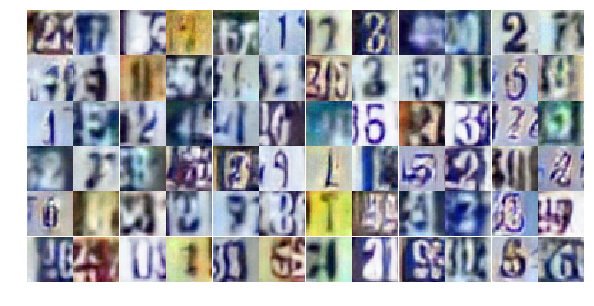

Epoch 14/25... Discriminator Loss: 1.4100... Generator Loss: 0.3881
Epoch 14/25... Discriminator Loss: 0.6345... Generator Loss: 1.0855
Epoch 14/25... Discriminator Loss: 0.5530... Generator Loss: 1.1464
Epoch 14/25... Discriminator Loss: 0.5708... Generator Loss: 1.0781
Epoch 14/25... Discriminator Loss: 0.5143... Generator Loss: 1.4111
Epoch 14/25... Discriminator Loss: 0.6824... Generator Loss: 1.0828
Epoch 14/25... Discriminator Loss: 0.7672... Generator Loss: 0.9485
Epoch 14/25... Discriminator Loss: 0.3013... Generator Loss: 2.0266
Epoch 14/25... Discriminator Loss: 0.3444... Generator Loss: 1.8164
Epoch 14/25... Discriminator Loss: 0.7379... Generator Loss: 0.9500


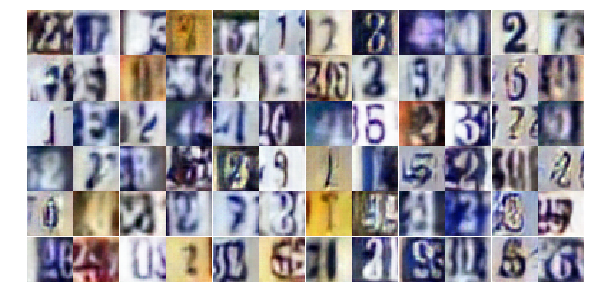

Epoch 14/25... Discriminator Loss: 1.2015... Generator Loss: 0.5212
Epoch 14/25... Discriminator Loss: 0.7948... Generator Loss: 0.9723
Epoch 14/25... Discriminator Loss: 0.9349... Generator Loss: 0.7355
Epoch 14/25... Discriminator Loss: 0.7253... Generator Loss: 0.8965
Epoch 14/25... Discriminator Loss: 0.9310... Generator Loss: 0.6589
Epoch 14/25... Discriminator Loss: 0.6526... Generator Loss: 1.1590
Epoch 14/25... Discriminator Loss: 1.2744... Generator Loss: 3.7495
Epoch 14/25... Discriminator Loss: 0.4220... Generator Loss: 1.6366
Epoch 14/25... Discriminator Loss: 1.7876... Generator Loss: 0.3201
Epoch 14/25... Discriminator Loss: 1.6888... Generator Loss: 0.3417


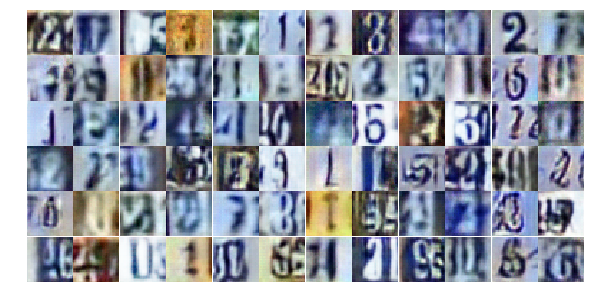

Epoch 14/25... Discriminator Loss: 1.0159... Generator Loss: 0.6699
Epoch 14/25... Discriminator Loss: 1.3036... Generator Loss: 0.4535
Epoch 14/25... Discriminator Loss: 0.5312... Generator Loss: 1.2816
Epoch 14/25... Discriminator Loss: 1.0405... Generator Loss: 0.6587
Epoch 14/25... Discriminator Loss: 0.5559... Generator Loss: 1.2684
Epoch 14/25... Discriminator Loss: 0.4278... Generator Loss: 1.4120
Epoch 14/25... Discriminator Loss: 0.6131... Generator Loss: 1.4333
Epoch 14/25... Discriminator Loss: 0.6337... Generator Loss: 1.0936
Epoch 14/25... Discriminator Loss: 1.0472... Generator Loss: 0.5792
Epoch 14/25... Discriminator Loss: 0.9667... Generator Loss: 0.6576


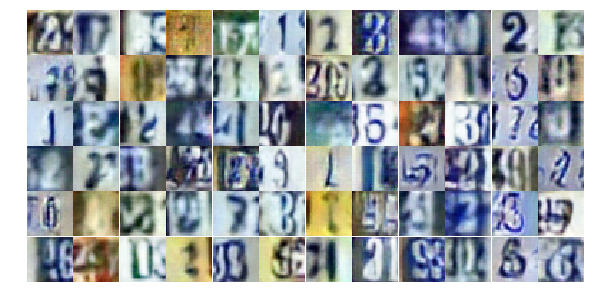

Epoch 14/25... Discriminator Loss: 1.2061... Generator Loss: 0.5509
Epoch 14/25... Discriminator Loss: 1.0996... Generator Loss: 0.5888
Epoch 15/25... Discriminator Loss: 0.6712... Generator Loss: 1.0079
Epoch 15/25... Discriminator Loss: 0.5169... Generator Loss: 1.4447
Epoch 15/25... Discriminator Loss: 0.4960... Generator Loss: 1.6101
Epoch 15/25... Discriminator Loss: 0.7969... Generator Loss: 0.8774
Epoch 15/25... Discriminator Loss: 0.7289... Generator Loss: 0.8983
Epoch 15/25... Discriminator Loss: 1.4724... Generator Loss: 0.3625
Epoch 15/25... Discriminator Loss: 1.1101... Generator Loss: 0.7371
Epoch 15/25... Discriminator Loss: 0.6245... Generator Loss: 1.0911


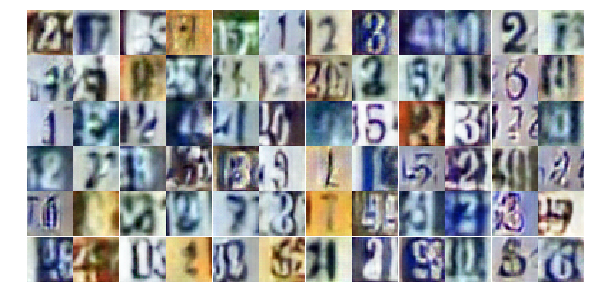

Epoch 15/25... Discriminator Loss: 0.7123... Generator Loss: 1.0309
Epoch 15/25... Discriminator Loss: 0.7537... Generator Loss: 1.3073
Epoch 15/25... Discriminator Loss: 0.7123... Generator Loss: 1.0321
Epoch 15/25... Discriminator Loss: 0.7109... Generator Loss: 1.0954
Epoch 15/25... Discriminator Loss: 0.9084... Generator Loss: 0.8345
Epoch 15/25... Discriminator Loss: 0.4950... Generator Loss: 1.5206
Epoch 15/25... Discriminator Loss: 0.8611... Generator Loss: 0.7049
Epoch 15/25... Discriminator Loss: 0.6565... Generator Loss: 1.6558
Epoch 15/25... Discriminator Loss: 1.1469... Generator Loss: 3.4268
Epoch 15/25... Discriminator Loss: 1.2710... Generator Loss: 0.5090


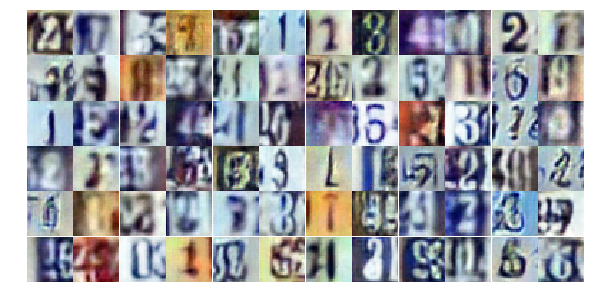

Epoch 15/25... Discriminator Loss: 0.9567... Generator Loss: 0.6611
Epoch 15/25... Discriminator Loss: 0.5326... Generator Loss: 1.3898
Epoch 15/25... Discriminator Loss: 0.5662... Generator Loss: 1.2896
Epoch 15/25... Discriminator Loss: 0.8970... Generator Loss: 0.7451
Epoch 15/25... Discriminator Loss: 0.8432... Generator Loss: 1.1768
Epoch 15/25... Discriminator Loss: 0.6043... Generator Loss: 1.3778
Epoch 15/25... Discriminator Loss: 0.9671... Generator Loss: 0.8059
Epoch 15/25... Discriminator Loss: 0.8336... Generator Loss: 0.8250
Epoch 15/25... Discriminator Loss: 0.6937... Generator Loss: 0.9758
Epoch 15/25... Discriminator Loss: 1.5537... Generator Loss: 0.3719


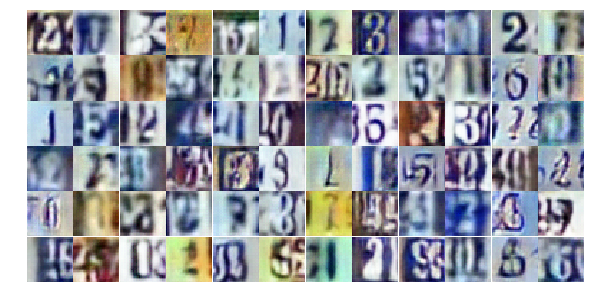

Epoch 15/25... Discriminator Loss: 1.4480... Generator Loss: 0.4556
Epoch 15/25... Discriminator Loss: 0.7339... Generator Loss: 1.0019
Epoch 15/25... Discriminator Loss: 0.4654... Generator Loss: 1.4588
Epoch 15/25... Discriminator Loss: 0.5892... Generator Loss: 1.8490
Epoch 15/25... Discriminator Loss: 0.6454... Generator Loss: 1.0575
Epoch 15/25... Discriminator Loss: 1.0171... Generator Loss: 1.6851
Epoch 15/25... Discriminator Loss: 0.6212... Generator Loss: 1.2281
Epoch 15/25... Discriminator Loss: 0.8264... Generator Loss: 0.8318
Epoch 15/25... Discriminator Loss: 0.5934... Generator Loss: 1.1837
Epoch 15/25... Discriminator Loss: 0.7185... Generator Loss: 0.9599


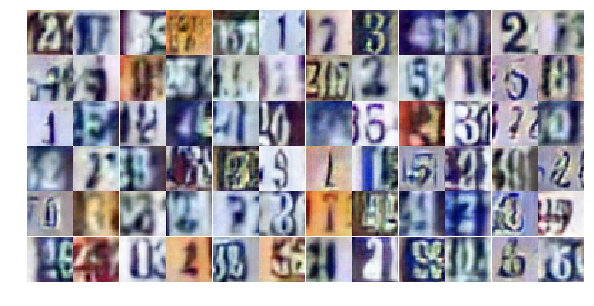

Epoch 15/25... Discriminator Loss: 0.4039... Generator Loss: 1.6315
Epoch 15/25... Discriminator Loss: 1.1848... Generator Loss: 0.5544
Epoch 15/25... Discriminator Loss: 0.5641... Generator Loss: 1.5303
Epoch 15/25... Discriminator Loss: 0.4898... Generator Loss: 1.5086
Epoch 15/25... Discriminator Loss: 0.4469... Generator Loss: 1.4974
Epoch 15/25... Discriminator Loss: 1.7982... Generator Loss: 0.3262
Epoch 15/25... Discriminator Loss: 0.8179... Generator Loss: 0.8860
Epoch 15/25... Discriminator Loss: 0.9260... Generator Loss: 1.0061
Epoch 15/25... Discriminator Loss: 0.6644... Generator Loss: 1.0215
Epoch 15/25... Discriminator Loss: 0.9024... Generator Loss: 0.7796


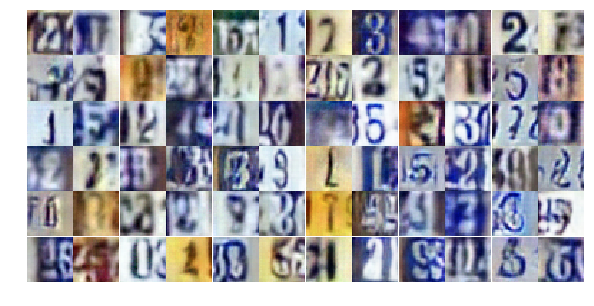

Epoch 15/25... Discriminator Loss: 0.8720... Generator Loss: 0.7726
Epoch 15/25... Discriminator Loss: 0.7262... Generator Loss: 1.0658
Epoch 15/25... Discriminator Loss: 0.4991... Generator Loss: 1.6802
Epoch 15/25... Discriminator Loss: 1.5374... Generator Loss: 0.3647
Epoch 15/25... Discriminator Loss: 0.7009... Generator Loss: 1.3954
Epoch 15/25... Discriminator Loss: 0.6838... Generator Loss: 1.1323
Epoch 15/25... Discriminator Loss: 0.7747... Generator Loss: 0.8043
Epoch 15/25... Discriminator Loss: 0.3270... Generator Loss: 1.9318
Epoch 15/25... Discriminator Loss: 1.3166... Generator Loss: 0.4380
Epoch 16/25... Discriminator Loss: 1.2075... Generator Loss: 0.5259


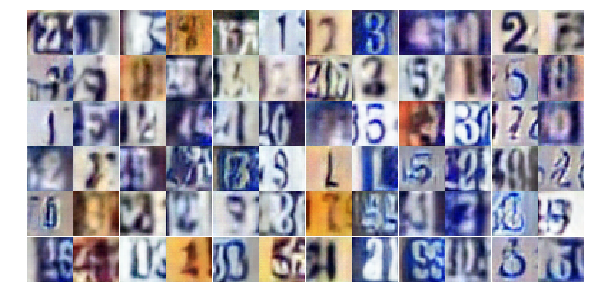

Epoch 16/25... Discriminator Loss: 0.5770... Generator Loss: 1.2112
Epoch 16/25... Discriminator Loss: 0.9022... Generator Loss: 0.7459
Epoch 16/25... Discriminator Loss: 1.7655... Generator Loss: 0.2772
Epoch 16/25... Discriminator Loss: 0.5620... Generator Loss: 1.3452
Epoch 16/25... Discriminator Loss: 0.6719... Generator Loss: 1.0529
Epoch 16/25... Discriminator Loss: 0.6723... Generator Loss: 1.0931
Epoch 16/25... Discriminator Loss: 1.7319... Generator Loss: 0.2701
Epoch 16/25... Discriminator Loss: 0.9678... Generator Loss: 0.6671
Epoch 16/25... Discriminator Loss: 0.5906... Generator Loss: 1.2227
Epoch 16/25... Discriminator Loss: 0.4677... Generator Loss: 1.2943


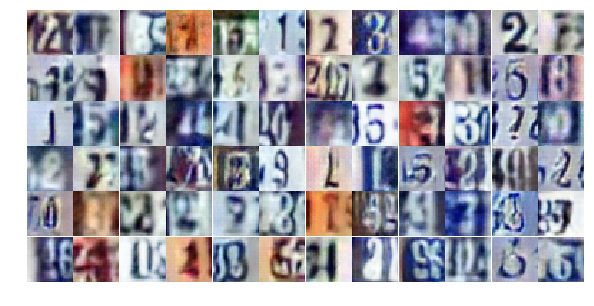

Epoch 16/25... Discriminator Loss: 1.2221... Generator Loss: 0.5609
Epoch 16/25... Discriminator Loss: 0.5836... Generator Loss: 1.3170
Epoch 16/25... Discriminator Loss: 0.5321... Generator Loss: 1.4857
Epoch 16/25... Discriminator Loss: 1.4968... Generator Loss: 0.3373
Epoch 16/25... Discriminator Loss: 0.6958... Generator Loss: 2.0672
Epoch 16/25... Discriminator Loss: 1.3068... Generator Loss: 0.4375
Epoch 16/25... Discriminator Loss: 1.0755... Generator Loss: 0.6301
Epoch 16/25... Discriminator Loss: 0.4538... Generator Loss: 1.7103
Epoch 16/25... Discriminator Loss: 0.5637... Generator Loss: 1.2451
Epoch 16/25... Discriminator Loss: 0.7812... Generator Loss: 0.9024


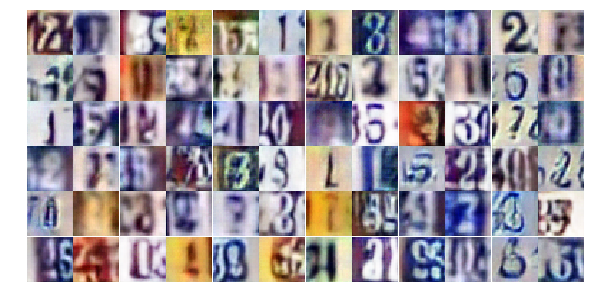

Epoch 16/25... Discriminator Loss: 0.6741... Generator Loss: 1.1864
Epoch 16/25... Discriminator Loss: 0.6509... Generator Loss: 1.0357
Epoch 16/25... Discriminator Loss: 0.8150... Generator Loss: 0.8441
Epoch 16/25... Discriminator Loss: 1.2383... Generator Loss: 0.5065
Epoch 16/25... Discriminator Loss: 1.0790... Generator Loss: 0.5695
Epoch 16/25... Discriminator Loss: 1.1524... Generator Loss: 0.5057
Epoch 16/25... Discriminator Loss: 1.0021... Generator Loss: 0.6342
Epoch 16/25... Discriminator Loss: 0.4434... Generator Loss: 1.4214
Epoch 16/25... Discriminator Loss: 0.8915... Generator Loss: 1.1126
Epoch 16/25... Discriminator Loss: 0.6113... Generator Loss: 1.0239


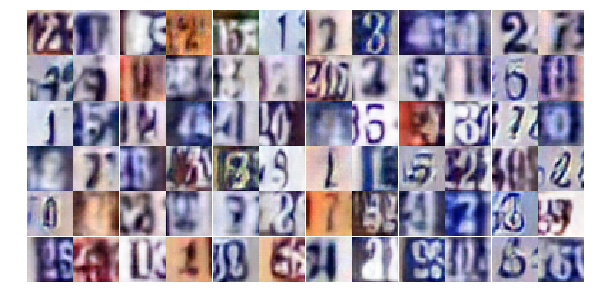

Epoch 16/25... Discriminator Loss: 0.7403... Generator Loss: 0.8863
Epoch 16/25... Discriminator Loss: 0.5583... Generator Loss: 1.2159
Epoch 16/25... Discriminator Loss: 0.5430... Generator Loss: 1.5550
Epoch 16/25... Discriminator Loss: 0.6452... Generator Loss: 1.3613
Epoch 16/25... Discriminator Loss: 1.3590... Generator Loss: 0.4229
Epoch 16/25... Discriminator Loss: 0.6689... Generator Loss: 1.5034
Epoch 16/25... Discriminator Loss: 1.3489... Generator Loss: 0.4688
Epoch 16/25... Discriminator Loss: 1.2251... Generator Loss: 0.4805
Epoch 16/25... Discriminator Loss: 0.7051... Generator Loss: 0.9646
Epoch 16/25... Discriminator Loss: 0.5884... Generator Loss: 1.3059


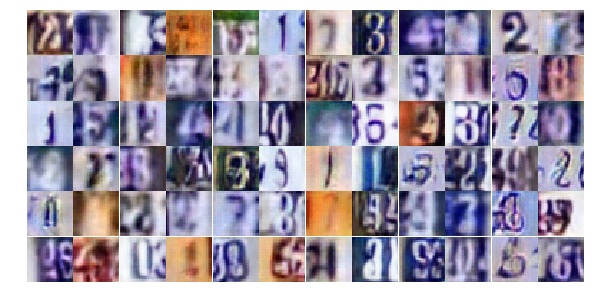

Epoch 16/25... Discriminator Loss: 0.5015... Generator Loss: 1.3360
Epoch 16/25... Discriminator Loss: 0.4916... Generator Loss: 1.5826
Epoch 16/25... Discriminator Loss: 1.4161... Generator Loss: 0.4859
Epoch 16/25... Discriminator Loss: 0.8487... Generator Loss: 1.3631
Epoch 16/25... Discriminator Loss: 0.7738... Generator Loss: 0.9102
Epoch 16/25... Discriminator Loss: 0.9466... Generator Loss: 0.7506
Epoch 16/25... Discriminator Loss: 0.6495... Generator Loss: 1.1265
Epoch 16/25... Discriminator Loss: 0.6669... Generator Loss: 1.0505
Epoch 16/25... Discriminator Loss: 0.4554... Generator Loss: 1.4156
Epoch 16/25... Discriminator Loss: 0.7440... Generator Loss: 0.9721


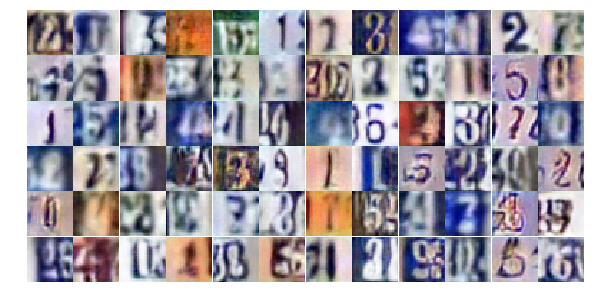

Epoch 16/25... Discriminator Loss: 1.3638... Generator Loss: 0.4148
Epoch 16/25... Discriminator Loss: 0.6522... Generator Loss: 1.3071
Epoch 16/25... Discriminator Loss: 2.2933... Generator Loss: 0.1661
Epoch 16/25... Discriminator Loss: 0.4007... Generator Loss: 1.7201
Epoch 16/25... Discriminator Loss: 0.6721... Generator Loss: 1.2941
Epoch 16/25... Discriminator Loss: 0.5460... Generator Loss: 1.1970
Epoch 17/25... Discriminator Loss: 0.6634... Generator Loss: 1.1620
Epoch 17/25... Discriminator Loss: 0.8302... Generator Loss: 0.8478
Epoch 17/25... Discriminator Loss: 0.7577... Generator Loss: 0.9937
Epoch 17/25... Discriminator Loss: 0.6602... Generator Loss: 1.0797


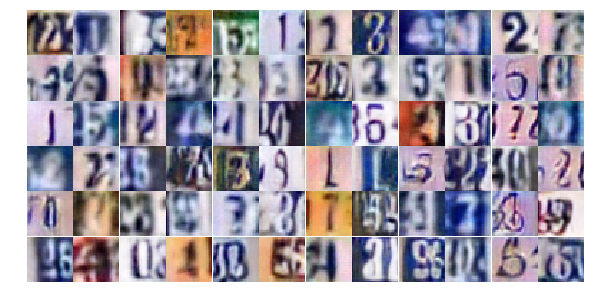

Epoch 17/25... Discriminator Loss: 0.5236... Generator Loss: 1.4008
Epoch 17/25... Discriminator Loss: 0.8332... Generator Loss: 0.7912
Epoch 17/25... Discriminator Loss: 0.7714... Generator Loss: 1.1011
Epoch 17/25... Discriminator Loss: 0.5151... Generator Loss: 1.5506
Epoch 17/25... Discriminator Loss: 0.8932... Generator Loss: 0.7730
Epoch 17/25... Discriminator Loss: 1.1100... Generator Loss: 0.6331
Epoch 17/25... Discriminator Loss: 0.8197... Generator Loss: 1.6469
Epoch 17/25... Discriminator Loss: 0.7251... Generator Loss: 0.9150
Epoch 17/25... Discriminator Loss: 0.4911... Generator Loss: 1.3941
Epoch 17/25... Discriminator Loss: 0.6061... Generator Loss: 1.5838


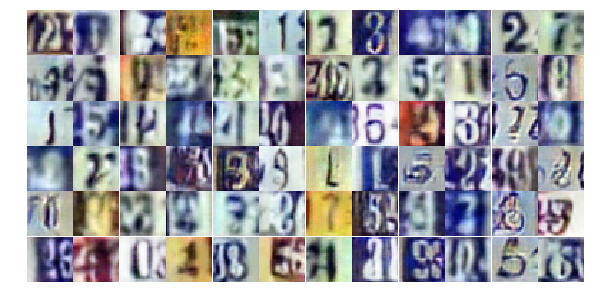

Epoch 17/25... Discriminator Loss: 1.1957... Generator Loss: 2.8631
Epoch 17/25... Discriminator Loss: 0.7451... Generator Loss: 0.9896
Epoch 17/25... Discriminator Loss: 0.7750... Generator Loss: 0.8583
Epoch 17/25... Discriminator Loss: 0.5815... Generator Loss: 1.3508
Epoch 17/25... Discriminator Loss: 0.6742... Generator Loss: 1.4931
Epoch 17/25... Discriminator Loss: 1.2363... Generator Loss: 0.5264
Epoch 17/25... Discriminator Loss: 0.5626... Generator Loss: 1.2539
Epoch 17/25... Discriminator Loss: 0.6124... Generator Loss: 1.2455
Epoch 17/25... Discriminator Loss: 0.8395... Generator Loss: 0.7930
Epoch 17/25... Discriminator Loss: 0.3502... Generator Loss: 1.6033


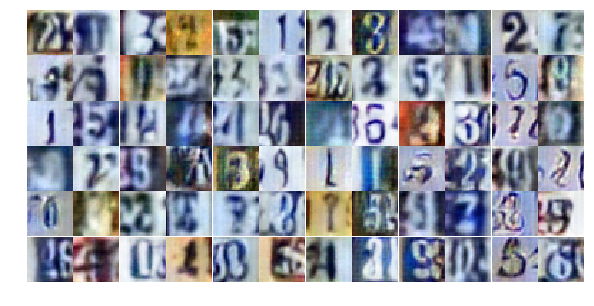

Epoch 17/25... Discriminator Loss: 2.2069... Generator Loss: 0.2056
Epoch 17/25... Discriminator Loss: 0.6246... Generator Loss: 1.3834
Epoch 17/25... Discriminator Loss: 0.4824... Generator Loss: 1.7153
Epoch 17/25... Discriminator Loss: 1.0918... Generator Loss: 0.6156
Epoch 17/25... Discriminator Loss: 1.1688... Generator Loss: 0.6453
Epoch 17/25... Discriminator Loss: 0.6024... Generator Loss: 1.0887
Epoch 17/25... Discriminator Loss: 0.5827... Generator Loss: 1.4187
Epoch 17/25... Discriminator Loss: 0.9090... Generator Loss: 0.7086
Epoch 17/25... Discriminator Loss: 1.0410... Generator Loss: 0.6530
Epoch 17/25... Discriminator Loss: 0.3300... Generator Loss: 1.9847


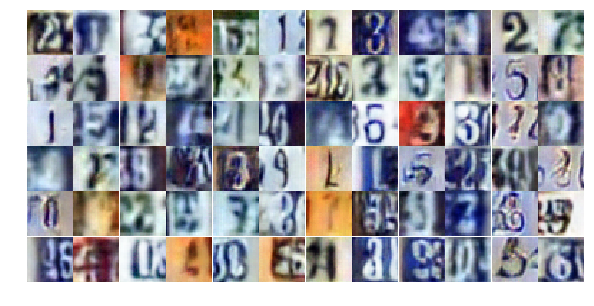

Epoch 17/25... Discriminator Loss: 0.7131... Generator Loss: 1.1542
Epoch 17/25... Discriminator Loss: 0.8034... Generator Loss: 1.0733
Epoch 17/25... Discriminator Loss: 0.5850... Generator Loss: 1.6303
Epoch 17/25... Discriminator Loss: 0.9323... Generator Loss: 0.7577
Epoch 17/25... Discriminator Loss: 0.9132... Generator Loss: 0.7791
Epoch 17/25... Discriminator Loss: 0.7709... Generator Loss: 0.9027
Epoch 17/25... Discriminator Loss: 0.7337... Generator Loss: 0.8913
Epoch 17/25... Discriminator Loss: 0.5853... Generator Loss: 1.4729
Epoch 17/25... Discriminator Loss: 0.4369... Generator Loss: 2.2718
Epoch 17/25... Discriminator Loss: 0.7658... Generator Loss: 0.8860


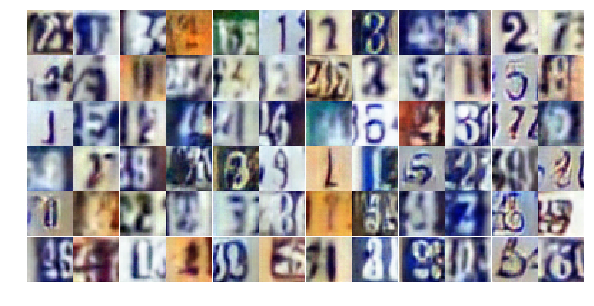

Epoch 17/25... Discriminator Loss: 1.1310... Generator Loss: 1.7231
Epoch 17/25... Discriminator Loss: 0.4550... Generator Loss: 2.5210
Epoch 17/25... Discriminator Loss: 6.8723... Generator Loss: 4.9467
Epoch 17/25... Discriminator Loss: 0.6871... Generator Loss: 1.7039
Epoch 17/25... Discriminator Loss: 0.7262... Generator Loss: 1.0336
Epoch 17/25... Discriminator Loss: 1.0203... Generator Loss: 0.6867
Epoch 17/25... Discriminator Loss: 1.0039... Generator Loss: 0.6666
Epoch 17/25... Discriminator Loss: 1.1105... Generator Loss: 0.6303
Epoch 17/25... Discriminator Loss: 0.7369... Generator Loss: 1.1701
Epoch 17/25... Discriminator Loss: 1.3885... Generator Loss: 0.4206


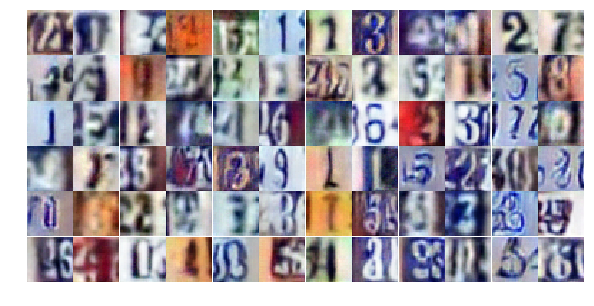

Epoch 17/25... Discriminator Loss: 1.0390... Generator Loss: 0.6740
Epoch 17/25... Discriminator Loss: 1.1970... Generator Loss: 0.4993
Epoch 17/25... Discriminator Loss: 0.4670... Generator Loss: 1.5266
Epoch 17/25... Discriminator Loss: 0.9077... Generator Loss: 0.7176
Epoch 18/25... Discriminator Loss: 1.1095... Generator Loss: 0.6016
Epoch 18/25... Discriminator Loss: 0.8303... Generator Loss: 0.8395
Epoch 18/25... Discriminator Loss: 0.8219... Generator Loss: 0.8329
Epoch 18/25... Discriminator Loss: 0.7840... Generator Loss: 0.9395
Epoch 18/25... Discriminator Loss: 1.3894... Generator Loss: 0.3822
Epoch 18/25... Discriminator Loss: 0.5830... Generator Loss: 1.2581


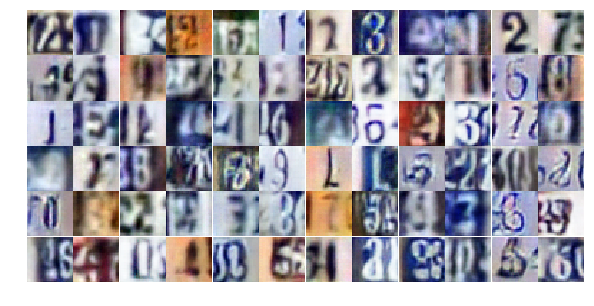

Epoch 18/25... Discriminator Loss: 0.3744... Generator Loss: 2.0280
Epoch 18/25... Discriminator Loss: 1.3643... Generator Loss: 0.4132
Epoch 18/25... Discriminator Loss: 1.0354... Generator Loss: 0.6171
Epoch 18/25... Discriminator Loss: 0.4305... Generator Loss: 2.1039
Epoch 18/25... Discriminator Loss: 0.6471... Generator Loss: 1.0952
Epoch 18/25... Discriminator Loss: 1.1310... Generator Loss: 0.5670
Epoch 18/25... Discriminator Loss: 0.6580... Generator Loss: 0.9384
Epoch 18/25... Discriminator Loss: 0.6739... Generator Loss: 1.0813
Epoch 18/25... Discriminator Loss: 0.7482... Generator Loss: 0.9306
Epoch 18/25... Discriminator Loss: 0.3088... Generator Loss: 1.8478


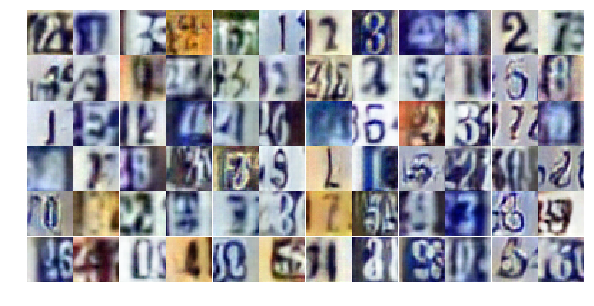

Epoch 18/25... Discriminator Loss: 0.3738... Generator Loss: 2.0659
Epoch 18/25... Discriminator Loss: 0.7871... Generator Loss: 0.8006
Epoch 18/25... Discriminator Loss: 1.0367... Generator Loss: 0.6123
Epoch 18/25... Discriminator Loss: 0.4987... Generator Loss: 1.3354
Epoch 18/25... Discriminator Loss: 0.5986... Generator Loss: 1.1731
Epoch 18/25... Discriminator Loss: 1.0624... Generator Loss: 0.6209
Epoch 18/25... Discriminator Loss: 0.9018... Generator Loss: 0.8553
Epoch 18/25... Discriminator Loss: 0.8632... Generator Loss: 0.8128
Epoch 18/25... Discriminator Loss: 0.8557... Generator Loss: 0.8163
Epoch 18/25... Discriminator Loss: 0.5374... Generator Loss: 1.2464


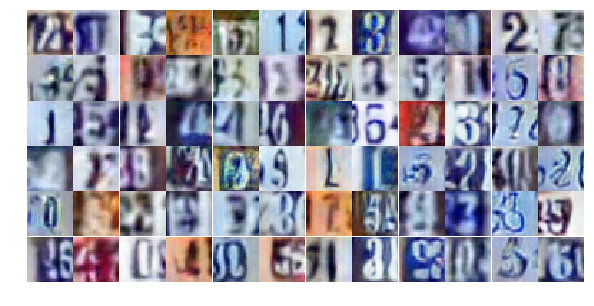

Epoch 18/25... Discriminator Loss: 0.5273... Generator Loss: 1.1957
Epoch 18/25... Discriminator Loss: 0.7289... Generator Loss: 1.1014
Epoch 18/25... Discriminator Loss: 0.5570... Generator Loss: 1.2508
Epoch 18/25... Discriminator Loss: 0.8925... Generator Loss: 0.8357
Epoch 18/25... Discriminator Loss: 1.2612... Generator Loss: 0.5541
Epoch 18/25... Discriminator Loss: 0.6471... Generator Loss: 1.0988
Epoch 18/25... Discriminator Loss: 0.5663... Generator Loss: 1.2512
Epoch 18/25... Discriminator Loss: 0.4907... Generator Loss: 2.2190
Epoch 18/25... Discriminator Loss: 0.5121... Generator Loss: 1.2469
Epoch 18/25... Discriminator Loss: 0.7147... Generator Loss: 1.0191


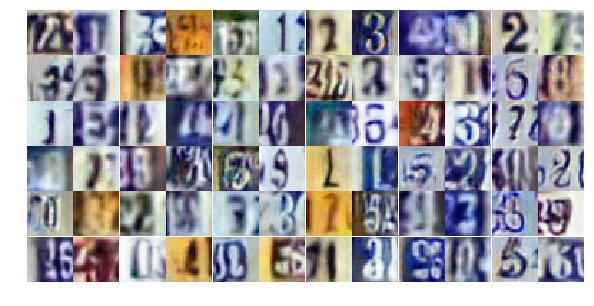

Epoch 18/25... Discriminator Loss: 0.5013... Generator Loss: 1.3534
Epoch 18/25... Discriminator Loss: 0.6754... Generator Loss: 1.0681
Epoch 18/25... Discriminator Loss: 0.7197... Generator Loss: 0.9218
Epoch 18/25... Discriminator Loss: 0.5541... Generator Loss: 1.2810
Epoch 18/25... Discriminator Loss: 0.6650... Generator Loss: 0.9726
Epoch 18/25... Discriminator Loss: 0.4353... Generator Loss: 1.3362
Epoch 18/25... Discriminator Loss: 1.2474... Generator Loss: 0.4897
Epoch 18/25... Discriminator Loss: 3.5052... Generator Loss: 4.9931
Epoch 18/25... Discriminator Loss: 2.6873... Generator Loss: 0.1298
Epoch 18/25... Discriminator Loss: 0.5640... Generator Loss: 1.3786


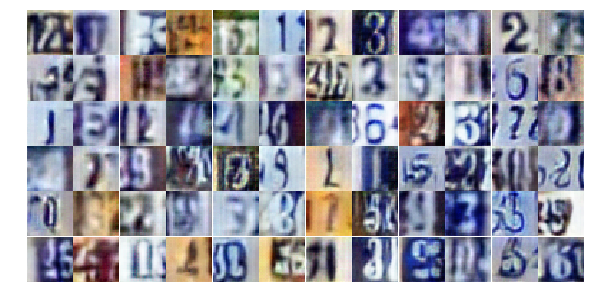

Epoch 18/25... Discriminator Loss: 0.6182... Generator Loss: 1.5198
Epoch 18/25... Discriminator Loss: 0.8238... Generator Loss: 0.9889
Epoch 18/25... Discriminator Loss: 1.1813... Generator Loss: 0.5047
Epoch 18/25... Discriminator Loss: 0.9787... Generator Loss: 0.7241
Epoch 18/25... Discriminator Loss: 1.1999... Generator Loss: 0.5736
Epoch 18/25... Discriminator Loss: 0.7004... Generator Loss: 0.8889
Epoch 18/25... Discriminator Loss: 0.5265... Generator Loss: 1.1951
Epoch 18/25... Discriminator Loss: 0.5085... Generator Loss: 1.3962
Epoch 18/25... Discriminator Loss: 1.1080... Generator Loss: 0.5780
Epoch 18/25... Discriminator Loss: 0.6369... Generator Loss: 1.0022


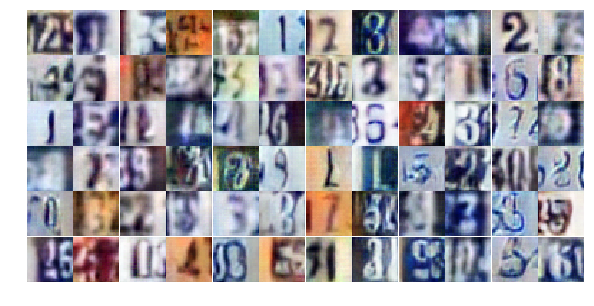

Epoch 18/25... Discriminator Loss: 0.6681... Generator Loss: 2.4242
Epoch 19/25... Discriminator Loss: 0.9288... Generator Loss: 0.9260
Epoch 19/25... Discriminator Loss: 1.0890... Generator Loss: 0.5843
Epoch 19/25... Discriminator Loss: 0.7754... Generator Loss: 1.1648
Epoch 19/25... Discriminator Loss: 0.7043... Generator Loss: 1.0360
Epoch 19/25... Discriminator Loss: 1.0234... Generator Loss: 0.6765
Epoch 19/25... Discriminator Loss: 0.4686... Generator Loss: 1.5168
Epoch 19/25... Discriminator Loss: 0.8778... Generator Loss: 0.8191
Epoch 19/25... Discriminator Loss: 0.6120... Generator Loss: 1.4531
Epoch 19/25... Discriminator Loss: 1.0451... Generator Loss: 0.5757


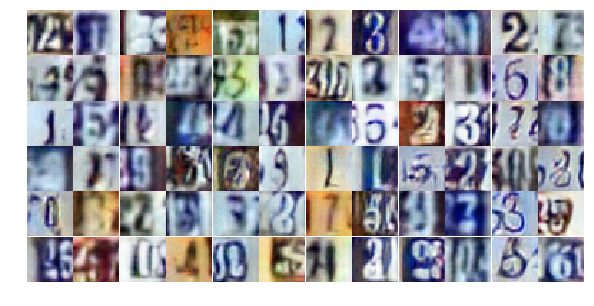

Epoch 19/25... Discriminator Loss: 0.5181... Generator Loss: 1.2515
Epoch 19/25... Discriminator Loss: 0.6611... Generator Loss: 1.0097
Epoch 19/25... Discriminator Loss: 0.7999... Generator Loss: 1.1396
Epoch 19/25... Discriminator Loss: 0.6449... Generator Loss: 0.9905
Epoch 19/25... Discriminator Loss: 0.9812... Generator Loss: 0.6720
Epoch 19/25... Discriminator Loss: 0.6474... Generator Loss: 1.1125
Epoch 19/25... Discriminator Loss: 1.2741... Generator Loss: 0.5252
Epoch 19/25... Discriminator Loss: 0.6139... Generator Loss: 1.1863
Epoch 19/25... Discriminator Loss: 0.7174... Generator Loss: 1.7206
Epoch 19/25... Discriminator Loss: 1.8205... Generator Loss: 0.3187


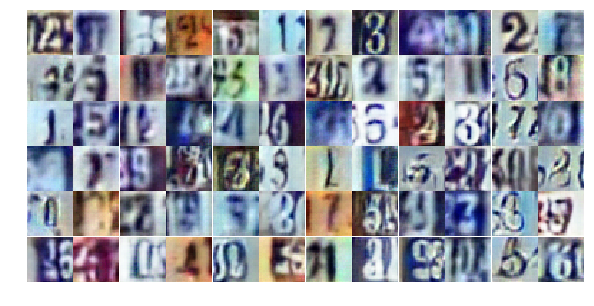

Epoch 19/25... Discriminator Loss: 0.6824... Generator Loss: 1.0644
Epoch 19/25... Discriminator Loss: 1.3420... Generator Loss: 0.5015
Epoch 19/25... Discriminator Loss: 0.9628... Generator Loss: 0.8038
Epoch 19/25... Discriminator Loss: 0.9119... Generator Loss: 0.7821
Epoch 19/25... Discriminator Loss: 1.1939... Generator Loss: 0.5088
Epoch 19/25... Discriminator Loss: 0.9411... Generator Loss: 0.7038
Epoch 19/25... Discriminator Loss: 0.8130... Generator Loss: 0.9208
Epoch 19/25... Discriminator Loss: 0.7174... Generator Loss: 0.9249
Epoch 19/25... Discriminator Loss: 0.6702... Generator Loss: 1.0200
Epoch 19/25... Discriminator Loss: 1.0487... Generator Loss: 0.6316


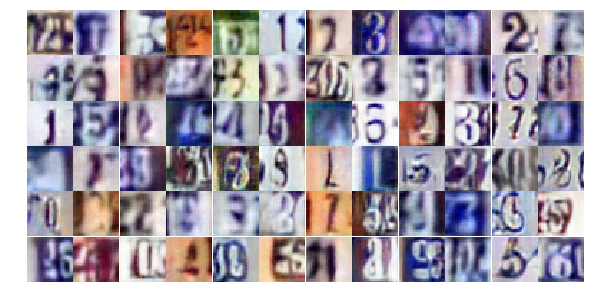

Epoch 19/25... Discriminator Loss: 0.7540... Generator Loss: 1.0216
Epoch 19/25... Discriminator Loss: 0.7057... Generator Loss: 0.9824
Epoch 19/25... Discriminator Loss: 0.7877... Generator Loss: 0.8470
Epoch 19/25... Discriminator Loss: 0.4903... Generator Loss: 1.2881
Epoch 19/25... Discriminator Loss: 0.6198... Generator Loss: 1.2186
Epoch 19/25... Discriminator Loss: 1.0884... Generator Loss: 0.6160
Epoch 19/25... Discriminator Loss: 0.7891... Generator Loss: 0.9940
Epoch 19/25... Discriminator Loss: 0.4709... Generator Loss: 1.5423
Epoch 19/25... Discriminator Loss: 0.8455... Generator Loss: 0.7858
Epoch 19/25... Discriminator Loss: 0.7083... Generator Loss: 0.9164


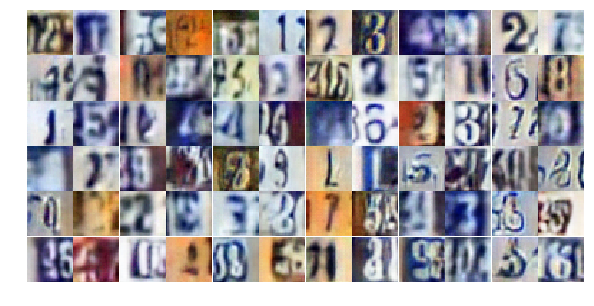

Epoch 19/25... Discriminator Loss: 0.5503... Generator Loss: 1.1693
Epoch 19/25... Discriminator Loss: 1.3139... Generator Loss: 0.4501
Epoch 19/25... Discriminator Loss: 1.4639... Generator Loss: 0.4199
Epoch 19/25... Discriminator Loss: 0.7070... Generator Loss: 0.9529
Epoch 19/25... Discriminator Loss: 0.6016... Generator Loss: 1.4061
Epoch 19/25... Discriminator Loss: 0.5368... Generator Loss: 1.3505
Epoch 19/25... Discriminator Loss: 0.6618... Generator Loss: 1.0559
Epoch 19/25... Discriminator Loss: 0.5921... Generator Loss: 1.0968
Epoch 19/25... Discriminator Loss: 0.6008... Generator Loss: 1.0930
Epoch 19/25... Discriminator Loss: 0.9794... Generator Loss: 0.6972


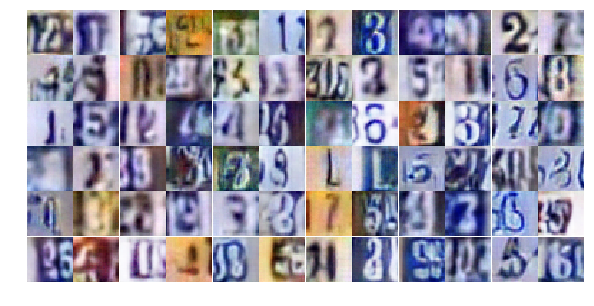

Epoch 19/25... Discriminator Loss: 0.6557... Generator Loss: 0.9739
Epoch 19/25... Discriminator Loss: 0.6542... Generator Loss: 1.1514
Epoch 19/25... Discriminator Loss: 0.7236... Generator Loss: 2.1394
Epoch 19/25... Discriminator Loss: 1.6884... Generator Loss: 0.2908
Epoch 19/25... Discriminator Loss: 0.6262... Generator Loss: 1.3010
Epoch 19/25... Discriminator Loss: 0.6338... Generator Loss: 1.4352
Epoch 19/25... Discriminator Loss: 1.9932... Generator Loss: 0.2573
Epoch 19/25... Discriminator Loss: 0.5623... Generator Loss: 1.2964
Epoch 20/25... Discriminator Loss: 0.7627... Generator Loss: 1.5646
Epoch 20/25... Discriminator Loss: 1.0821... Generator Loss: 0.6040


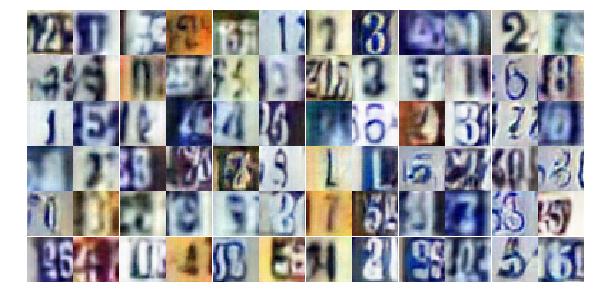

Epoch 20/25... Discriminator Loss: 0.4248... Generator Loss: 1.4929
Epoch 20/25... Discriminator Loss: 1.1805... Generator Loss: 0.5477
Epoch 20/25... Discriminator Loss: 1.3986... Generator Loss: 0.4218
Epoch 20/25... Discriminator Loss: 0.7966... Generator Loss: 0.8629
Epoch 20/25... Discriminator Loss: 0.6989... Generator Loss: 1.0431
Epoch 20/25... Discriminator Loss: 0.6945... Generator Loss: 0.9761
Epoch 20/25... Discriminator Loss: 0.9178... Generator Loss: 0.7716
Epoch 20/25... Discriminator Loss: 0.6619... Generator Loss: 1.0754
Epoch 20/25... Discriminator Loss: 0.7013... Generator Loss: 1.3598
Epoch 20/25... Discriminator Loss: 0.7476... Generator Loss: 0.8943


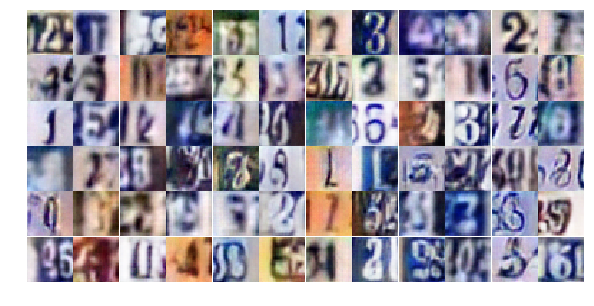

Epoch 20/25... Discriminator Loss: 1.8504... Generator Loss: 0.2846
Epoch 20/25... Discriminator Loss: 0.8843... Generator Loss: 0.7922
Epoch 20/25... Discriminator Loss: 0.8104... Generator Loss: 0.8899
Epoch 20/25... Discriminator Loss: 0.6947... Generator Loss: 1.0959
Epoch 20/25... Discriminator Loss: 0.9931... Generator Loss: 0.6976
Epoch 20/25... Discriminator Loss: 2.0242... Generator Loss: 0.2440
Epoch 20/25... Discriminator Loss: 1.1533... Generator Loss: 0.6440
Epoch 20/25... Discriminator Loss: 0.7955... Generator Loss: 0.8538
Epoch 20/25... Discriminator Loss: 0.5548... Generator Loss: 1.2503
Epoch 20/25... Discriminator Loss: 1.0150... Generator Loss: 0.7462


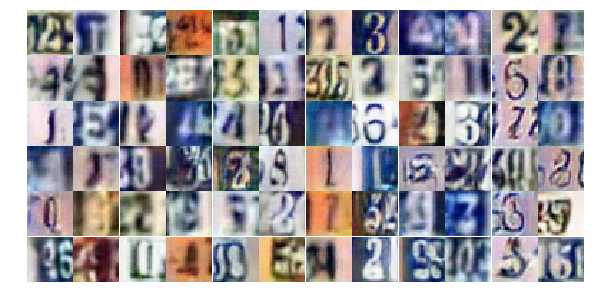

Epoch 20/25... Discriminator Loss: 0.7600... Generator Loss: 0.8310
Epoch 20/25... Discriminator Loss: 0.6476... Generator Loss: 1.0109
Epoch 20/25... Discriminator Loss: 0.4527... Generator Loss: 2.6147
Epoch 20/25... Discriminator Loss: 1.2484... Generator Loss: 0.5073
Epoch 20/25... Discriminator Loss: 0.9560... Generator Loss: 0.8800
Epoch 20/25... Discriminator Loss: 0.5817... Generator Loss: 1.2066
Epoch 20/25... Discriminator Loss: 0.5137... Generator Loss: 1.4551
Epoch 20/25... Discriminator Loss: 1.4709... Generator Loss: 0.4427
Epoch 20/25... Discriminator Loss: 0.8850... Generator Loss: 0.7972
Epoch 20/25... Discriminator Loss: 0.4640... Generator Loss: 1.2668


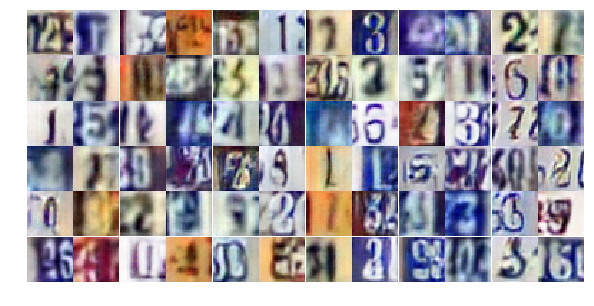

Epoch 20/25... Discriminator Loss: 0.5837... Generator Loss: 1.4886
Epoch 20/25... Discriminator Loss: 0.4522... Generator Loss: 1.4443
Epoch 20/25... Discriminator Loss: 0.8739... Generator Loss: 0.7881
Epoch 20/25... Discriminator Loss: 0.5682... Generator Loss: 1.3085
Epoch 20/25... Discriminator Loss: 0.8451... Generator Loss: 0.8505
Epoch 20/25... Discriminator Loss: 0.4339... Generator Loss: 1.9710
Epoch 20/25... Discriminator Loss: 0.7180... Generator Loss: 1.7289
Epoch 20/25... Discriminator Loss: 0.9310... Generator Loss: 0.7908
Epoch 20/25... Discriminator Loss: 0.6680... Generator Loss: 1.3702
Epoch 20/25... Discriminator Loss: 1.0727... Generator Loss: 0.5665


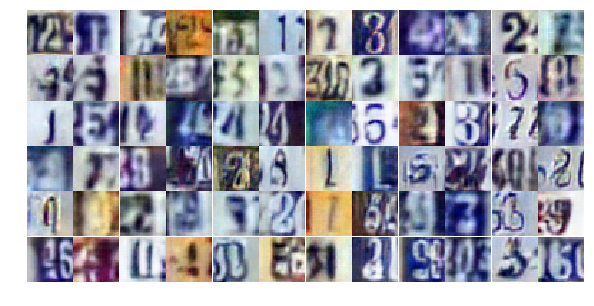

Epoch 20/25... Discriminator Loss: 1.9031... Generator Loss: 0.3797
Epoch 20/25... Discriminator Loss: 1.0062... Generator Loss: 0.7341
Epoch 20/25... Discriminator Loss: 1.1218... Generator Loss: 1.2438
Epoch 20/25... Discriminator Loss: 0.5232... Generator Loss: 1.3360
Epoch 20/25... Discriminator Loss: 0.7324... Generator Loss: 1.0027
Epoch 20/25... Discriminator Loss: 0.9340... Generator Loss: 0.7226
Epoch 20/25... Discriminator Loss: 1.3525... Generator Loss: 0.4509
Epoch 20/25... Discriminator Loss: 0.4182... Generator Loss: 1.6625
Epoch 20/25... Discriminator Loss: 0.6805... Generator Loss: 1.0316
Epoch 20/25... Discriminator Loss: 0.7737... Generator Loss: 0.8479


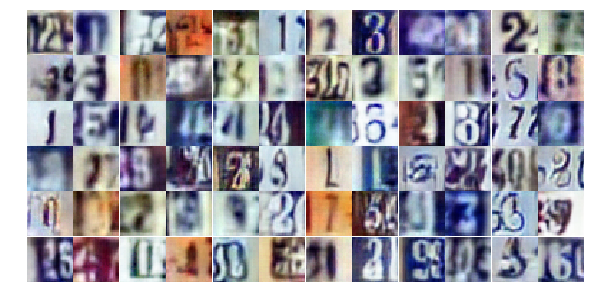

Epoch 20/25... Discriminator Loss: 0.5463... Generator Loss: 1.3795
Epoch 20/25... Discriminator Loss: 0.6588... Generator Loss: 1.5048
Epoch 20/25... Discriminator Loss: 0.6424... Generator Loss: 1.0834
Epoch 20/25... Discriminator Loss: 0.8251... Generator Loss: 0.9205
Epoch 20/25... Discriminator Loss: 0.5827... Generator Loss: 1.2363
Epoch 20/25... Discriminator Loss: 0.4225... Generator Loss: 1.5441
Epoch 21/25... Discriminator Loss: 1.4493... Generator Loss: 0.4589
Epoch 21/25... Discriminator Loss: 0.9245... Generator Loss: 0.7075
Epoch 21/25... Discriminator Loss: 1.2472... Generator Loss: 0.4737
Epoch 21/25... Discriminator Loss: 1.1355... Generator Loss: 0.6257


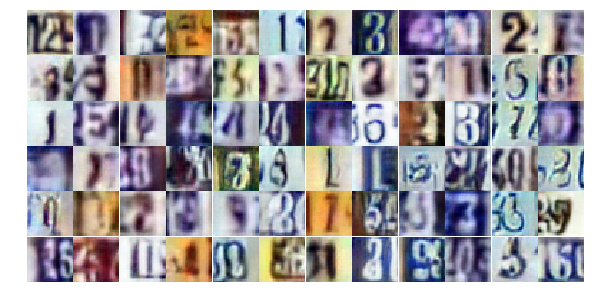

Epoch 21/25... Discriminator Loss: 0.7597... Generator Loss: 0.9212
Epoch 21/25... Discriminator Loss: 1.6151... Generator Loss: 0.3181
Epoch 21/25... Discriminator Loss: 0.4104... Generator Loss: 2.0051
Epoch 21/25... Discriminator Loss: 0.3704... Generator Loss: 1.5602
Epoch 21/25... Discriminator Loss: 0.6374... Generator Loss: 1.2224
Epoch 21/25... Discriminator Loss: 0.3487... Generator Loss: 1.8316
Epoch 21/25... Discriminator Loss: 0.9538... Generator Loss: 0.8021
Epoch 21/25... Discriminator Loss: 0.8870... Generator Loss: 0.8130
Epoch 21/25... Discriminator Loss: 1.0195... Generator Loss: 0.6133
Epoch 21/25... Discriminator Loss: 1.4133... Generator Loss: 0.4445


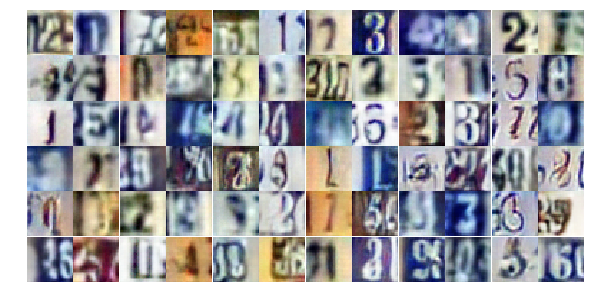

Epoch 21/25... Discriminator Loss: 0.2681... Generator Loss: 1.9091
Epoch 21/25... Discriminator Loss: 0.8733... Generator Loss: 0.7815
Epoch 21/25... Discriminator Loss: 1.7848... Generator Loss: 0.3285
Epoch 21/25... Discriminator Loss: 0.5661... Generator Loss: 1.4161
Epoch 21/25... Discriminator Loss: 0.4948... Generator Loss: 1.4433
Epoch 21/25... Discriminator Loss: 0.9647... Generator Loss: 0.6899
Epoch 21/25... Discriminator Loss: 0.5412... Generator Loss: 1.4190
Epoch 21/25... Discriminator Loss: 0.4057... Generator Loss: 1.7775
Epoch 21/25... Discriminator Loss: 0.4896... Generator Loss: 1.2499
Epoch 21/25... Discriminator Loss: 0.7204... Generator Loss: 0.9481


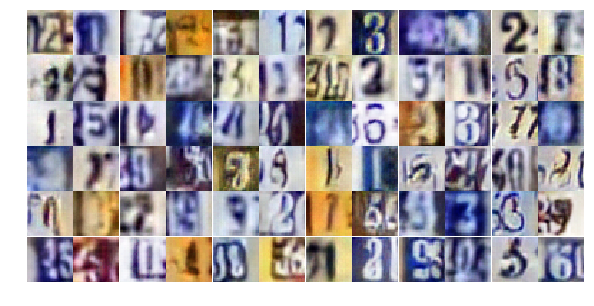

Epoch 21/25... Discriminator Loss: 2.2394... Generator Loss: 0.1828
Epoch 21/25... Discriminator Loss: 0.6272... Generator Loss: 1.8196
Epoch 21/25... Discriminator Loss: 0.9582... Generator Loss: 0.7125
Epoch 21/25... Discriminator Loss: 0.7571... Generator Loss: 1.1079
Epoch 21/25... Discriminator Loss: 1.1150... Generator Loss: 0.6369
Epoch 21/25... Discriminator Loss: 1.0125... Generator Loss: 0.7186
Epoch 21/25... Discriminator Loss: 0.4808... Generator Loss: 1.4134
Epoch 21/25... Discriminator Loss: 1.0560... Generator Loss: 0.6192
Epoch 21/25... Discriminator Loss: 1.5443... Generator Loss: 0.3784
Epoch 21/25... Discriminator Loss: 1.6660... Generator Loss: 0.3535


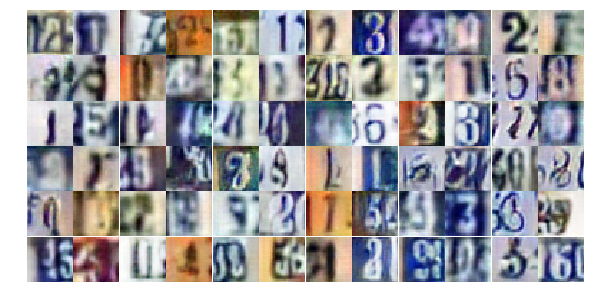

Epoch 21/25... Discriminator Loss: 1.2267... Generator Loss: 0.5054
Epoch 21/25... Discriminator Loss: 0.6886... Generator Loss: 0.9902
Epoch 21/25... Discriminator Loss: 1.3066... Generator Loss: 0.4603
Epoch 21/25... Discriminator Loss: 0.5001... Generator Loss: 1.4017
Epoch 21/25... Discriminator Loss: 0.5881... Generator Loss: 1.3106
Epoch 21/25... Discriminator Loss: 0.6738... Generator Loss: 1.1897
Epoch 21/25... Discriminator Loss: 0.6446... Generator Loss: 1.0212
Epoch 21/25... Discriminator Loss: 1.5242... Generator Loss: 0.3736
Epoch 21/25... Discriminator Loss: 0.7896... Generator Loss: 0.8495
Epoch 21/25... Discriminator Loss: 0.2884... Generator Loss: 3.6315


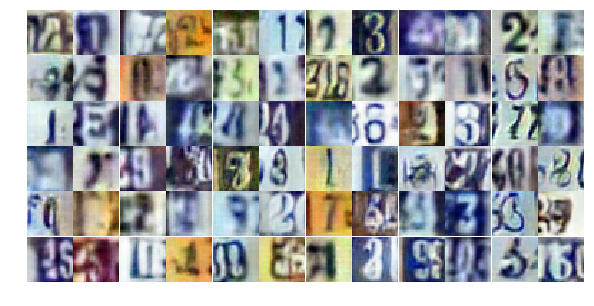

Epoch 21/25... Discriminator Loss: 0.9272... Generator Loss: 0.7114
Epoch 21/25... Discriminator Loss: 1.0560... Generator Loss: 0.6329
Epoch 21/25... Discriminator Loss: 0.6008... Generator Loss: 1.0865
Epoch 21/25... Discriminator Loss: 0.8409... Generator Loss: 0.8749
Epoch 21/25... Discriminator Loss: 0.4877... Generator Loss: 1.3484
Epoch 21/25... Discriminator Loss: 0.7238... Generator Loss: 0.9684
Epoch 21/25... Discriminator Loss: 1.6657... Generator Loss: 0.3060
Epoch 21/25... Discriminator Loss: 0.8638... Generator Loss: 0.9437
Epoch 21/25... Discriminator Loss: 0.9552... Generator Loss: 0.6903
Epoch 21/25... Discriminator Loss: 1.1822... Generator Loss: 0.5683


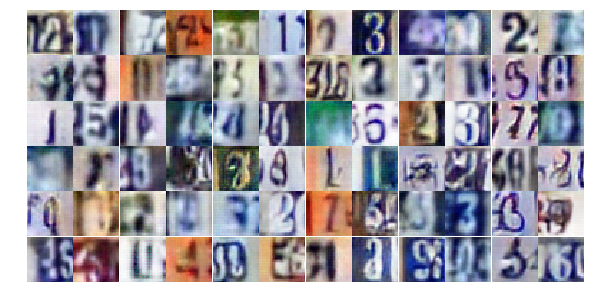

Epoch 21/25... Discriminator Loss: 0.5106... Generator Loss: 1.3298
Epoch 21/25... Discriminator Loss: 1.1803... Generator Loss: 0.5469
Epoch 21/25... Discriminator Loss: 0.7295... Generator Loss: 0.9595
Epoch 22/25... Discriminator Loss: 0.6359... Generator Loss: 1.3043
Epoch 22/25... Discriminator Loss: 0.7200... Generator Loss: 1.6445
Epoch 22/25... Discriminator Loss: 0.6324... Generator Loss: 1.2462
Epoch 22/25... Discriminator Loss: 0.5021... Generator Loss: 2.2653
Epoch 22/25... Discriminator Loss: 0.4621... Generator Loss: 1.4212
Epoch 22/25... Discriminator Loss: 1.0110... Generator Loss: 0.7557
Epoch 22/25... Discriminator Loss: 0.7798... Generator Loss: 0.8625


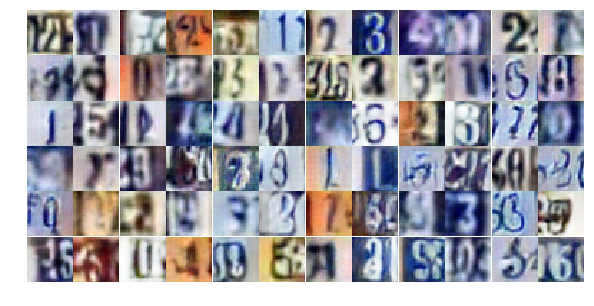

Epoch 22/25... Discriminator Loss: 0.5916... Generator Loss: 1.1806
Epoch 22/25... Discriminator Loss: 0.5546... Generator Loss: 1.9280
Epoch 22/25... Discriminator Loss: 1.2419... Generator Loss: 0.6034
Epoch 22/25... Discriminator Loss: 0.8840... Generator Loss: 0.8043
Epoch 22/25... Discriminator Loss: 0.7992... Generator Loss: 0.9980
Epoch 22/25... Discriminator Loss: 0.5780... Generator Loss: 1.2131
Epoch 22/25... Discriminator Loss: 0.7317... Generator Loss: 0.9557
Epoch 22/25... Discriminator Loss: 0.5403... Generator Loss: 1.3016
Epoch 22/25... Discriminator Loss: 1.3822... Generator Loss: 0.4755
Epoch 22/25... Discriminator Loss: 1.8084... Generator Loss: 0.3048


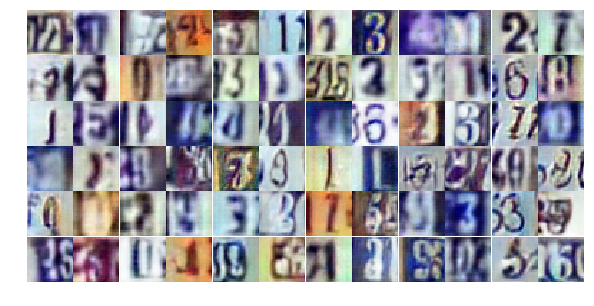

Epoch 22/25... Discriminator Loss: 0.5679... Generator Loss: 1.5360
Epoch 22/25... Discriminator Loss: 0.5212... Generator Loss: 1.6725
Epoch 22/25... Discriminator Loss: 0.6697... Generator Loss: 1.0424
Epoch 22/25... Discriminator Loss: 0.4526... Generator Loss: 2.5093
Epoch 22/25... Discriminator Loss: 0.5189... Generator Loss: 1.5424
Epoch 22/25... Discriminator Loss: 1.0774... Generator Loss: 0.5549
Epoch 22/25... Discriminator Loss: 0.5470... Generator Loss: 1.2874
Epoch 22/25... Discriminator Loss: 0.4815... Generator Loss: 1.4887
Epoch 22/25... Discriminator Loss: 0.4693... Generator Loss: 1.6651
Epoch 22/25... Discriminator Loss: 0.5572... Generator Loss: 1.3933


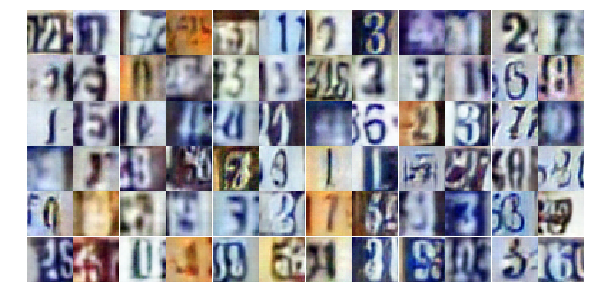

Epoch 22/25... Discriminator Loss: 0.4195... Generator Loss: 1.6190
Epoch 22/25... Discriminator Loss: 0.5171... Generator Loss: 1.5084
Epoch 22/25... Discriminator Loss: 0.7786... Generator Loss: 0.9129
Epoch 22/25... Discriminator Loss: 0.8387... Generator Loss: 0.8144
Epoch 22/25... Discriminator Loss: 0.9924... Generator Loss: 0.7166
Epoch 22/25... Discriminator Loss: 0.7799... Generator Loss: 0.9619
Epoch 22/25... Discriminator Loss: 1.7455... Generator Loss: 0.3357
Epoch 22/25... Discriminator Loss: 0.6896... Generator Loss: 1.0943
Epoch 22/25... Discriminator Loss: 1.1461... Generator Loss: 0.6005
Epoch 22/25... Discriminator Loss: 1.3957... Generator Loss: 0.4877


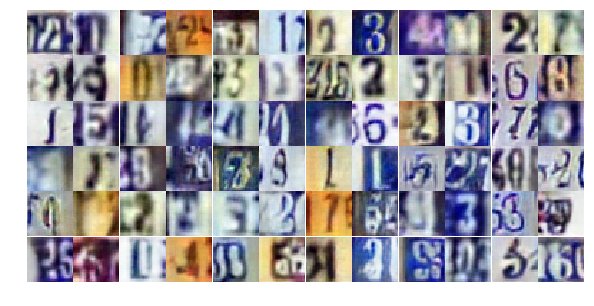

Epoch 22/25... Discriminator Loss: 0.9802... Generator Loss: 0.6315
Epoch 22/25... Discriminator Loss: 0.5021... Generator Loss: 1.4155
Epoch 22/25... Discriminator Loss: 0.4755... Generator Loss: 1.3054
Epoch 22/25... Discriminator Loss: 0.5668... Generator Loss: 1.5645
Epoch 22/25... Discriminator Loss: 0.5097... Generator Loss: 1.1748
Epoch 22/25... Discriminator Loss: 0.5608... Generator Loss: 1.0923
Epoch 22/25... Discriminator Loss: 0.8792... Generator Loss: 0.9393
Epoch 22/25... Discriminator Loss: 1.0486... Generator Loss: 0.6473
Epoch 22/25... Discriminator Loss: 1.3266... Generator Loss: 0.4592
Epoch 22/25... Discriminator Loss: 0.9114... Generator Loss: 0.7736


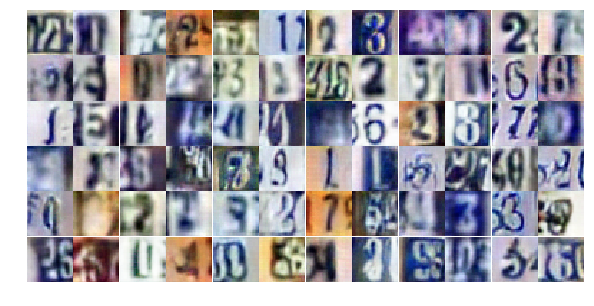

Epoch 22/25... Discriminator Loss: 0.9493... Generator Loss: 0.7120
Epoch 22/25... Discriminator Loss: 0.6540... Generator Loss: 1.0856
Epoch 22/25... Discriminator Loss: 0.7719... Generator Loss: 0.8096
Epoch 22/25... Discriminator Loss: 1.0944... Generator Loss: 0.5706
Epoch 22/25... Discriminator Loss: 1.3650... Generator Loss: 0.5116
Epoch 22/25... Discriminator Loss: 1.1818... Generator Loss: 3.0453
Epoch 22/25... Discriminator Loss: 3.2336... Generator Loss: 2.7090
Epoch 22/25... Discriminator Loss: 1.6368... Generator Loss: 0.8275
Epoch 22/25... Discriminator Loss: 1.8028... Generator Loss: 1.1541
Epoch 22/25... Discriminator Loss: 1.3335... Generator Loss: 0.6324


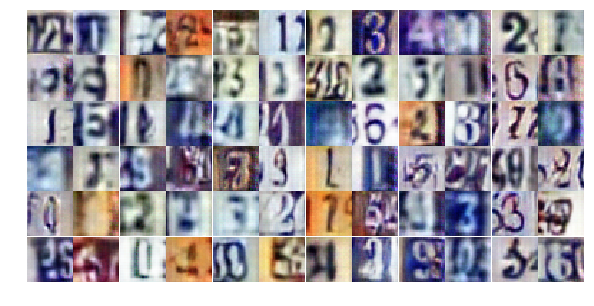

Epoch 23/25... Discriminator Loss: 1.0810... Generator Loss: 1.2228
Epoch 23/25... Discriminator Loss: 1.6768... Generator Loss: 0.4985
Epoch 23/25... Discriminator Loss: 1.2609... Generator Loss: 0.7429
Epoch 23/25... Discriminator Loss: 1.4765... Generator Loss: 0.6558
Epoch 23/25... Discriminator Loss: 1.4323... Generator Loss: 0.8116
Epoch 23/25... Discriminator Loss: 1.5432... Generator Loss: 0.6677
Epoch 23/25... Discriminator Loss: 1.4062... Generator Loss: 0.6738
Epoch 23/25... Discriminator Loss: 1.3607... Generator Loss: 0.5951
Epoch 23/25... Discriminator Loss: 1.3935... Generator Loss: 0.8811
Epoch 23/25... Discriminator Loss: 1.2829... Generator Loss: 0.7555


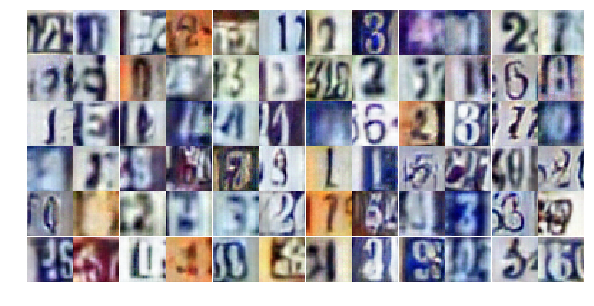

Epoch 23/25... Discriminator Loss: 1.3295... Generator Loss: 0.7327
Epoch 23/25... Discriminator Loss: 1.2652... Generator Loss: 0.8980
Epoch 23/25... Discriminator Loss: 1.2637... Generator Loss: 0.7836
Epoch 23/25... Discriminator Loss: 1.2131... Generator Loss: 0.9027
Epoch 23/25... Discriminator Loss: 1.4013... Generator Loss: 0.6805
Epoch 23/25... Discriminator Loss: 1.4153... Generator Loss: 0.7253
Epoch 23/25... Discriminator Loss: 1.3273... Generator Loss: 0.7517
Epoch 23/25... Discriminator Loss: 1.3080... Generator Loss: 0.8033
Epoch 23/25... Discriminator Loss: 1.3270... Generator Loss: 0.9184
Epoch 23/25... Discriminator Loss: 1.2928... Generator Loss: 0.7923


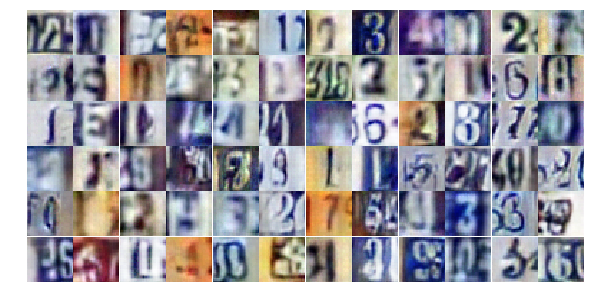

Epoch 23/25... Discriminator Loss: 1.2466... Generator Loss: 0.7480
Epoch 23/25... Discriminator Loss: 1.3050... Generator Loss: 1.0207
Epoch 23/25... Discriminator Loss: 1.0914... Generator Loss: 0.7380
Epoch 23/25... Discriminator Loss: 0.9774... Generator Loss: 0.8388
Epoch 23/25... Discriminator Loss: 1.3910... Generator Loss: 0.7067
Epoch 23/25... Discriminator Loss: 1.2750... Generator Loss: 0.9264
Epoch 23/25... Discriminator Loss: 1.2297... Generator Loss: 0.6294
Epoch 23/25... Discriminator Loss: 0.9881... Generator Loss: 0.9196
Epoch 23/25... Discriminator Loss: 1.1807... Generator Loss: 0.6948
Epoch 23/25... Discriminator Loss: 1.4581... Generator Loss: 0.4464


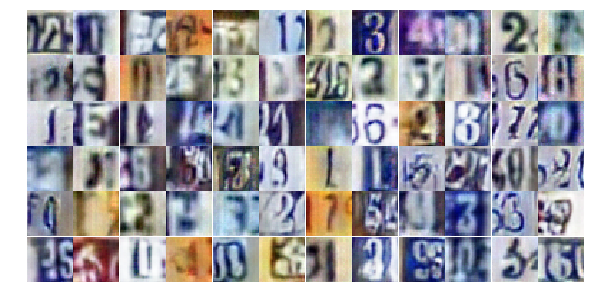

Epoch 23/25... Discriminator Loss: 1.3536... Generator Loss: 2.1412
Epoch 23/25... Discriminator Loss: 1.1401... Generator Loss: 0.7853
Epoch 23/25... Discriminator Loss: 0.8695... Generator Loss: 1.6281
Epoch 23/25... Discriminator Loss: 0.8556... Generator Loss: 0.9767
Epoch 23/25... Discriminator Loss: 0.9312... Generator Loss: 1.5837
Epoch 23/25... Discriminator Loss: 0.8821... Generator Loss: 1.0002
Epoch 23/25... Discriminator Loss: 0.9351... Generator Loss: 1.6290
Epoch 23/25... Discriminator Loss: 0.9022... Generator Loss: 0.7720
Epoch 23/25... Discriminator Loss: 0.6367... Generator Loss: 1.1328
Epoch 23/25... Discriminator Loss: 0.5477... Generator Loss: 1.2814


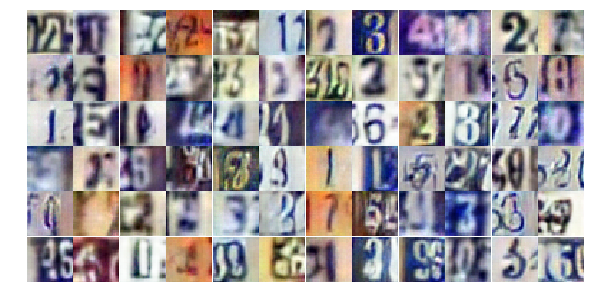

Epoch 23/25... Discriminator Loss: 1.0392... Generator Loss: 0.7824
Epoch 23/25... Discriminator Loss: 0.7566... Generator Loss: 1.0897
Epoch 23/25... Discriminator Loss: 1.3057... Generator Loss: 0.4556
Epoch 23/25... Discriminator Loss: 0.7013... Generator Loss: 1.0456
Epoch 23/25... Discriminator Loss: 1.2157... Generator Loss: 0.5690
Epoch 23/25... Discriminator Loss: 0.8474... Generator Loss: 0.9307
Epoch 23/25... Discriminator Loss: 0.8453... Generator Loss: 0.8635
Epoch 23/25... Discriminator Loss: 1.1998... Generator Loss: 0.5937
Epoch 23/25... Discriminator Loss: 0.8791... Generator Loss: 0.9053
Epoch 23/25... Discriminator Loss: 0.6116... Generator Loss: 1.1697


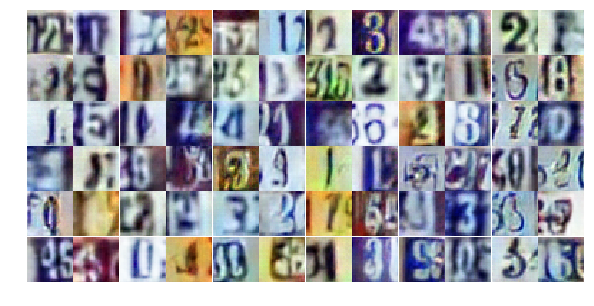

Epoch 23/25... Discriminator Loss: 0.5455... Generator Loss: 1.4203
Epoch 23/25... Discriminator Loss: 1.9685... Generator Loss: 0.2297
Epoch 23/25... Discriminator Loss: 0.8212... Generator Loss: 0.8722
Epoch 23/25... Discriminator Loss: 0.4088... Generator Loss: 1.6349
Epoch 23/25... Discriminator Loss: 1.0037... Generator Loss: 0.6291
Epoch 23/25... Discriminator Loss: 0.6427... Generator Loss: 1.0678
Epoch 23/25... Discriminator Loss: 0.9413... Generator Loss: 0.6973
Epoch 24/25... Discriminator Loss: 1.2856... Generator Loss: 0.4657
Epoch 24/25... Discriminator Loss: 0.9192... Generator Loss: 0.7687
Epoch 24/25... Discriminator Loss: 0.9229... Generator Loss: 0.8133


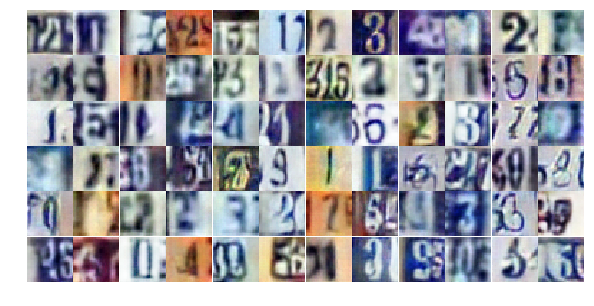

Epoch 24/25... Discriminator Loss: 0.7663... Generator Loss: 2.3762
Epoch 24/25... Discriminator Loss: 0.6103... Generator Loss: 1.3611
Epoch 24/25... Discriminator Loss: 0.5690... Generator Loss: 1.3981
Epoch 24/25... Discriminator Loss: 0.8291... Generator Loss: 1.0490
Epoch 24/25... Discriminator Loss: 1.0129... Generator Loss: 0.6850
Epoch 24/25... Discriminator Loss: 1.0978... Generator Loss: 0.5679
Epoch 24/25... Discriminator Loss: 1.0203... Generator Loss: 0.7664
Epoch 24/25... Discriminator Loss: 1.2927... Generator Loss: 0.5323
Epoch 24/25... Discriminator Loss: 0.6832... Generator Loss: 0.9683
Epoch 24/25... Discriminator Loss: 0.5914... Generator Loss: 1.2537


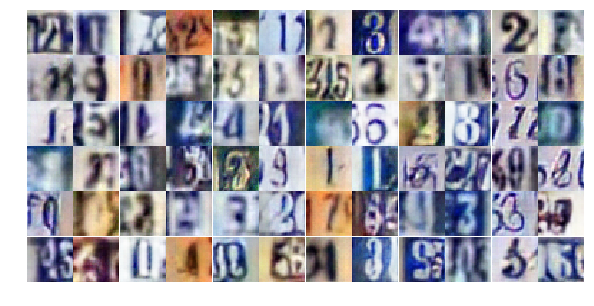

Epoch 24/25... Discriminator Loss: 1.2821... Generator Loss: 0.4908
Epoch 24/25... Discriminator Loss: 1.4602... Generator Loss: 0.4908
Epoch 24/25... Discriminator Loss: 1.2258... Generator Loss: 0.4797
Epoch 24/25... Discriminator Loss: 0.9564... Generator Loss: 0.6698
Epoch 24/25... Discriminator Loss: 1.9330... Generator Loss: 5.1599
Epoch 24/25... Discriminator Loss: 0.8573... Generator Loss: 1.6599
Epoch 24/25... Discriminator Loss: 0.5116... Generator Loss: 1.4312
Epoch 24/25... Discriminator Loss: 1.2407... Generator Loss: 0.5410
Epoch 24/25... Discriminator Loss: 0.6219... Generator Loss: 1.2858
Epoch 24/25... Discriminator Loss: 0.8513... Generator Loss: 0.8635


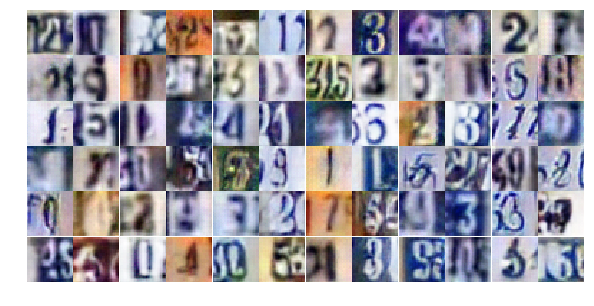

Epoch 24/25... Discriminator Loss: 0.7769... Generator Loss: 0.9151
Epoch 24/25... Discriminator Loss: 0.6150... Generator Loss: 1.2057
Epoch 24/25... Discriminator Loss: 0.5427... Generator Loss: 1.1477
Epoch 24/25... Discriminator Loss: 1.3543... Generator Loss: 0.5140
Epoch 24/25... Discriminator Loss: 0.6064... Generator Loss: 1.1542
Epoch 24/25... Discriminator Loss: 0.6364... Generator Loss: 1.1196
Epoch 24/25... Discriminator Loss: 0.6187... Generator Loss: 1.2251
Epoch 24/25... Discriminator Loss: 0.6726... Generator Loss: 1.0213
Epoch 24/25... Discriminator Loss: 0.6032... Generator Loss: 1.2000
Epoch 24/25... Discriminator Loss: 0.9957... Generator Loss: 0.6884


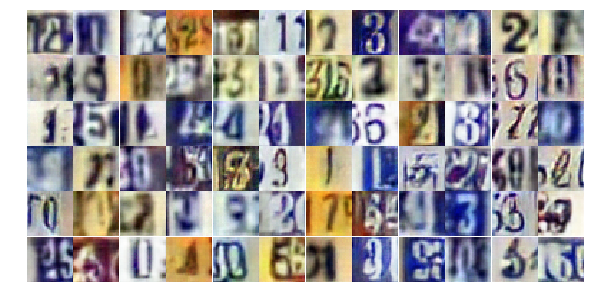

Epoch 24/25... Discriminator Loss: 0.5374... Generator Loss: 1.2350
Epoch 24/25... Discriminator Loss: 0.5153... Generator Loss: 1.1817
Epoch 24/25... Discriminator Loss: 1.1168... Generator Loss: 0.8633
Epoch 24/25... Discriminator Loss: 1.3211... Generator Loss: 0.7028
Epoch 24/25... Discriminator Loss: 0.7793... Generator Loss: 1.0014
Epoch 24/25... Discriminator Loss: 0.8478... Generator Loss: 0.8335
Epoch 24/25... Discriminator Loss: 0.8772... Generator Loss: 0.7767
Epoch 24/25... Discriminator Loss: 0.8896... Generator Loss: 0.7371
Epoch 24/25... Discriminator Loss: 0.8140... Generator Loss: 0.9769
Epoch 24/25... Discriminator Loss: 0.6107... Generator Loss: 1.7812


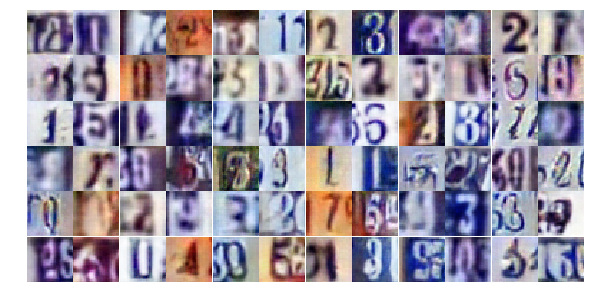

Epoch 24/25... Discriminator Loss: 0.7452... Generator Loss: 0.9200
Epoch 24/25... Discriminator Loss: 0.9329... Generator Loss: 0.7429
Epoch 24/25... Discriminator Loss: 0.9381... Generator Loss: 0.8649
Epoch 24/25... Discriminator Loss: 1.3967... Generator Loss: 0.4178
Epoch 24/25... Discriminator Loss: 1.9215... Generator Loss: 0.2576
Epoch 24/25... Discriminator Loss: 0.7252... Generator Loss: 1.0135
Epoch 24/25... Discriminator Loss: 0.6846... Generator Loss: 1.0427
Epoch 24/25... Discriminator Loss: 0.6820... Generator Loss: 1.1067
Epoch 24/25... Discriminator Loss: 0.6036... Generator Loss: 1.4745
Epoch 24/25... Discriminator Loss: 1.0448... Generator Loss: 0.6469


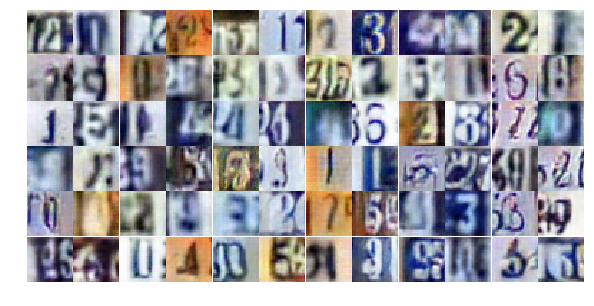

Epoch 24/25... Discriminator Loss: 1.1504... Generator Loss: 0.5802
Epoch 24/25... Discriminator Loss: 1.9126... Generator Loss: 0.3007
Epoch 24/25... Discriminator Loss: 1.4088... Generator Loss: 0.4466
Epoch 24/25... Discriminator Loss: 0.9262... Generator Loss: 0.7122
Epoch 24/25... Discriminator Loss: 1.2485... Generator Loss: 0.4685
Epoch 25/25... Discriminator Loss: 0.5458... Generator Loss: 1.4609
Epoch 25/25... Discriminator Loss: 0.5808... Generator Loss: 1.2156
Epoch 25/25... Discriminator Loss: 0.8380... Generator Loss: 0.8406
Epoch 25/25... Discriminator Loss: 0.9430... Generator Loss: 0.7337
Epoch 25/25... Discriminator Loss: 0.8525... Generator Loss: 0.7399


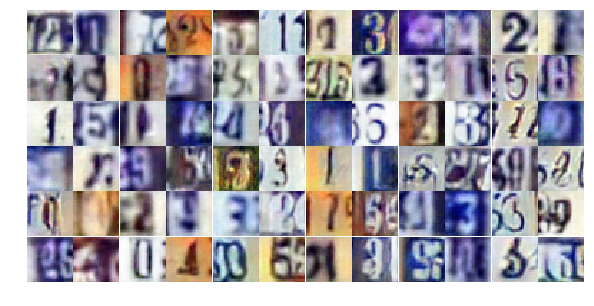

Epoch 25/25... Discriminator Loss: 0.5224... Generator Loss: 1.9902
Epoch 25/25... Discriminator Loss: 1.7687... Generator Loss: 0.2807
Epoch 25/25... Discriminator Loss: 0.8297... Generator Loss: 0.8381
Epoch 25/25... Discriminator Loss: 0.7644... Generator Loss: 1.0399
Epoch 25/25... Discriminator Loss: 0.7774... Generator Loss: 1.2160
Epoch 25/25... Discriminator Loss: 0.7988... Generator Loss: 0.9024
Epoch 25/25... Discriminator Loss: 0.5420... Generator Loss: 1.5009
Epoch 25/25... Discriminator Loss: 0.8063... Generator Loss: 0.8855
Epoch 25/25... Discriminator Loss: 0.5697... Generator Loss: 1.2033
Epoch 25/25... Discriminator Loss: 0.6909... Generator Loss: 1.0381


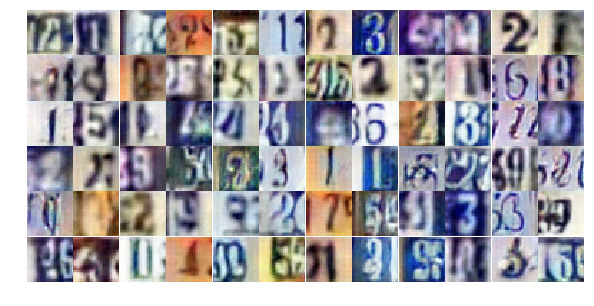

Epoch 25/25... Discriminator Loss: 0.9179... Generator Loss: 0.8013
Epoch 25/25... Discriminator Loss: 0.4061... Generator Loss: 1.5989
Epoch 25/25... Discriminator Loss: 1.5483... Generator Loss: 0.4142
Epoch 25/25... Discriminator Loss: 0.8883... Generator Loss: 0.9701
Epoch 25/25... Discriminator Loss: 0.8201... Generator Loss: 0.8522
Epoch 25/25... Discriminator Loss: 0.4911... Generator Loss: 1.4734
Epoch 25/25... Discriminator Loss: 0.7172... Generator Loss: 1.1561
Epoch 25/25... Discriminator Loss: 0.7767... Generator Loss: 0.9589
Epoch 25/25... Discriminator Loss: 0.5436... Generator Loss: 1.4225
Epoch 25/25... Discriminator Loss: 1.9703... Generator Loss: 0.2336


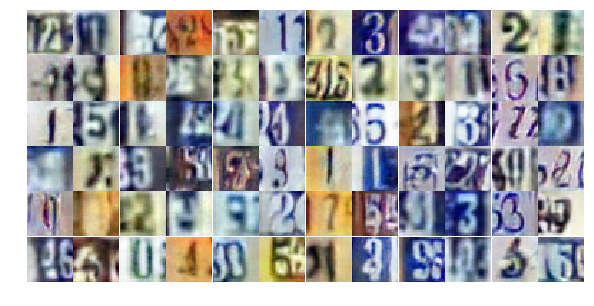

Epoch 25/25... Discriminator Loss: 0.7762... Generator Loss: 0.8783
Epoch 25/25... Discriminator Loss: 0.6095... Generator Loss: 1.3775
Epoch 25/25... Discriminator Loss: 1.3923... Generator Loss: 0.5026
Epoch 25/25... Discriminator Loss: 0.5017... Generator Loss: 1.5126
Epoch 25/25... Discriminator Loss: 0.6673... Generator Loss: 1.1928
Epoch 25/25... Discriminator Loss: 0.4311... Generator Loss: 1.4536
Epoch 25/25... Discriminator Loss: 0.6787... Generator Loss: 1.1612
Epoch 25/25... Discriminator Loss: 1.0179... Generator Loss: 0.6343
Epoch 25/25... Discriminator Loss: 0.8436... Generator Loss: 0.8560
Epoch 25/25... Discriminator Loss: 0.4989... Generator Loss: 1.4525


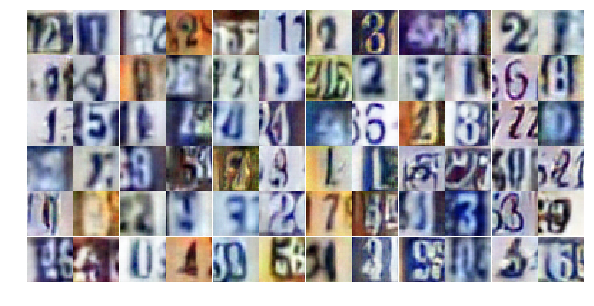

Epoch 25/25... Discriminator Loss: 0.8265... Generator Loss: 0.7843
Epoch 25/25... Discriminator Loss: 0.7073... Generator Loss: 0.9036
Epoch 25/25... Discriminator Loss: 0.5807... Generator Loss: 1.2206
Epoch 25/25... Discriminator Loss: 0.9490... Generator Loss: 0.6754
Epoch 25/25... Discriminator Loss: 1.5757... Generator Loss: 0.3688
Epoch 25/25... Discriminator Loss: 0.6194... Generator Loss: 1.2065
Epoch 25/25... Discriminator Loss: 0.3824... Generator Loss: 1.6446
Epoch 25/25... Discriminator Loss: 0.9049... Generator Loss: 0.8814
Epoch 25/25... Discriminator Loss: 1.1995... Generator Loss: 0.6240
Epoch 25/25... Discriminator Loss: 0.4532... Generator Loss: 1.3503


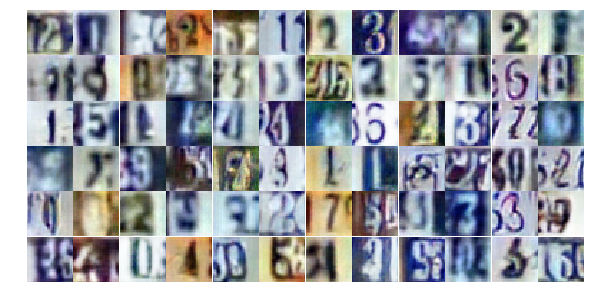

Epoch 25/25... Discriminator Loss: 0.9884... Generator Loss: 0.7067
Epoch 25/25... Discriminator Loss: 0.6883... Generator Loss: 1.1918
Epoch 25/25... Discriminator Loss: 0.9979... Generator Loss: 0.6798
Epoch 25/25... Discriminator Loss: 0.7799... Generator Loss: 0.8986
Epoch 25/25... Discriminator Loss: 0.5626... Generator Loss: 1.1815
Epoch 25/25... Discriminator Loss: 0.4853... Generator Loss: 2.4282
Epoch 25/25... Discriminator Loss: 1.2736... Generator Loss: 0.4790
Epoch 25/25... Discriminator Loss: 6.5989... Generator Loss: 0.0086
Epoch 25/25... Discriminator Loss: 2.0567... Generator Loss: 1.9359
Epoch 25/25... Discriminator Loss: 1.7063... Generator Loss: 1.1348


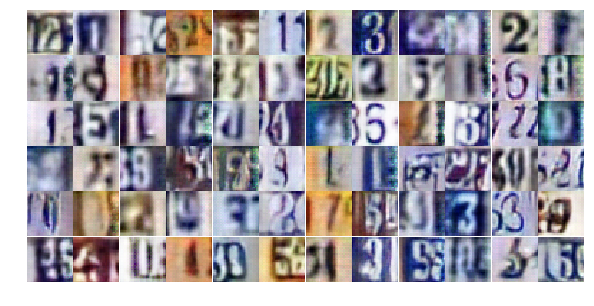

Epoch 25/25... Discriminator Loss: 1.9829... Generator Loss: 1.7057
Epoch 25/25... Discriminator Loss: 2.1230... Generator Loss: 0.2248


In [36]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

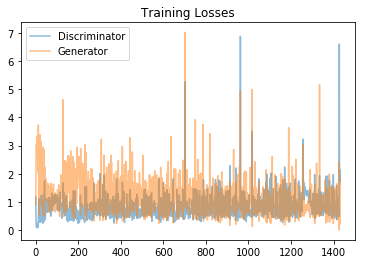

In [37]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

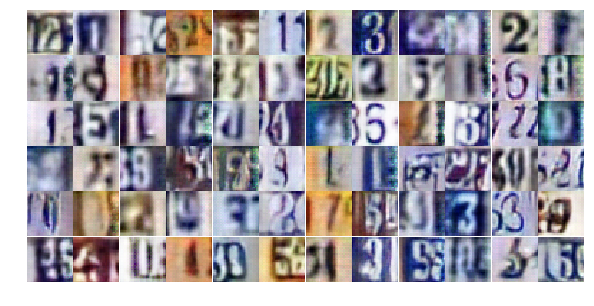

In [38]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))